# 0. Preemble

Amazing International Airlines Inc. (AIAI) faces the challenge of designing personalized services and marketing strategies for a diverse customer base. In today’s highly competitive airline industry, leveraging data-driven approaches to understand customer segments is crucial for improving satisfaction, increasing retention, and maximizing revenue potential.

In this project, we act as consultants for AIAI and analyze loyalty membership data and flight activity collected over a three-year period to develop a data-driven segmentation strategy.

This notebook (Deliverable 1: Exploratory Data Analysis) lays the groundwork for segmentation. It follows four parts that structure the analysis:
- Descriptive statistics and visualizations: highlight distributions, trends, and anomalies; identify variables most relevant for segmentation.
- Data quality assessment: detect missing/inconsistent values and biases, and discuss their impact on clustering reliability.
- Preliminary behavioral signals: surface patterns that suggest distinct customer types (e.g., premium focus, price sensitivity, seasonal travel, route preferences).
- Engineered features: design and justify derived variables that capture richer behavior and explain their expected contribution to clustering models.

#### 1. Customer DB Metadata -> Will be referenced as 'a'

| Variable | Description |
| --- | --- |
| Loyalty# | Unique customer identifier for loyalty program members |
| First Name | Customer's first name |
| Last Name | Customer's last name |
| Customer Name | Customer's full name (concatenated) |
| Country | Customer's country of residence |
| Province or State | Customer's province or state |
| City | Customer's city of residence |
| Latitude | Geographic latitude coordinate of customer location |
| Longitude | Geographic longitude coordinate of customer location |
| Postal code | Customer's postal/ZIP code |
| Gender | Customer's gender |
| Education | Customer's highest education level (e.g., Bachelor, College) |
| Location Code | Urban/Suburban/Rural classification of customer residence |
| Income | Customer's annual income |
| Marital Status | Customer's marital status (Married, Single, Divorced) |
| LoyaltyStatus | Current tier status in loyalty program (Star > Nova > Aurora) |
| EnrollmentDateOpening | Date when customer joined the loyalty program |
| CancellationDate | Date when customer left the program |
| Customer Lifetime Value | Total calculated monetary value of customer relationship |
| EnrollmentType | Method of joining loyalty program |

#### 2. Flight Activity Metadata will be referenced as 'b'

| Variable | Description |
| --- | --- |
| Loyalty# | Unique customer identifier linking to CustomerDB |
| Year | Year of flight activity record |
| Month | Month of flight activity record (1-12) |
| YearMonthDate | First day of the month for the activity period |
| NumFlights | Total number of flights taken by customer in the month |
| NumFlightsWithCompanions | Number of flights where customer traveled with companions |
| DistanceKM | Total distance traveled in kilometers for the month |
| PointsAccumulated | Loyalty points earned by customer during the month |
| PointsRedeemed | Loyalty points spent/redeemed during the month |
| DollarCostPointsRedeemed | Dollar value of points redeemed during the month |

# 1. Import Libraries and Load Data

Import Libraries.

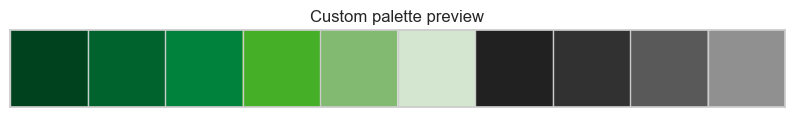

<Figure size 640x480 with 0 Axes>

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns 

from scipy.stats import stats


from math import ceil
import matplotlib as mpl
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.scale import FuncScale
from matplotlib.ticker import MaxNLocator
import matplotlib.dates as mdates

import missingno as msno


from itertools import combinations

# Capture warnings
import warnings

# Suppress all UserWarnings from seaborn
warnings.filterwarnings('ignore', category=UserWarning, module='seaborn')
warnings.simplefilter("ignore", FutureWarning)
warnings.simplefilter("ignore", DeprecationWarning)


# Setting seaborn style
sns.set_style("white")

# Custom Seaborn palette and colormap

CUSTOM_HEX = [
    "#00411E", "#00622D", "#00823C", "#45AF28", "#82BA72", "#D5E6D0",
    "#212121", "#313131", "#595959", "#909090",
]

# Apply globally (Seaborn + Matplotlib)
sns.set_theme(style="whitegrid")
sns.set_palette(CUSTOM_HEX)  # default for categorical plots
mpl.rcParams["axes.prop_cycle"] = mpl.cycler(color=CUSTOM_HEX)  # Matplotlib default cycle

# Continuous colormap (for numeric hues, heatmaps, etc.)
CUSTOM_CMAP = LinearSegmentedColormap.from_list("green_gray_gradient", CUSTOM_HEX)

# Preview palette
sns.palplot(sns.color_palette(CUSTOM_HEX))
plt.title("Custom palette preview")
plt.show()
plt.clf()

Load Datasets

In [2]:
CustomerDB = pd.read_csv('data/DM_AIAI_CustomerDB.csv')
FlightsDB = pd.read_csv('data/DM_AIAI_FlightsDB.csv')

In [3]:
df_Customer = CustomerDB.copy()
df_Flights = FlightsDB.copy()

# 2. Descriptive Statistics and Profiling

## 2.1a Data Overview

Inspect the first rows of the df_Customers dataset.

In [4]:
df_Customer.head()

,Unnamed: 0,Loyalty#,First Name,Last Name,Customer Name,Country,Province or State,City,Latitude,Longitude,...,Gender,Education,Location Code,Income,Marital Status,LoyaltyStatus,EnrollmentDateOpening,CancellationDate,Customer Lifetime Value,EnrollmentType
0,0,480934,Cecilia,Householder,Cecilia Householder,Canada,Ontario,Toronto,43.653225,-79.383186,...,female,Bachelor,Urban,70146.0,Married,Star,2/15/2019,NaN,3839.14,Standard
1,1,549612,Dayle,Menez,Dayle Menez,Canada,Alberta,Edmonton,53.544388,-113.490930,...,male,College,Rural,0.0,Divorced,Star,3/9/2019,NaN,3839.61,Standard
2,2,429460,Necole,Hannon,Necole Hannon,Canada,British Columbia,Vancouver,49.282730,-123.120740,...,male,College,Urban,0.0,Single,Star,7/14/2017,1/8/2021,3839.75,Standard
3,3,608370,Queen,Hagee,Queen Hagee,Canada,Ontario,Toronto,43.653225,-79.383186,...,male,College,Suburban,0.0,Single,Star,2/17/2016,NaN,3839.75,Standard
4,4,530508,Claire,Latting,Claire Latting,Canada,Quebec,Hull,45.428730,-75.713364,...,male,Bachelor,Suburban,97832.0,Married,Star,10/25/2017,NaN,3842.79,2021 Promotion


Display the column names and datatypes of the df_Customers dataset.

In [5]:
df_Customer.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16921 entries, 0 to 16920
Data columns (total 21 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Unnamed: 0               16921 non-null  int64  
 1   Loyalty#                 16921 non-null  int64  
 2   First Name               16921 non-null  object 
 3   Last Name                16921 non-null  object 
 4   Customer Name            16921 non-null  object 
 5   Country                  16921 non-null  object 
 6   Province or State        16921 non-null  object 
 7   City                     16921 non-null  object 
 8   Latitude                 16921 non-null  float64
 9   Longitude                16921 non-null  float64
 10  Postal code              16921 non-null  object 
 11  Gender                   16921 non-null  object 
 12  Education                16921 non-null  object 
 13  Location Code            16921 non-null  object 
 14  Income                

**Main Takeaways**
- The dataset has 16921 rows and 21 columns.
- There are 13 categorical columns, 5 numerical columns, 2 date columns, and 1 identifier column.
- The Loyalty# column appears to be the unique identifier for each customer. Investigate further to confirm.
- The designated index column has no missing values and is of integer datatype.
- The column cancellationDate has missing values. 
- Some columns need to change their datatype (formate date as date etc.)
---

Minimal preprocessing to adjust the column datatypes.

In [6]:
# Convert EnrollmentDateOpening and CancellationDate into a datetime object
df_Customer['EnrollmentDateOpening'] = pd.to_datetime(
    df_Customer['EnrollmentDateOpening'],
    format='%m/%d/%Y',
    errors='coerce'
)
df_Customer['CancellationDate'] = pd.to_datetime(
    df_Customer['CancellationDate'],
    format='%m/%d/%Y',
    errors='coerce'
)

# Convert suitable object columns into pandas Categorical dtype
categorical_cols = [
    'Loyalty#',
    'Country',
    'Province or State',
    'City',
    'Postal code',
    'Gender',
    'Education',
    'Location Code',
    'Marital Status',
    'LoyaltyStatus',
    'EnrollmentType',
]

df_Customer[categorical_cols] = df_Customer[categorical_cols].apply(lambda s: s.astype('category'))

## 2.1b Data Overview

Inspect the first rows of the df_flights dataset.

In [7]:
df_Flights.head()

,Loyalty#,Year,Month,YearMonthDate,NumFlights,NumFlightsWithCompanions,DistanceKM,PointsAccumulated,PointsRedeemed,DollarCostPointsRedeemed
0,413052,2021,12,12/1/2021,2.0,2.0,9384.0,938.0,0.0,0.0
1,464105,2021,12,12/1/2021,0.0,0.0,0.0,0.0,0.0,0.0
2,681785,2021,12,12/1/2021,10.0,3.0,14745.0,1474.0,0.0,0.0
3,185013,2021,12,12/1/2021,16.0,4.0,26311.0,2631.0,3213.0,32.0
4,216596,2021,12,12/1/2021,9.0,0.0,19275.0,1927.0,0.0,0.0


Display the column names and datatypes of the df_flights dataset.

In [8]:
df_Flights.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 608436 entries, 0 to 608435
Data columns (total 10 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   Loyalty#                  608436 non-null  int64  
 1   Year                      608436 non-null  int64  
 2   Month                     608436 non-null  int64  
 3   YearMonthDate             608436 non-null  object 
 4   NumFlights                608436 non-null  float64
 5   NumFlightsWithCompanions  608436 non-null  float64
 6   DistanceKM                608436 non-null  float64
 7   PointsAccumulated         608436 non-null  float64
 8   PointsRedeemed            608436 non-null  float64
 9   DollarCostPointsRedeemed  608436 non-null  float64
dtypes: float64(6), int64(3), object(1)
memory usage: 46.4+ MB


**Main Takeaways**
- The dataset has 608436 rows and 10 columns.
- There are 6 numerical columns, 3 date columns, and 1 identifier column.
- There seem to be no missing values in the dataset.
- The date column YearMonthDate is of object datatype probably needs to be reformatted.

---

Minimal preprocessing to adjust the column datatypes.

In [9]:
df_Flights["YearMonthDate"] = (
    pd.to_datetime(df_Flights["YearMonthDate"], format="%m/%d/%Y", errors="coerce")
      .dt.to_period("M")
      .astype(str)
)

# Convert 'Loyalty#' to category
df_Flights['Loyalty#'] = df_Flights['Loyalty#'].astype('category')

## 2.2a Descriptive Statistics

In [10]:
df_Customer.describe(include='all').T

,count,unique,top,freq,mean,min,25%,50%,75%,max,std
Unnamed: 0,16921.0,NaN,NaN,NaN,8440.023639,0.0,4210.0,8440.0,12670.0,16900.0,4884.775439
Loyalty#,16921.0,16757.0,678205.0,3.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
First Name,16921,4941,Stacey,13,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Last Name,16921,15404,Ypina,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Customer Name,16921,16921,Cecilia Householder,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Country,16921,1,Canada,16921,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Province or State,16921,11,Ontario,5468,NaN,NaN,NaN,NaN,NaN,NaN,NaN
City,16921,29,Toronto,3390,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Latitude,16921.0,NaN,NaN,NaN,47.1745,42.984924,44.231171,46.087818,49.28273,60.721188,3.307971
Longitude,16921.0,NaN,NaN,NaN,-91.814768,-135.05684,-120.23766,-79.383186,-74.596184,-52.712578,22.242429


**Main Takeaways**
- There are less unique values than number of rows in the Loyalty# column, meaning there are duplicate entries. Investigate further.
- The dataset contains only Canada values in the Country column, and includes 29 cities.
- The income columns has a range from 0-100000, which looks reasonable.
- There seem to be no unreasonable numerical values in the numerical columns.
---

## 2.2b Descriptive Statistics

In [11]:
df_Flights.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Loyalty#,608436.0,16737.0,678205.0,108.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Year,608436.0,NaN,NaN,NaN,2020.0,0.816497,2019.0,2019.0,2020.0,2021.0,2021.0
Month,608436.0,NaN,NaN,NaN,6.5,3.452055,1.0,3.75,6.5,9.25,12.0
YearMonthDate,608436,36,2021-12,16901,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NumFlights,608436.0,NaN,NaN,NaN,3.908107,5.057889,0.0,0.0,0.0,7.2,21.0
NumFlightsWithCompanions,608436.0,NaN,NaN,NaN,0.983944,2.003785,0.0,0.0,0.0,0.9,11.0
DistanceKM,608436.0,NaN,NaN,NaN,7939.341419,10260.421873,0.0,0.0,856.4,15338.175,42040.0
PointsAccumulated,608436.0,NaN,NaN,NaN,793.777781,1025.918521,0.0,0.0,85.275,1533.7125,4204.0
PointsRedeemed,608436.0,NaN,NaN,NaN,235.251678,983.233374,0.0,0.0,0.0,0.0,7496.0
DollarCostPointsRedeemed,608436.0,NaN,NaN,NaN,2.324835,9.725168,0.0,0.0,0.0,0.0,74.0


**Main Takeaways**
- The Loyalty# has less unique values than number of rows. Indicating there are multiple rows for each customer. The unique number nearly matches the unique number in df_Customers. 
- The minimum year and maximum year in Year column is 2019 and 2021 respectively. Indicating that flight data exists only for these years.
- The number flights metrics all have no <0 values, and have reasonable maximum values. 
- Only exception is the Distance KM metrix of 42.000, since that is longer than any posbbile flight. Investigate if devisable by the number of flights.
---

## 2.3a Investigate Categorical Variables

### 2.3.1a Get a brief Overview of Categorical Variables

Define categorical columns for df_Customer.

In [12]:
cust_cat_cols = ['First Name', 'Last Name', 'Customer Name', 'Country', 'Province or State', 'City', 'Postal code', 'Gender', 'Education', 'Location Code', 
                 'Marital Status', 'LoyaltyStatus', 'EnrollmentType']


Look at the value count for categorical variables.

In [13]:
df_Customer[cust_cat_cols].nunique()

First Name            4941
Last Name            15404
Customer Name        16921
Country                  1
Province or State       11
City                    29
Postal code             75
Gender                   2
Education                5
Location Code            3
Marital Status           3
LoyaltyStatus            3
EnrollmentType           2
dtype: int64

**Main Takeaway**
- There are too many unique values in the Name column, we will not analyze them further, as they are not useful for analysis.
- As seen in descriptive statistics, the Country column has only one value (Canada), so it will not be analyzed further.
---

In [14]:
cust_cat_cols.remove('First Name')
cust_cat_cols.remove('Last Name')
cust_cat_cols.remove('Customer Name')
cust_cat_cols.remove('Country')
print(cust_cat_cols)

['Province or State', 'City', 'Postal code', 'Gender', 'Education', 'Location Code', 'Marital Status', 'LoyaltyStatus', 'EnrollmentType']


### 2.3.2a Investigate Categorical Variables with distribution plots

Define function to plot categorical variables.

In [15]:
def plot_categorical_distribution(df, column, top_n=None):
    """
    Plot category counts as a horizontal bar chart.

    Parameters
    ----------
    df : pandas.DataFrame
        Source data.
    column : str
        Categorical column to summarise.
    top_n : int, optional
        Keep only the N most frequent categories.
    """
    series = df[column].dropna().astype(str)
    counts = series.value_counts()
    total = counts.sum()

    # Sort by frequency (descending)
    counts = counts.sort_values(ascending=False)
    
    # Keep only top N if specified
    if top_n is not None:
        counts = counts.iloc[:top_n]

    sns.set_style("white")
    color = CUSTOM_HEX[1]

    fig, ax = plt.subplots(figsize=(8, 4))
    sns.barplot(x=counts.values, y=counts.index, color=color, edgecolor="0.3", ax=ax)
    ax.set_title(f"{column} Distribution")
    ax.set_xlabel("Count")
    ax.set_ylabel(column)
    ax.grid(False)
    
    # Always annotate with percentages
    if len(counts) > 0:
        offset = counts.values.max() * 0.02
        ax.set_xlim(0, counts.values.max() * 1.1)
        for val, idx in zip(counts.values, range(len(counts))):
            percentage = (val / total) * 100
            ax.text(val + offset, idx, f"{percentage:.1f}%", va="center", ha="left", fontsize=9)

    sns.despine(ax=ax, left=True)
    plt.tight_layout()
    plt.show()

Feature: Province or State

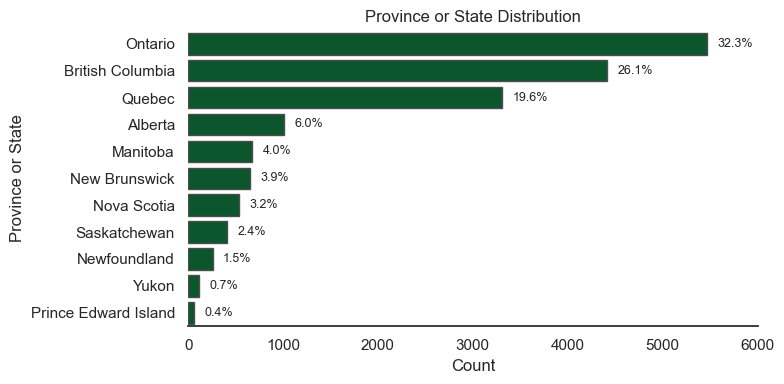

In [16]:
plot_categorical_distribution(df_Customer, 'Province or State')

Feature: City

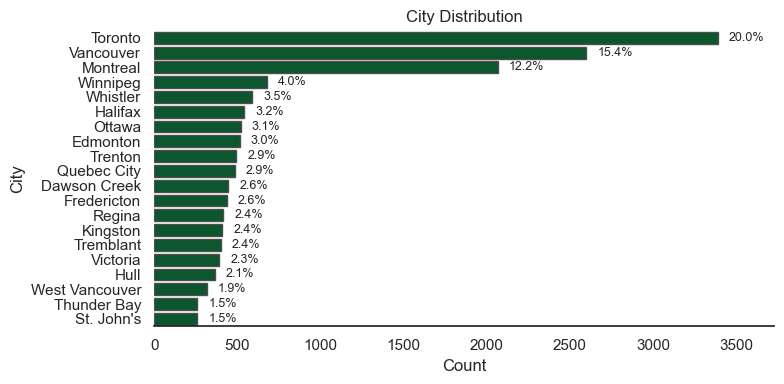

In [17]:
plot_categorical_distribution(df_Customer, 'City', top_n=20)

Feature: Postal Code

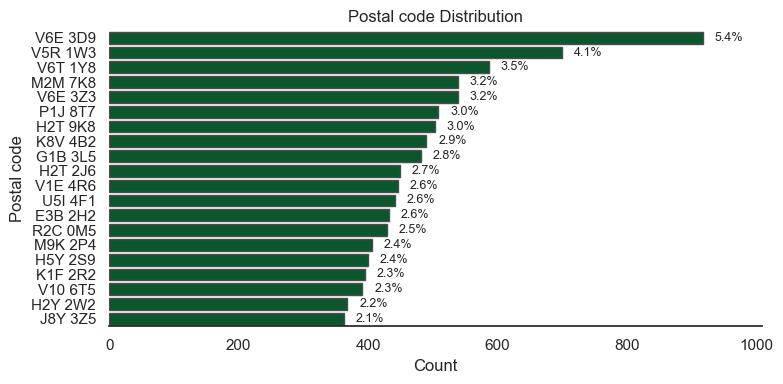

In [18]:
plot_categorical_distribution(df_Customer, "Postal code", top_n=20)

Feature: Gender

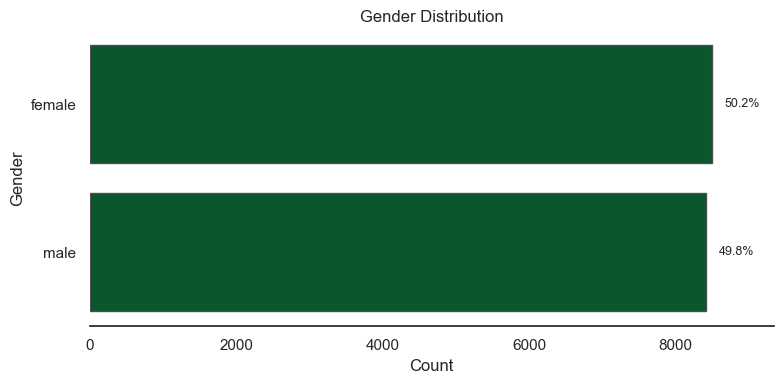

In [19]:
plot_categorical_distribution(df_Customer, 'Gender')

Feature: Education

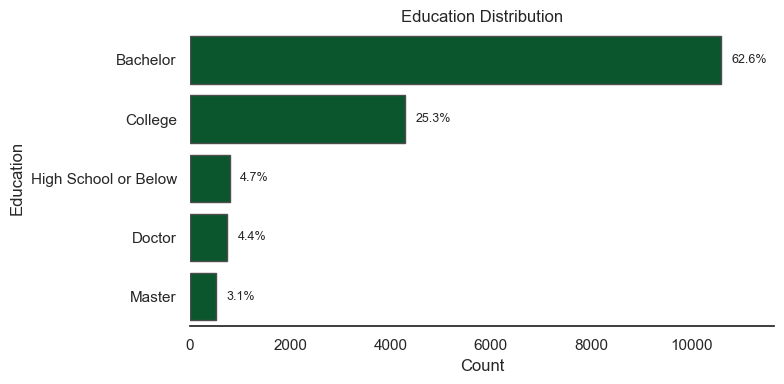

In [20]:
plot_categorical_distribution(df_Customer, 'Education')

Feature: Location Code

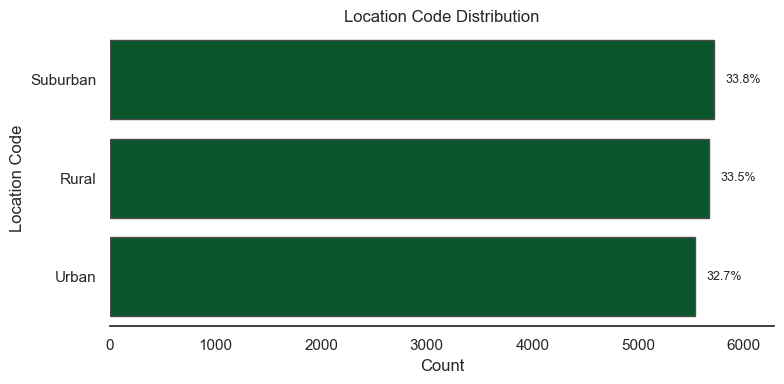

In [21]:
plot_categorical_distribution(df_Customer, 'Location Code')

Feature: Marital Status

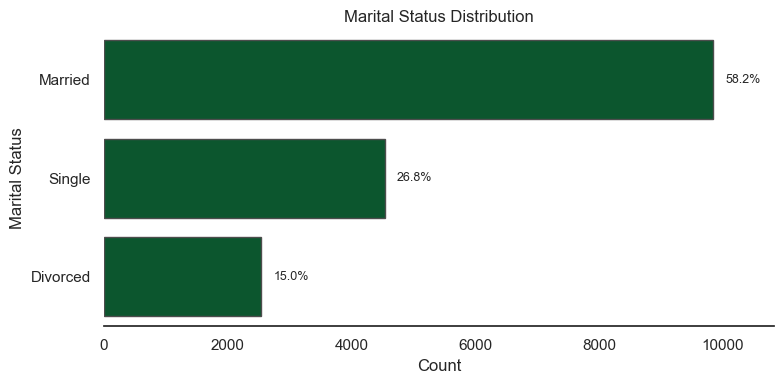

In [22]:
plot_categorical_distribution(df_Customer, 'Marital Status')

Feature: Loyalty Status

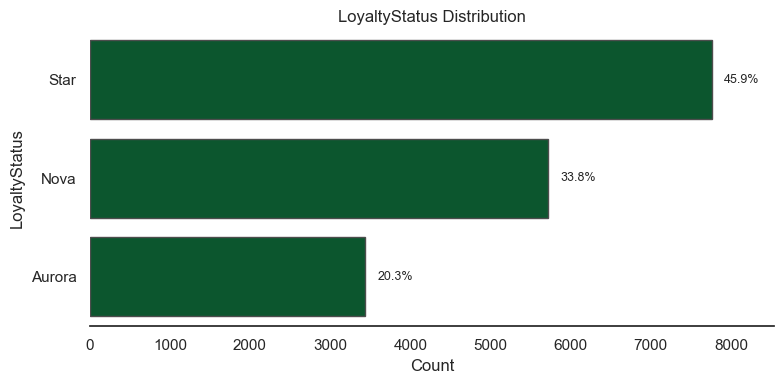

In [23]:
plot_categorical_distribution(df_Customer, "LoyaltyStatus")

Feature: Enrollment Type

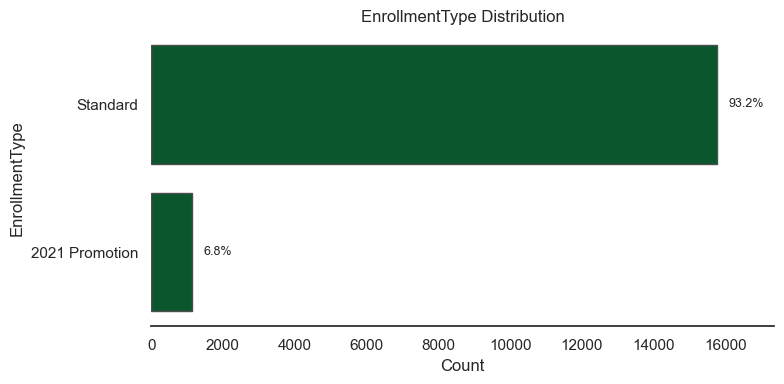

In [24]:
plot_categorical_distribution(df_Customer, 'EnrollmentType')

**Main Takeaways**
- Province or State: The majority of customers (~50%) are from Ontario, Quebec, and British Columbia.
- City: The top cities with the most customers (~50%) are Toronto, Vancouver, and Montreal.
- Postal Code: Does not make sense to display.
- Gender: The gender distribution has an evenly split between Male and Female.
- Education: The majority of customers have a Bachelor's degree (~63%), followed by College diploma (~25%). Then the number of entries falls off for High School, Doctor, and Master's degree.
- Location Code: Nearly evenly split between Suburban (~34%), Rural (~34%), and Urban (~33%).
- Marital Status: The majority of customers are Married (~58%), followed by Single (~27%), and Divorced (~15%).
- Loyalty Status: The majority of customers have a Star (~46%) status, followed by Nova (~34%) and then Aurora (~20%).
- Enrollment Type: The majority of customers did a standard enrollment (~93%). The only other option is the 2021 promotion.
---

## 2.3b Investigate Categorical Variables

Although the variables Year and Month are stored as numbers, they encode time buckets rather than continuous magnitudes. Because their interpretation is categorical (each value represents a discrete period), we analyse and visualise them alongside the other categorical features.

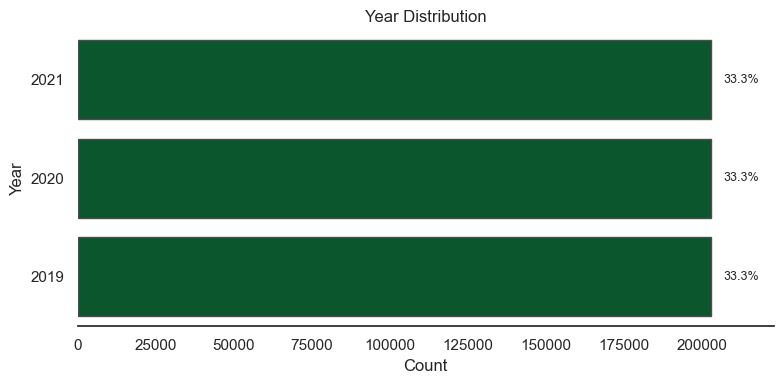

In [25]:
plot_categorical_distribution(df_Flights, 'Year')

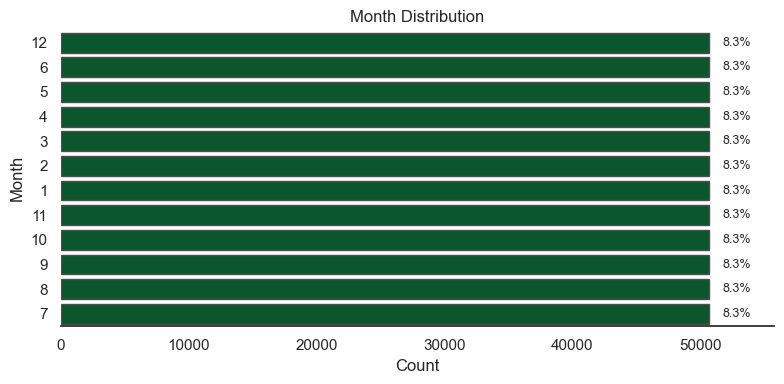

In [26]:
plot_categorical_distribution(df_Flights, 'Month')

**Main Takeaways**
- Year: The flight activity data is evenly distributed across the three years 2019, 2020, and 2021.
- Month: The number of data points is evenly distributed across the months.
---

## 2.4a Investigate Numerical / Date Variables

Define function to display date distribution.

In [27]:
def plot_date_distribution(df, date_column, vert_line_start=None, vert_line_end=None):
    """Plot count of records per date as a time series with part of the line highlighted in red.
    
    Parameters
    ----------
    df : pandas.DataFrame
        DataFrame containing the date column to analyze.
    date_column : str
        Column name containing date values in 'M/D/YYYY' format.
    vert_line_start : str or None, optional
        Start date for the red-highlighted period.
    vert_line_end : str or None, optional
        End date for the red-highlighted period.
    """

    # Convert and clean dates
    dates = pd.to_datetime(df[date_column].dropna(), format='%m/%d/%Y', errors='coerce')
    dates = dates.dropna()
    counts = dates.value_counts().sort_index()
    smoothed = counts.rolling(window=30, center=True, min_periods=1).mean()

    fig, ax = plt.subplots(figsize=(12, 5))

    # Define start/end bounds for the red section
    start = pd.to_datetime(vert_line_start) if vert_line_start else None
    end = pd.to_datetime(vert_line_end) if vert_line_end else None

    # Plot the full green line first
    ax.plot(smoothed.index, smoothed.values, color=CUSTOM_HEX[1], linewidth=2, label='30-day average')

    # Overlay red section if both dates are provided
    if start is not None and end is not None:
        mask = (smoothed.index >= start) & (smoothed.index <= end)
        ax.plot(smoothed.index[mask], smoothed.values[mask], color='red', linewidth=2, label='2021 Promotion')

    # Add raw daily count in gray (optional background line)
    ax.plot(counts.index, counts.values, color='gray', alpha=0.3, linewidth=1, label='Daily counts')

    # Formatting
    ax.set_title(f"{date_column} Distribution Over Time")
    ax.set_xlabel("Date")
    ax.set_ylabel("Count")
    ax.legend()
    ax.grid(True, alpha=0.3)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


Define function to display histograms and boxplots for numerical variables.

In [28]:
def plot_numeric_distribution(
    df,
    column,
    color=None,
    show_kde=True,
    y_scale="linear",  # "linear", "sqrt" oder "log"
    bins=None,         # int, sequence oder str (z.B. "auto")
    integer_ticks=False,
    show_boxplot=True,
):
    """
    Render a histogram (and optional horizontal boxplot) for a numeric column.

    Parameters
    ----------
    df : pandas.DataFrame
        Source data holding the column to visualise.
    column : str
        Column name to plot; must resolve to numeric values.
    color : str, optional
        Fill colour applied to both plots; defaults to the second custom colour.
    show_kde : bool, optional
        Overlay a kernel density estimate on the histogram when True.
    y_scale : {'linear', 'sqrt', 'log'}, optional
        Scaling applied to histogram counts before rendering.
    bins : int | Sequence | str | None, optional
        Bin specification forwarded to `seaborn.histplot`.
    integer_ticks : bool, optional
        Forces integer tick locations on the x-axis when the data are numeric.
    show_boxplot : bool, optional
        Draw the accompanying horizontal boxplot when True.
    """
    series = df[column].dropna()
    sns.set_style("white")
    if color is None:
        color = CUSTOM_HEX[1]

    ncols = 2 if show_boxplot else 1
    fig, axes = plt.subplots(1, ncols, figsize=(16, 4) if show_boxplot else (8, 4))
    if show_boxplot:
        hist_ax, box_ax = axes
    else:
        hist_ax = axes

    hist_kwargs = dict(
        x=series,
        ax=hist_ax,
        kde=show_kde,
        color=color,
        edgecolor=color,
        linewidth=1,
        stat="count",
    )
    if bins is not None:
        hist_kwargs["bins"] = bins

    sns.histplot(**hist_kwargs)

    if integer_ticks:
        hist_ax.xaxis.set_major_locator(MaxNLocator(integer=True))
        if show_boxplot:
            box_ax.xaxis.set_major_locator(MaxNLocator(integer=True))

    if y_scale == "log":
        hist_ax.set_yscale("log")
        y_label = "Count (log scale)"
    elif y_scale == "sqrt":
        hist_ax.set_yscale(FuncScale(hist_ax, functions=(np.sqrt, lambda y: y**2)))
        y_label = "Count (sqrt scale)"
    else:
        y_label = "Count"

    hist_ax.set_title(f"{column} Distribution")
    hist_ax.set_xlabel(column)
    hist_ax.set_ylabel(y_label)
    hist_ax.grid(False)

    if show_boxplot:
        sns.boxplot(
            x=series,
            ax=box_ax,
            color=color,
            saturation=1,
            linewidth=1,
            flierprops=dict(marker="o", markersize=4, markerfacecolor="white", markeredgecolor="black"),
            boxprops=dict(alpha=0.9),
            whiskerprops=dict(color="0.3", linewidth=1),
            capprops=dict(color="0.3", linewidth=1),
            medianprops=dict(color="0.2", linewidth=1.5),
        )
        box_ax.set_title(f"{column} Boxplot")
        box_ax.set_xlabel(column)
        box_ax.set_yticks([])
        box_ax.grid(False)
        box_ax.spines["left"].set_visible(False)
        sns.despine(ax=box_ax, left=True)

    sns.despine(ax=hist_ax)
    plt.tight_layout()
    plt.show()


Feature: Unnamed: 0

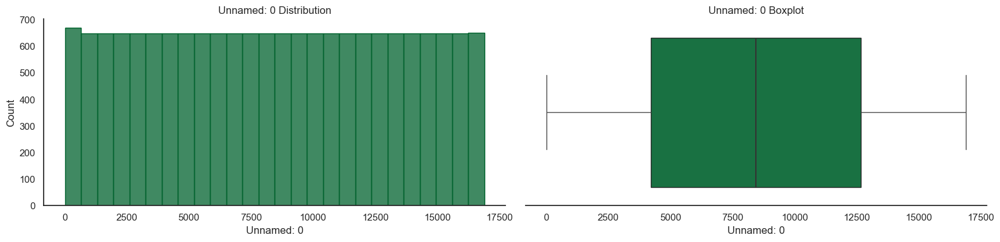

In [29]:
plot_numeric_distribution(df_Customer, 'Unnamed: 0', show_kde=False, show_boxplot=True)

Feature: Latitude

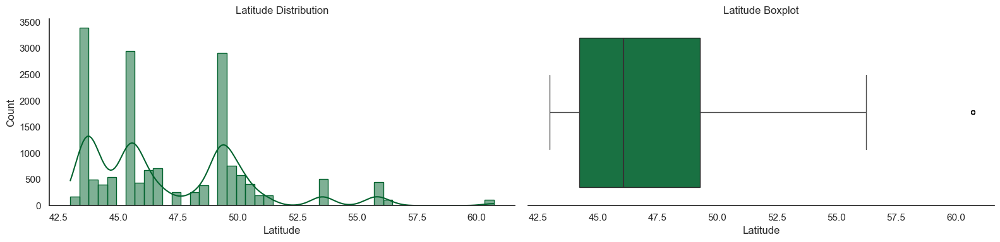

In [30]:
plot_numeric_distribution(df_Customer, 'Latitude', show_kde=True)

Feature: Longitude

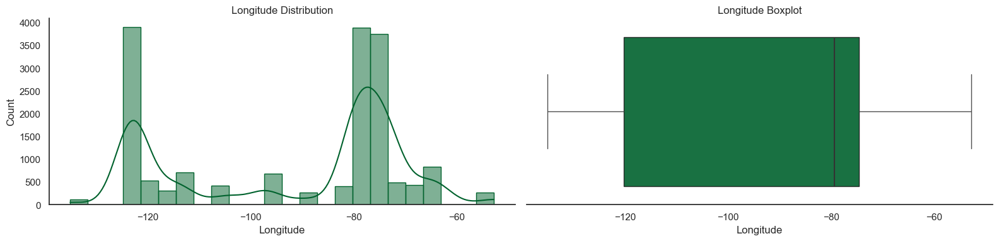

In [31]:
plot_numeric_distribution(df_Customer, 'Longitude', show_kde=True)

Feature: Income

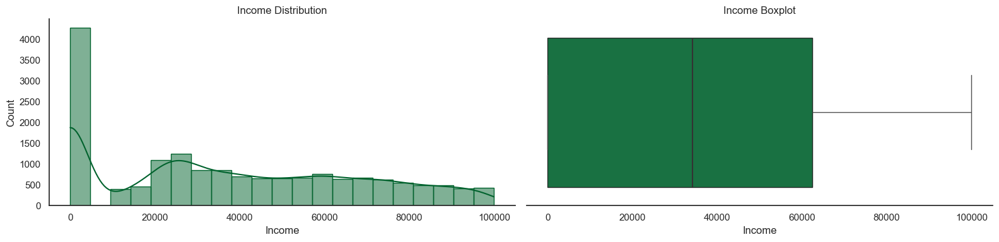

In [32]:
plot_numeric_distribution(df_Customer, 'Income', show_kde=True)

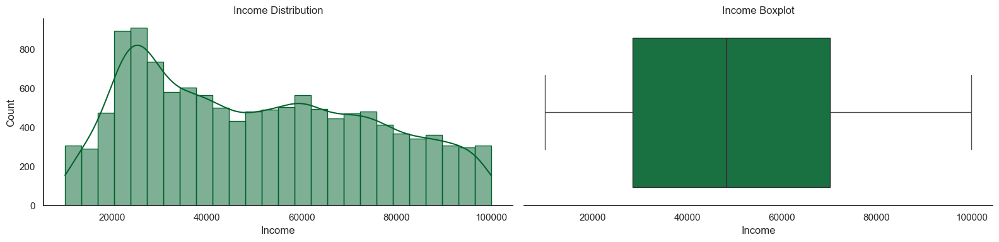

In [33]:
# Plot income without zero values
plot_numeric_distribution(df_Customer[df_Customer['Income'] > 0], 'Income', show_kde=True)

Feature: EnrollmentDateOpening

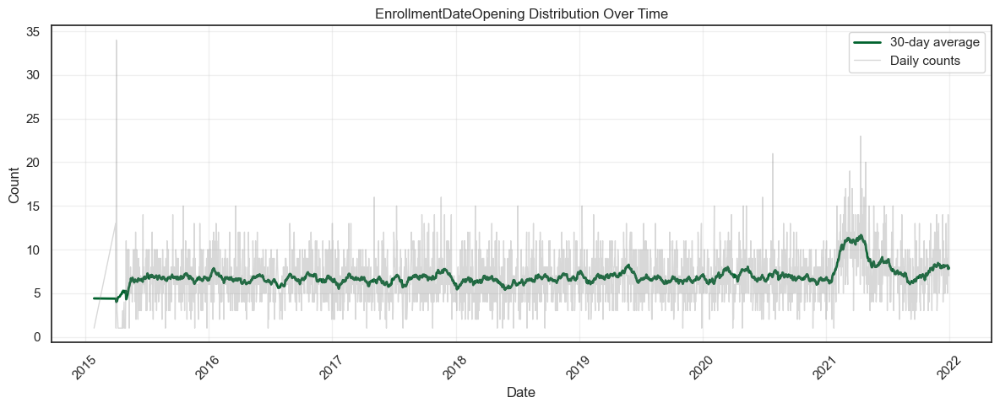

In [34]:
plot_date_distribution(df_Customer, 'EnrollmentDateOpening')

Peak is interesting. Investigate if that correlates with the 2021 promotion campaign.

In [35]:
df_Customer['EnrollmentType'].value_counts()

EnrollmentType
Standard          15773
2021 Promotion     1148
Name: count, dtype: int64

Set start and end date of the promotion campaign.

In [36]:
df_Customer['enrollment_filter'] = df_Customer.apply(
    lambda x: 'Valid Promotion' if x['EnrollmentType'] == '2021 Promotion' and x['EnrollmentDateOpening'].year == 2021 else 'Other', axis=1
    )

In [37]:
prom_start = df_Customer[df_Customer['enrollment_filter'] == 'Valid Promotion']['EnrollmentDateOpening'].min()
prom_end = df_Customer[df_Customer['enrollment_filter'] == 'Valid Promotion']['EnrollmentDateOpening'].max()

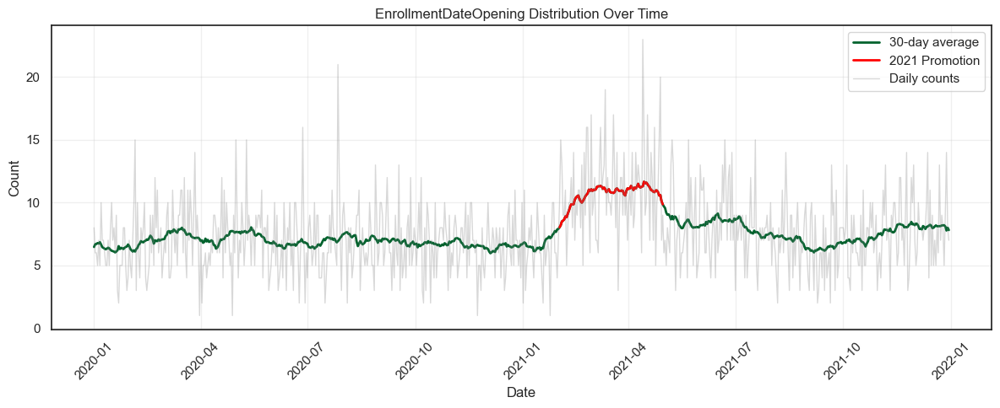

In [38]:
plot_date_distribution(df_Customer[pd.to_datetime(df_Customer['EnrollmentDateOpening'], errors='coerce') > '2019-12-31'], 
                       'EnrollmentDateOpening', vert_line_start=prom_start, vert_line_end=prom_end)

Yes, it seems that the promotion campaign led to a significant increase in enrollments during that period.

Feature: CancellationDate

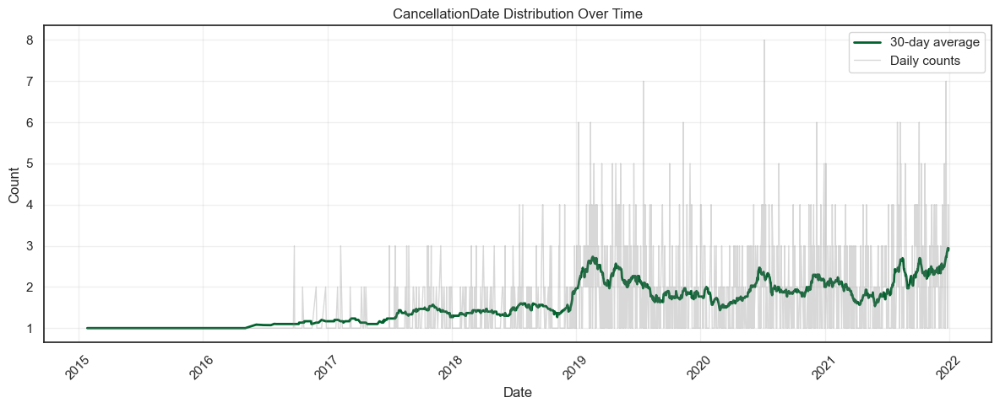

In [39]:
plot_date_distribution(df_Customer, 'CancellationDate')

Feature: Customer_Lifetime_Value

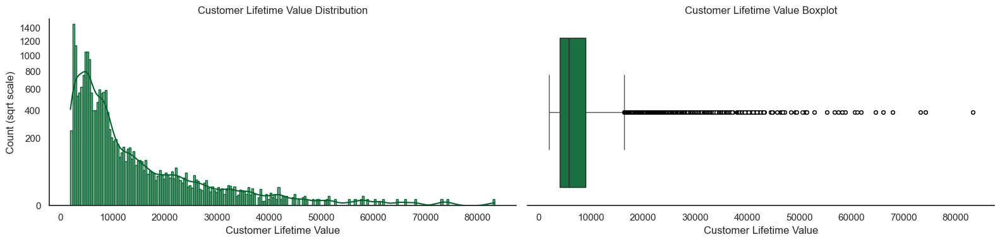

In [40]:
plot_numeric_distribution(df_Customer, 'Customer Lifetime Value', y_scale="sqrt", show_kde=True)

**Main Takeaways**
- "Unnamed: 0": The distribution looks uniform. Small peak at the start could indicate duplicates.
- Latitude: Has 3 peaks, likely indicating 3 major cities.
- Longitude: Has 3 peaks, likely indicating 3 major cities. (Test correlation with Latitude)
- Income: Income is dominated by 0 values, with a long tail of higher incomes. Investigate without the 0 values. Income without 0 values looks slighty right skewed with peaks at 25,000.
- EnrollmentDateOpening: There seems to be an increase in enrollment counts at the start of 2021. Those might be related to the 2021 promotion enrollment type.
- CancellationDate: The number of cancellations appears to increase over time with spikes at the beginning of 2019, mid 2020, and is rising since mid 2021.
- Customer Lifetime Value: The distribution is highly right skewed. Most customers have a low lifetime value, with a few customers having a very high lifetime value.
---

## 2.4b Investigate Numerical / Date Variables

Investigate the number of 0 values in the numerical columns. They are present for a reason but may skew the distribution plots.

In [41]:
# Create df with all numerical columns and count the 0 entries and calculate the percentage of 0 entries in each column.
numerical_cols = df_Flights.select_dtypes(include=[np.number]).columns.tolist()
df_Flights_numerical = df_Flights[numerical_cols]
zero_counts = (df_Flights_numerical == 0).sum()
zero_percentage = (zero_counts / df_Flights_numerical.shape[0]) * 100
zero_percentage

Year                         0.000000
Month                        0.000000
NumFlights                  50.050293
NumFlightsWithCompanions    73.696823
DistanceKM                  49.080429
PointsAccumulated           49.080429
PointsRedeemed              94.182954
DollarCostPointsRedeemed    94.182954
dtype: float64

Feature: YearMonthDate

In [42]:
df_Flights["YearMonthDate"].value_counts().sort_index()

YearMonthDate
2019-01    16901
2019-02    16901
2019-03    16901
2019-04    16901
2019-05    16901
2019-06    16901
2019-07    16901
2019-08    16901
2019-09    16901
2019-10    16901
2019-11    16901
2019-12    16901
2020-01    16901
2020-02    16901
2020-03    16901
2020-04    16901
2020-05    16901
2020-06    16901
2020-07    16901
2020-08    16901
2020-09    16901
2020-10    16901
2020-11    16901
2020-12    16901
2021-01    16901
2021-02    16901
2021-03    16901
2021-04    16901
2021-05    16901
2021-06    16901
2021-07    16901
2021-08    16901
2021-09    16901
2021-10    16901
2021-11    16901
2021-12    16901
Name: count, dtype: int64

Feature: NumFlights

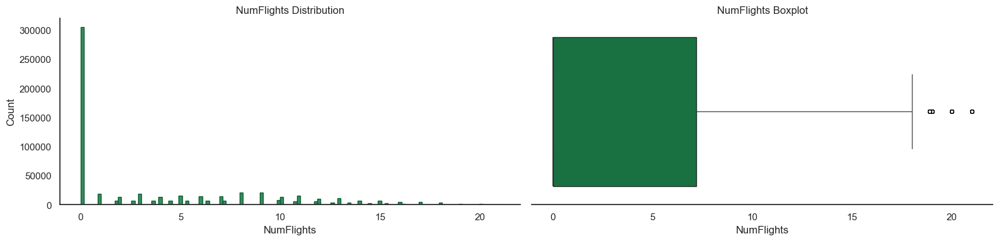

In [43]:
plot_numeric_distribution(df_Flights, 'NumFlights', show_kde=False)

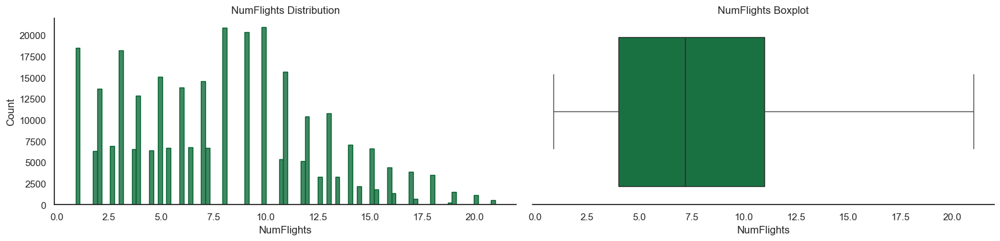

In [44]:
plot_numeric_distribution(df_Flights[df_Flights['NumFlights'] > 0], 'NumFlights', show_kde=False)

Feature: NumFlightsWithCompanions

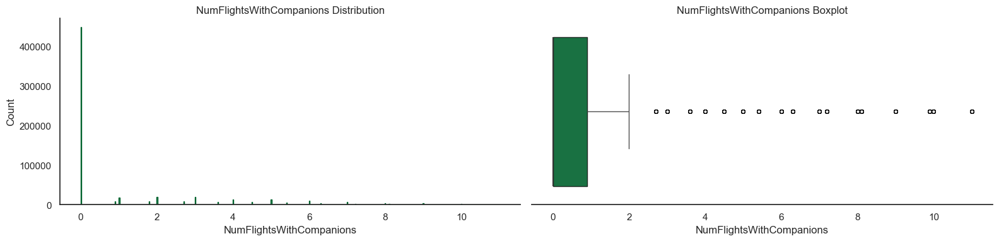

In [45]:
plot_numeric_distribution(df_Flights, 'NumFlightsWithCompanions', show_kde=False)

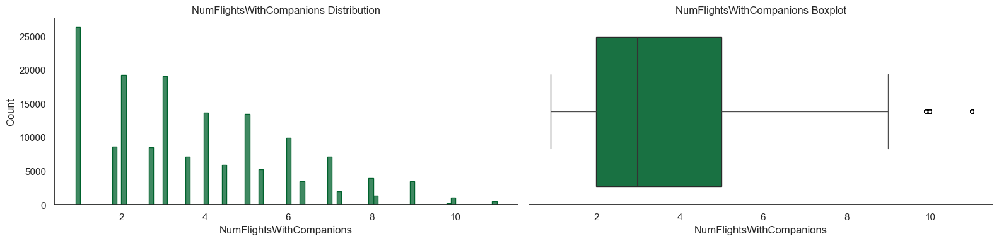

In [46]:
plot_numeric_distribution(df_Flights[df_Flights['NumFlightsWithCompanions'] > 0], 'NumFlightsWithCompanions', show_kde=False)

Feature: DistanceKM

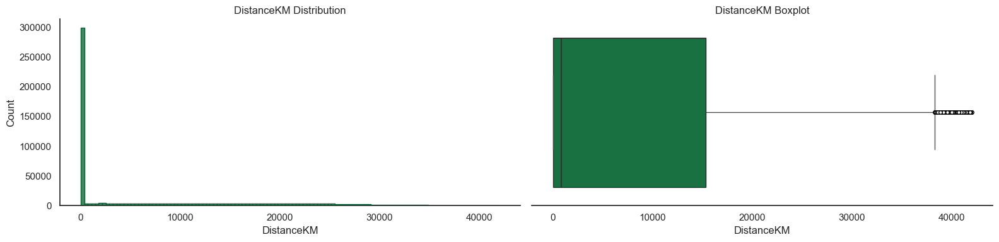

In [47]:
plot_numeric_distribution(df_Flights, 'DistanceKM', show_kde=False)

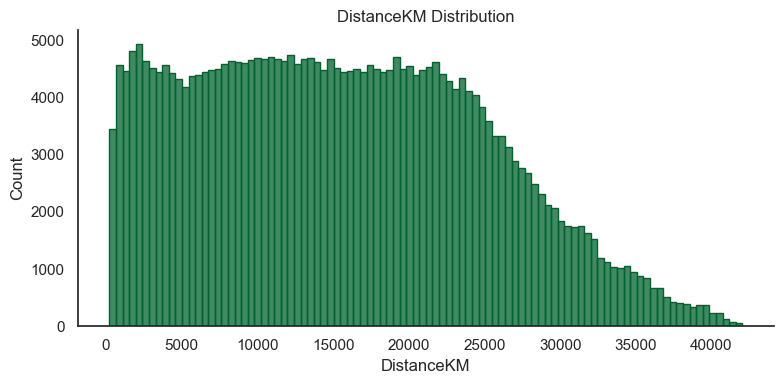

In [48]:
plot_numeric_distribution(df_Flights[df_Flights['DistanceKM'] > 0], 'DistanceKM', integer_ticks=True, show_boxplot=False, show_kde=False)

Feature: PointsAccumulated

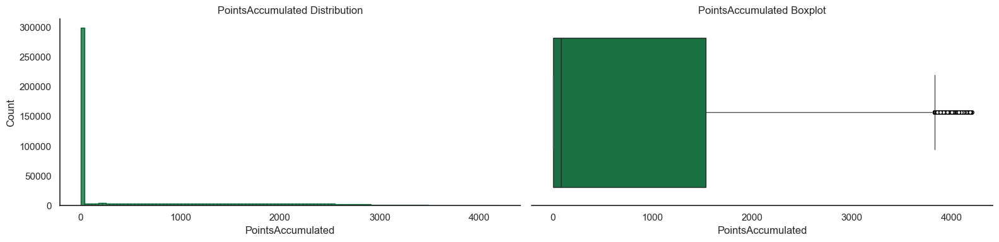

In [49]:
plot_numeric_distribution(df_Flights, 'PointsAccumulated', show_kde=False)

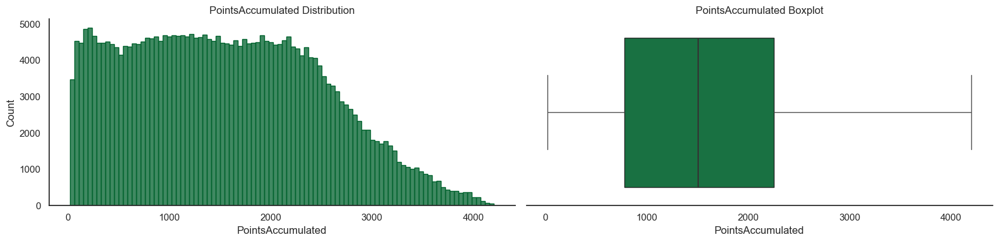

In [50]:
plot_numeric_distribution(df_Flights[df_Flights['PointsAccumulated'] > 0], 'PointsAccumulated', show_kde=False)

Feature: PointsRedeemed

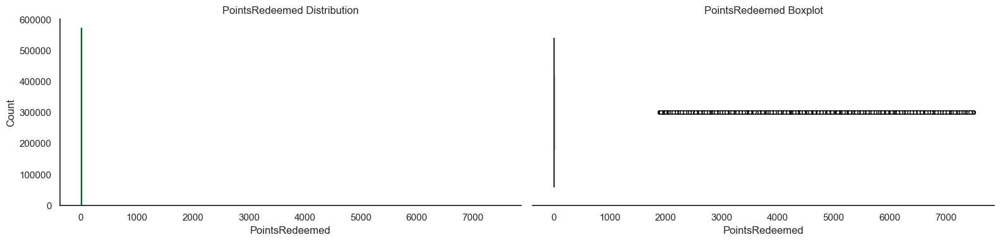

In [51]:
plot_numeric_distribution(df_Flights, 'PointsRedeemed', show_kde=False)

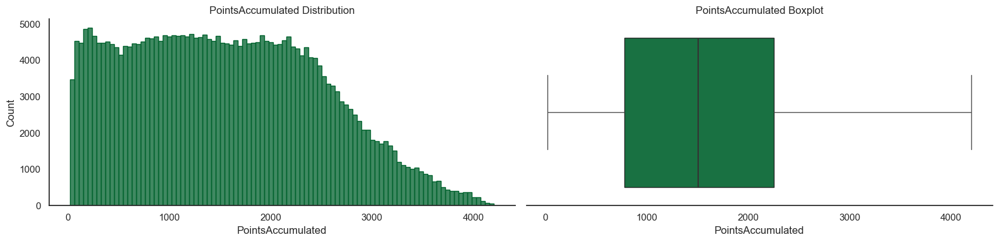

In [52]:
plot_numeric_distribution(df_Flights[df_Flights['PointsAccumulated'] > 0], 'PointsAccumulated', show_kde=False)

Feature: DollarCostPointsRedeemed

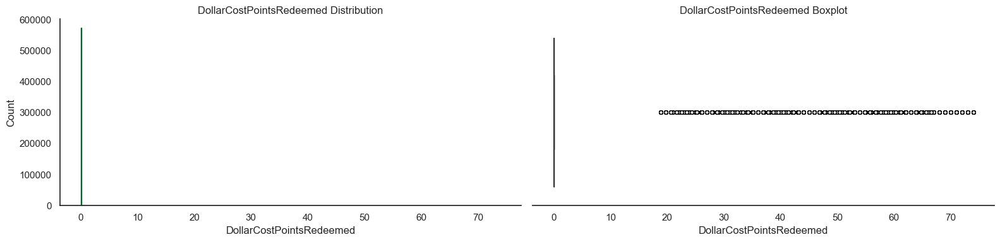

In [53]:
plot_numeric_distribution(df_Flights, 'DollarCostPointsRedeemed', show_kde=False)

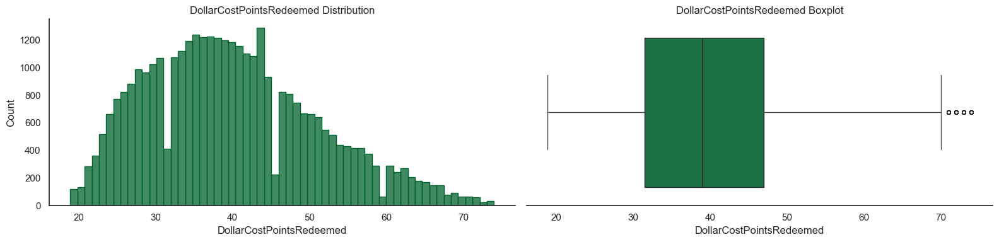

In [54]:
plot_numeric_distribution(df_Flights[df_Flights['DollarCostPointsRedeemed'] > 0], 'DollarCostPointsRedeemed', show_kde=False)

**Main Takeaways**
- The plots are displayed with 0 and excluding 0 values. The 0 values heavily dominate the distributions for most features. If we exclude the values, we see the following:
- YearMonthDate: The number of flights per date appears to be relatively stable over time, with some fluctuations. There is a noticeable dip in flights around early 2020, likely due to the COVID-19 pandemic.
- NumFlights: The distribution of the number of flights is right-skewed, with most customers having a low number of flights and a few customers having a very high number of flights.
- NumFlightsWithCompanions: Distribution is right-skewed, with customers being more likely to have a lower number of flights with companions.
- DistanceKM, PointsAccumulated, PointsRedeemed: The distributions of these 3 features look similar. Up to a certain point, they appear to have the same number of entries, but then they fall of in similar patterns.
- DollarCostPointsRedeemed: The distribution of the dollar cost of points redeemed is right-skewed, with most customers redeeming points with a low dollar cost and a few customers redeeming points with a high dollar cost.
- In number of flights, and number of flights with companions, there seem to be non-integer values (represented as bars between integer ticks). Investigate further.
---

# 3. Data Quality Assessment

## **3.1 Missingness**

### **3.1.1 df_Customer**

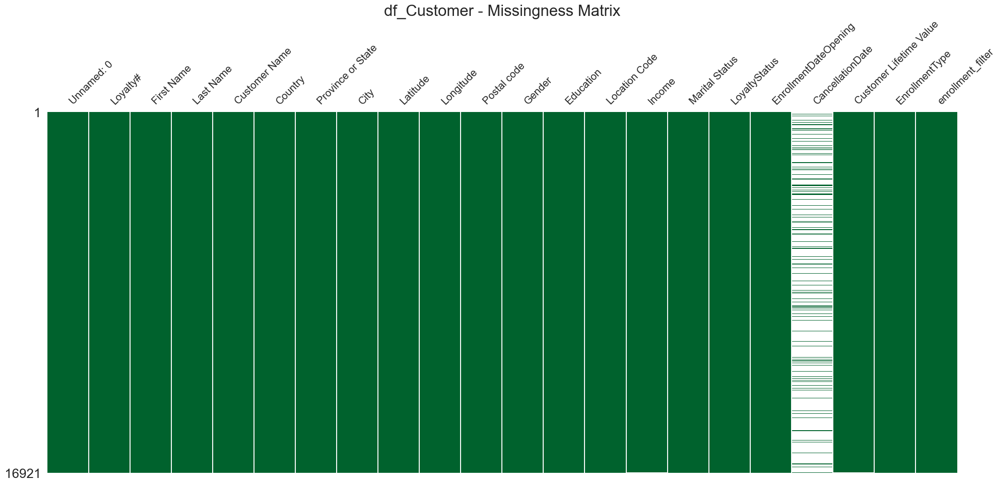

In [55]:
msno.matrix(
    df_Customer,
    color=sns.color_palette(CUSTOM_HEX)[1],
    sparkline=False,
)
plt.title("df_Customer - Missingness Matrix", pad=2, fontsize=24)
plt.show()

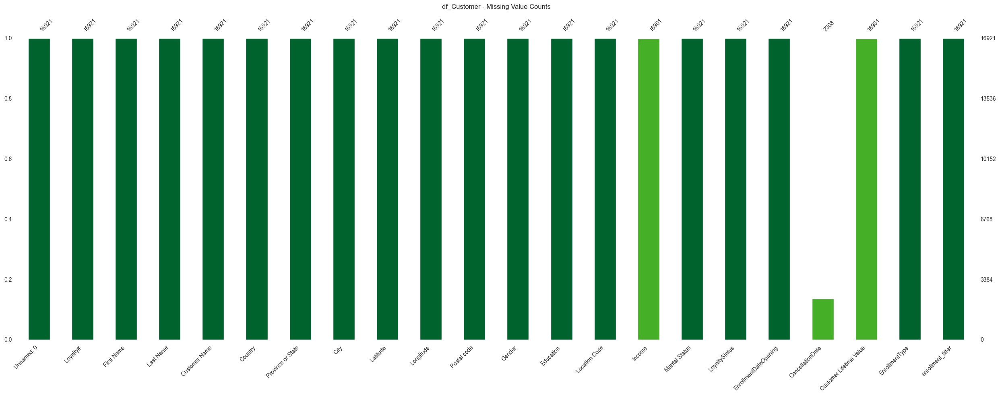

In [56]:
palette = sns.color_palette(CUSTOM_HEX)
ax = msno.bar(df_Customer, color=palette[1], fontsize=10)
ax.set_title("df_Customer - Missing Value Counts", pad=16)

for label, bar in zip(ax.get_xticklabels(), ax.patches):
    if df_Customer[label.get_text()].isna().any():
        bar.set_facecolor(palette[3])

plt.tight_layout()
plt.show()

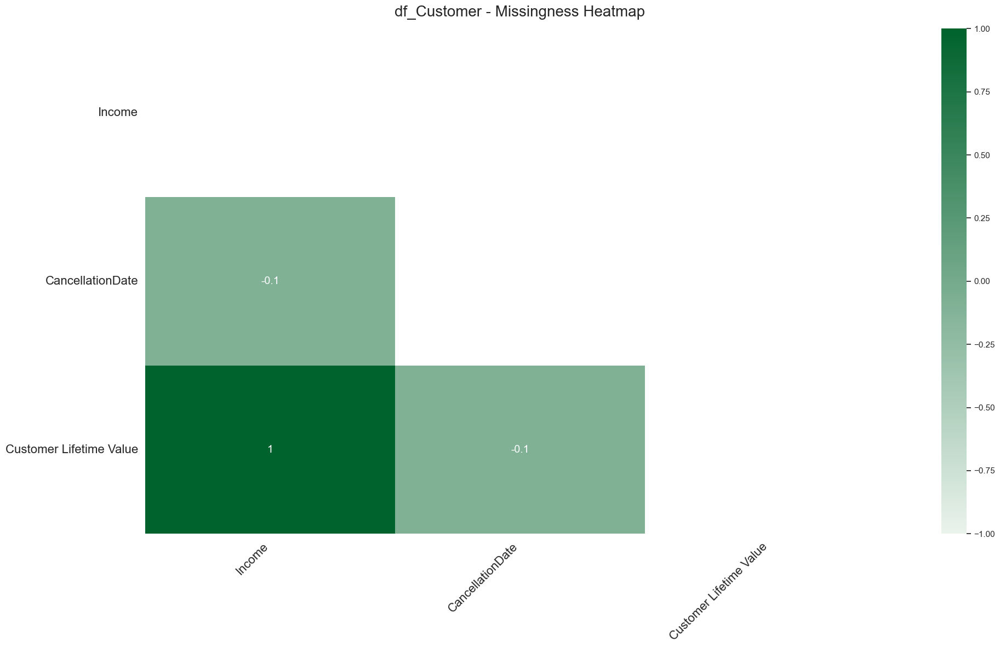

In [57]:
palette = sns.color_palette(CUSTOM_HEX)
msno.heatmap(df_Customer, cmap=sns.light_palette(palette[1], as_cmap=True))
plt.title("df_Customer - Missingness Heatmap", pad=16, fontsize=20)
plt.tight_layout()
plt.show()

**Main Takeaways**
- There are only missing vlaues in income, cancellationDate, and Customer_Lifetime_Value columns.
- Income and Customer Lifetime Value have a correlation from 1. Indicating that when income is missing, Customer_Lifetime_Value is also missing.
---

### **3.1.1 df_Flights**

In [58]:
df_Flights.isna().sum()

Loyalty#                    0
Year                        0
Month                       0
YearMonthDate               0
NumFlights                  0
NumFlightsWithCompanions    0
DistanceKM                  0
PointsAccumulated           0
PointsRedeemed              0
DollarCostPointsRedeemed    0
dtype: int64

**Main Takeaways**
- There are no missing values in the df_Flights dataset.
---

## **3.2 Duplicates**

### **3.2.1 df_Customer**

Duplicates count for df_Customers

In [59]:
df_Customer.duplicated().sum()

np.int64(0)

Feature: Unnamed: 0

In [60]:
df_Customer[df_Customer["Unnamed: 0"].duplicated(keep=False)]

,Unnamed: 0,Loyalty#,First Name,Last Name,Customer Name,Country,Province or State,City,Latitude,Longitude,...,Education,Location Code,Income,Marital Status,LoyaltyStatus,EnrollmentDateOpening,CancellationDate,Customer Lifetime Value,EnrollmentType,enrollment_filter
0,0,480934,Cecilia,Householder,Cecilia Householder,Canada,Ontario,Toronto,43.653225,-79.383186,...,Bachelor,Urban,70146.0,Married,Star,2019-02-15,NaT,3839.14,Standard,Other
1,1,549612,Dayle,Menez,Dayle Menez,Canada,Alberta,Edmonton,53.544388,-113.490930,...,College,Rural,0.0,Divorced,Star,2019-03-09,NaT,3839.61,Standard,Other
2,2,429460,Necole,Hannon,Necole Hannon,Canada,British Columbia,Vancouver,49.282730,-123.120740,...,College,Urban,0.0,Single,Star,2017-07-14,2021-01-08,3839.75,Standard,Other
3,3,608370,Queen,Hagee,Queen Hagee,Canada,Ontario,Toronto,43.653225,-79.383186,...,College,Suburban,0.0,Single,Star,2016-02-17,NaT,3839.75,Standard,Other
4,4,530508,Claire,Latting,Claire Latting,Canada,Quebec,Hull,45.428730,-75.713364,...,Bachelor,Suburban,97832.0,Married,Star,2017-10-25,NaT,3842.79,2021 Promotion,Other
5,5,193662,Leatrice,Hanlin,Leatrice Hanlin,Canada,Yukon,Whitehorse,60.721188,-135.056840,...,Bachelor,Rural,26262.0,Married,Star,2015-05-07,NaT,3844.57,Standard,Other
6,6,927943,Hue,Sellner,Hue Sellner,Canada,Ontario,Toronto,43.653225,-79.383186,...,College,Urban,0.0,Single,Star,2017-06-09,NaT,3857.95,Standard,Other
7,7,188893,Nakia,Cash,Nakia Cash,Canada,Ontario,Trenton,44.101128,-77.576309,...,Bachelor,Suburban,93272.0,Married,Star,2019-12-08,NaT,3861.49,Standard,Other
8,8,852392,Arlene,Conterras,Arlene Conterras,Canada,Quebec,Montreal,45.501690,-73.567253,...,Bachelor,Suburban,93272.0,Married,Star,2018-05-30,NaT,3861.49,Standard,Other
9,9,866307,Dustin,Recine,Dustin Recine,Canada,Ontario,Toronto,43.653225,-79.383186,...,Bachelor,Suburban,93272.0,Married,Star,2019-10-14,NaT,3861.49,Standard,Other


Feature: Loyalty#

In [61]:
# Even though the summary stats already showed that Loyalty# isn’t unique (it should behave like an ID), let’s see where duplicates occur
df_Customer[df_Customer.duplicated(subset="Loyalty#", keep=False)].sort_values("Loyalty#")

,Unnamed: 0,Loyalty#,First Name,Last Name,Customer Name,Country,Province or State,City,Latitude,Longitude,...,Education,Location Code,Income,Marital Status,LoyaltyStatus,EnrollmentDateOpening,CancellationDate,Customer Lifetime Value,EnrollmentType,enrollment_filter
1646,1646,101902,Hans,Schlottmann,Hans Schlottmann,Canada,Ontario,London,42.984924,-81.245277,...,College,Rural,0.0,Married,Aurora,2020-01-07,NaT,6265.34,Standard,Other
2668,2668,101902,Yi,Nesti,Yi Nesti,Canada,Ontario,Toronto,43.653225,-79.383186,...,Bachelor,Urban,79090.0,Married,Aurora,2020-03-19,NaT,8609.16,Standard,Other
15988,15988,106001,Maudie,Hyland,Maudie Hyland,Canada,New Brunswick,Fredericton,45.963589,-66.643112,...,Master,Suburban,14973.0,Divorced,Star,2015-07-16,NaT,12168.74,Standard,Other
700,700,106001,Ivette,Peifer,Ivette Peifer,Canada,Quebec,Montreal,45.501690,-73.567253,...,High School or Below,Suburban,10037.0,Single,Star,2016-01-11,NaT,4914.04,Standard,Other
13053,13053,106509,Stacy,Schwebke,Stacy Schwebke,Canada,Ontario,Toronto,43.653225,-79.383186,...,College,Suburban,0.0,Single,Star,2021-06-12,NaT,4661.98,Standard,Other
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5038,5038,989528,Sharri,Boughman,Sharri Boughman,Canada,Quebec,Montreal,45.501690,-73.567253,...,College,Rural,0.0,Divorced,Nova,2020-05-01,NaT,3370.07,Standard,Other
9890,9890,990512,Magda,Sopher,Magda Sopher,Canada,Ontario,Toronto,43.653225,-79.383186,...,College,Suburban,0.0,Single,Star,2018-10-21,NaT,1904.00,Standard,Other
14478,14478,990512,Ione,Snowden,Ione Snowden,Canada,British Columbia,Vancouver,49.282730,-123.120740,...,College,Urban,0.0,Single,Star,2021-08-20,NaT,6870.61,Standard,Other
6981,6981,992168,Frederick,Samaha,Frederick Samaha,Canada,Ontario,Toronto,43.653225,-79.383186,...,High School or Below,Suburban,22906.0,Married,Nova,2015-09-26,NaT,5746.33,Standard,Other


**Main Takeaways**
- As the Loyalty# should be the unique identifier to each customer, and is also the connector to the df_Flights Database, it doesn't make sense to keep those rows, as we are not able to identify the single customer and his flights -> Delete row.
- Key Action: As behind those duplicate Values in 'Unnamed: 0' are diffferent Persons, we should keep the rows and just drop the Column 'Unnamed: 0' in the Preprocessing stage, beacause it doesnt provide value.
---

### **3.2.2 df_Flights**

Check for duplicate values in df_Flights.

In [62]:
df_Flights.duplicated().sum()

np.int64(2903)

In [63]:
df_Flights[df_Flights.duplicated(keep=False)].sort_values(list(df_Flights.columns))

,Loyalty#,Year,Month,YearMonthDate,NumFlights,NumFlightsWithCompanions,DistanceKM,PointsAccumulated,PointsRedeemed,DollarCostPointsRedeemed
405665,101902,2019,1,2019-01,0.0,0.0,0.0,0.0,0.0,0.0
405666,101902,2019,1,2019-01,0.0,0.0,0.0,0.0,0.0,0.0
422566,101902,2019,2,2019-02,0.0,0.0,0.0,0.0,0.0,0.0
422567,101902,2019,2,2019-02,0.0,0.0,0.0,0.0,0.0,0.0
439467,101902,2019,3,2019-03,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...
399029,992168,2020,6,2020-06,0.0,0.0,0.0,0.0,0.0,0.0
127223,992168,2021,6,2021-06,0.0,0.0,0.0,0.0,0.0,0.0
226139,992168,2021,6,2021-06,0.0,0.0,0.0,0.0,0.0,0.0
116895,992168,2021,9,2021-09,0.0,0.0,0.0,0.0,0.0,0.0


In [64]:
duplicates = df_Flights[df_Flights.duplicated(keep=False)]
duplicates['Loyalty#'].unique()

[727091, 369638, 750578, 547522, 819842, ..., 582493, 528447, 323821, 684123, 965605]
Length: 157
Categories (16737, int64): [100018, 100102, 100140, 100214, ..., 999911, 999940, 999982, 999986]

**Main Takeaways**
- The same as in df_Customer: As the Loyalty# should be the unique identifier to each customer, and is also the connector to the df_Customer Database, it doesn't make sense to keep those rows, as we are not able to identify the single customer and his flights -> Delete row.
---

## **3.3 Outlier/Anomaly**

### **3.3.1 df_Customer**

Zero-Income Customers with CLTV > 0 - Education Distribution

In [65]:
income_zero_customers = df_Customer[(df_Customer['Income'] == 0) & (df_Customer['Customer Lifetime Value'] != 0)]
income_zero_customers["Education"].value_counts()

Education
College                 4273
Bachelor                   0
Doctor                     0
High School or Below       0
Master                     0
Name: count, dtype: int64

### **3.3.2 df_Flights**

DistanceKM > 0 with NumFlights == 0

In [66]:
df_Flights[(df_Flights['DistanceKM'] != 0) & (df_Flights['NumFlights'] == 0)]

,Loyalty#,Year,Month,YearMonthDate,NumFlights,NumFlightsWithCompanions,DistanceKM,PointsAccumulated,PointsRedeemed,DollarCostPointsRedeemed
19,261109,2021,12,2021-12,0.0,0.0,13736.0,1373.00,0.0,0.0
93,817609,2021,12,2021-12,0.0,0.0,23775.0,2377.00,0.0,0.0
96,192600,2021,12,2021-12,0.0,0.0,5119.0,511.00,0.0,0.0
116,883242,2021,12,2021-12,0.0,0.0,20681.0,2068.00,0.0,0.0
154,493800,2021,12,2021-12,0.0,0.0,17502.0,1750.00,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...
607387,944702,2019,12,2019-12,0.0,0.0,29223.0,2922.30,0.0,0.0
607549,952629,2019,12,2019-12,0.0,0.0,27342.9,2734.29,0.0,0.0
607594,954973,2019,12,2019-12,0.0,0.0,6436.8,643.68,0.0,0.0
607744,962989,2019,12,2019-12,0.0,0.0,15922.8,1592.28,0.0,0.0



Avg flight length so DistanceKM is above 14000km

In [67]:
# Check for travel distance (Assumption: 14k km is longest flight)
max_flight_distance = 14000

max_possible_distance = max_flight_distance * df_Flights['NumFlights']
non_logical_distance = df_Flights[df_Flights['DistanceKM'] > max_possible_distance]
non_logical_distance

,Loyalty#,Year,Month,YearMonthDate,NumFlights,NumFlightsWithCompanions,DistanceKM,PointsAccumulated,PointsRedeemed,DollarCostPointsRedeemed
19,261109,2021,12,2021-12,0.0,0.0,13736.0,1373.00,0.0,0.0
41,377724,2021,12,2021-12,1.0,1.0,16998.0,1699.00,0.0,0.0
75,684835,2021,12,2021-12,1.0,1.0,22980.0,2298.00,4867.0,48.0
93,817609,2021,12,2021-12,0.0,0.0,23775.0,2377.00,0.0,0.0
96,192600,2021,12,2021-12,0.0,0.0,5119.0,511.00,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...
608166,984636,2019,12,2019-12,0.9,0.0,18302.4,1830.24,0.0,0.0
608303,992488,2019,12,2019-12,0.9,0.9,17276.4,1727.64,0.0,0.0
608323,993650,2019,12,2019-12,0.9,0.9,20648.7,2064.87,0.0,0.0
608346,995128,2019,12,2019-12,0.9,0.0,15497.1,1549.71,0.0,0.0


Float values

In [68]:
for col in df_Flights.select_dtypes("float").columns:
    print(col)
    print(df_Flights.loc[df_Flights[col] % 1 != 0, "Year"].value_counts(), "\n")

NumFlights
Year
2019    89551
Name: count, dtype: int64 

NumFlightsWithCompanions
Year
2019    50802
Name: count, dtype: int64 

DistanceKM
Year
2019    88278
Name: count, dtype: int64 

PointsAccumulated
Year
2019    97153
Name: count, dtype: int64 

PointsRedeemed
Year
2019    10075
Name: count, dtype: int64 

DollarCostPointsRedeemed
Year
2019    10134
Name: count, dtype: int64 



### **3.3.3 df_Flights & df_Customer combined**

Customer Lifetime Value > 0 but NumFlights == 0

In [69]:
zero_flight_customers = (
    df_Customer[['Loyalty#','Customer Name','Customer Lifetime Value','EnrollmentDateOpening','CancellationDate']]
    .merge(df_Flights.groupby('Loyalty#')['NumFlights'].sum().rename('total_flights'), on='Loyalty#', how='left')
    .fillna({'total_flights': 0})
    .loc[lambda df: (df['Customer Lifetime Value'] > 0) & (df['total_flights'] == 0)]
    .sort_values('Customer Lifetime Value', ascending=False)
)

display(zero_flight_customers)
print(f"{len(zero_flight_customers)} customers with CLTV > 0 but no flights")

,Loyalty#,Customer Name,Customer Lifetime Value,EnrollmentDateOpening,CancellationDate,total_flights
16900,652627,Ariane Peyton,83325.38,2018-12-03,2019-08-03,0.0
9884,844145,Tabitha Simonds,74228.52,2018-09-09,2019-04-07,0.0
4160,838263,Delaine Sitaca,67907.27,2015-07-25,NaT,0.0
16894,672917,Tam Whyte,58166.55,2018-01-25,2018-09-25,0.0
4148,529331,Shavonne Bakos,49221.43,2016-05-24,2018-12-18,0.0
...,...,...,...,...,...,...
9969,518210,Cleotilde Calemine,2154.07,2018-10-07,2019-06-07,0.0
9957,709212,Constance Longwith,2142.89,2016-08-20,2019-11-28,0.0
9953,347733,Cuc Arnaudet,2141.75,2018-05-08,2019-01-28,0.0
9941,440758,Avery Keesler,2124.17,2018-03-06,2018-11-06,0.0


1529 customers with CLTV > 0 but no flights


aThe enrollment-year counts (after converting EnrollmentDateOpening to year and tallying) will show whether these CLTV-positive, zero-flight customers mostly joined before 2019, supporting the idea that flights exist only outside the observed period.

In [70]:
enrollment_year_counts = (
    pd.to_datetime(zero_flight_customers['EnrollmentDateOpening'])
    .dt.year.value_counts()
    .sort_index()
)

print(enrollment_year_counts)

EnrollmentDateOpening
2015    219
2016    257
2017    275
2018    306
2019    123
2020     20
2021    329
Name: count, dtype: int64


**Main Takeaways**
- All zero-income customers with CLTV > 0 are “College”; this may reflect non-income funding (e.g., parents) or outliers-keep them, flag the cohort, and monitor their impact in later analysis
- Distance/km with zero flights: Months exist where DistanceKM > 0 and PointsAccumulated > 0 despite NumFlights == 0. During preprocessing flag these rows and set DistanceKM and PointsAccumulated to 0
- Physically impossible leg lengths: A few customers show DistanceKM beyond a realistic upper bound (~14 000 km per flight). Set those to NaN
- Fractional counts in flight metrics: The KPIs (NumFlights, NumFlightsWithCompanions, DistanceKM, PointsAccumulated, PointsRedeemed, DollarCostPointsRedeemed) contain decimal values in 2019. These likely stem from multi-year aggregation; unless clarified by the data provider, document the issue and see how these float values behave in the bivariate and multivariate analysis
- CLTV‑positive, zero‑flight customers span enrollments 2015-2021 (not only pre-2019), implying CLTV isn’t solely driven by recorded flights or flight data may be incomplete; plausible drivers include non‑flight revenue, activity outside the observed window, data lags, or outliers.
---

## **3.4 Minimal Preprocessing**

We addressed early data anomalies to facilitate sound bivariate and multivariate analysis

In [71]:
# Drop 'Country' and 'Unnamed: 0' from df_Customer
df_Customer = df_Customer.drop(columns=['Country', 'Unnamed: 0'])

# Drop Rows with duplicate 'Loyalty#' in df_Customer and also in df_Flights
duplicate_loyalty_numbers = df_Customer[df_Customer.duplicated(subset='Loyalty#', keep=False)]['Loyalty#'].unique()
df_Customer = df_Customer[~df_Customer['Loyalty#'].isin(duplicate_loyalty_numbers)]
df_Flights = df_Flights[~df_Flights['Loyalty#'].isin(duplicate_loyalty_numbers)]

# Set DistanceKM, PointsAccumulated and NumFlightsWithCompanions to 0 where NumFlights == 0
df_Flights.loc[df_Flights['NumFlights'] == 0, ['DistanceKM', 'PointsAccumulated', 'NumFlightsWithCompanions']] = 0

# Check for illogical flight distances (Assumption: 14k km is longest flight) and set to 0
max_flight_distance = 14000
avg_distance = df_Flights['DistanceKM'] / df_Flights['NumFlights'].replace(0, np.nan)
illogical_mask = avg_distance > max_flight_distance
df_Flights.loc[illogical_mask, ['NumFlights', 'NumFlightsWithCompanions', 'DistanceKM', 'PointsAccumulated']] = 0

# 4. Feature Engineering

## 4a. Customer DB

**Feature: Is Active (in last x months)** -> build recency feature

Reason: Find out per customer if they have been active in the last 6 and 12 months.

In [72]:
reference_date = pd.to_datetime('2022-01-01')
df_Flights['YearMonthDate'] = pd.to_datetime(df_Flights['YearMonthDate'].astype(str) + '-01')

In [73]:
recency_df = df_Flights[df_Flights['NumFlights'] > 0].groupby('Loyalty#')['YearMonthDate'].max().reset_index()
recency_df['DaysSinceLastFlight'] = (reference_date - recency_df['YearMonthDate']).dt.days

recency_df['is_active_6m'] = recency_df['DaysSinceLastFlight'] <= 180
recency_df['is_active_12m'] = recency_df['DaysSinceLastFlight'] <= 365

In [74]:
df_Customer = pd.merge(df_Customer, recency_df, on='Loyalty#', how='left')

**Feature: Rejoined**

Reason: Identify customers who have left the loyalty program and then enrolled again.

In [75]:
df_Customer['rejoined'] = (
    df_Customer['EnrollmentDateOpening'].notna() & 
    df_Customer['CancellationDate'].notna() &
    (df_Customer['CancellationDate'] < df_Customer['EnrollmentDateOpening'])
)

**Feature: Is current loyalty member**

Reason: Mark customers who are members of the loyalty program.

In [76]:
df_Customer['is_current_loyalty_member'] = (
    df_Customer['EnrollmentDateOpening'].notna() & 
    (df_Customer['CancellationDate'].isna() | df_Customer['rejoined'])
)

**Feature: Is previous loyalty member**

Reason: Mark customers who are not enrolled anymore.

In [77]:
df_Customer['is_previous_member'] = (
    df_Customer['EnrollmentDateOpening'].notna() & 
    df_Customer['CancellationDate'].notna() &
    (df_Customer['CancellationDate'] > df_Customer['EnrollmentDateOpening'])
)

**Feature: is_active_loyalty_member**

Reason: Summarize the features from above and group into active loyal, active not loyal, inactive loyal, inactive not loyal.

In [78]:
def activ_loyalty(row):
    active = bool(row['is_active_12m'])
    loyal = bool(row['is_current_loyalty_member'])
    if active and loyal:
        return 'active_loyal'
    if active and not loyal:
        return 'active_not_loyal'
    if not active and loyal:
        return 'inactive_loyal'
    return 'inactive_not_loyal'

df_Customer['active_loyalty_label'] = df_Customer.apply(activ_loyalty, axis=1)

**Feature: DistanceKM of Flights for 2021** -> build monetary feature

In [79]:
total_distance_2021 = df_Flights[df_Flights['Year'] == 2021].groupby('Loyalty#')['DistanceKM'].sum().reset_index()
total_distance_2021.rename(columns={'DistanceKM': 'total_distance_2021'}, inplace=True)

In [80]:
df_Customer = df_Customer.merge(total_distance_2021, on='Loyalty#', how='left')

**Feature: Number of Flights for 2021** -> build frequency feature

In [81]:
total_flights_2021 = df_Flights[df_Flights['Year'] == 2021].groupby('Loyalty#')['NumFlights'].sum().reset_index()
total_flights_2021.rename(columns={'NumFlights': 'total_flights_2021'}, inplace=True)

In [82]:
df_Customer = df_Customer.merge(total_flights_2021, on='Loyalty#', how='left')

**Feature: Monetary Value** -> build Monetary feature

Reason: Normally, we could have used the Customer Lifetime Value or any other variable quantifying the amount spend for the measurement of the monetary value for the company. However, as the CLV seams to be non-informative, we will use a combination of Customer Lifetime Value, Income, and "avg_distance_per_year" as a proxy variable, as we suspect the distance travelled per year to be highly correlated with the amount a customers spends. For later analsis purpose, we will only take the total distance travelled in 2021 as 'avg_distance_per_year'. We will scale the variables before we combine them into one monetary value variable.

In [83]:
def robust_minmax(s, lower_p=0.01, upper_p=0.99):
    """
    Robust min-max scaling with winsorization.
    Clips values at specified percentiles before scaling to [0,1].
    """
    lo, hi = np.nanpercentile(s, [lower_p*100, upper_p*100])
    s_clip = s.clip(lower=lo, upper=hi)
    denom = (s_clip.max() - s_clip.min())
    # vermeidet Division durch 0
    return (s_clip - s_clip.min()) / denom if denom != 0 else pd.Series(0.5, index=s.index)

In [84]:
df_Customer['Monetary_Value_2021'] = 100 * (
    0.6 * robust_minmax(df_Customer['total_distance_2021']) +
    0.2 * robust_minmax(df_Customer['Income']) +
    0.2 * robust_minmax(df_Customer['Customer Lifetime Value'])
)

## 4b. Flight DB

Feature: season -> behavioral segmentation

Reasoning: 
Seasonality can be a critical feature for the segmentation part as it reveals temporal behavioral pattern that distinguish different customer types. We expect airlines to have significant seasonal fluctuations in demand. This could be driven by vacation periods, holidays, or business cycles.

In [85]:
season_map = {
    12: 'Winter', 1: 'Winter', 2: 'Winter',
    3: 'Spring', 4: 'Spring', 5: 'Spring',
    6: 'Summer', 7: 'Summer', 8: 'Summer',
    9: 'Autumn', 10: 'Autumn', 11: 'Autumn'
}

df_Flights['season'] = df_Flights['Month'].map(season_map)

Feature: companion_flight_ratio -> behavioral segmentation

Reasoning: With the help of this ratio, we can potentially distinguish between business and non-business travel patterns. We assume, that business travelers often travel alone (ratio near 0), while non-business travelers (e.g. families/ leisure travelers) are potentially bringing their companies (ratio approaching 1). This ratio furthermore captures behavioral patterns independent of flight frequency, making it also comparable to all customers. 

In [86]:
df_Flights['companion_flight_ratio'] = df_Flights['NumFlightsWithCompanions'] / df_Flights['NumFlights']

Feature: Avg_distance -> behavioral segmentation

Reasoning: This feature reveals fundamental differences in customer travel behavior by distinguishing route preferences independent of flight frequency. A customer flying 10,000km total could be a regional commuter taking 10 short flights (avg 1,000km) or a long-haul traveler on 2 international routes (avg 5,000km), which are two completely different customer profiles with distinct needs and value propositions. 

In [87]:
df_Flights['avg_distance'] = df_Flights['DistanceKM'] / df_Flights['NumFlights']

Feature: points_redemption_ratio

Reasoning: This ratio captures engagement tendency with loyalty benefits. We hope to identify customer groups such as active redeemers (high ratio; potentially demonstrate strong program engagement, perceiving value in rewards and are likely more loyal and satisfied) or point collectors (low ratio; saving for better rewards or being disengaged with the program as they don't see real value in it).

In [88]:
df_Flights['points_redemption_ratio'] = np.where(
    df_Flights['PointsAccumulated'] > 0,
    (df_Flights['PointsRedeemed'] / df_Flights['PointsAccumulated']),
    np.nan
)
 

In [89]:
flights_2019 = df_Flights[df_Flights['Year'] == 2019].groupby('Loyalty#')['NumFlights'].sum().rename('flights_2019')
flights_2020 = df_Flights[df_Flights['Year'] == 2020].groupby('Loyalty#')['NumFlights'].sum().rename('flights_2020')
flights_2021 = df_Flights[df_Flights['Year'] == 2021].groupby('Loyalty#')['NumFlights'].sum().rename('flights_2021')

df_Flights = df_Flights.merge(flights_2019, on='Loyalty#', how='left')
df_Flights = df_Flights.merge(flights_2020, on='Loyalty#', how='left')
df_Flights = df_Flights.merge(flights_2021, on='Loyalty#', how='left')

In [90]:
distance_2019 = df_Flights[df_Flights['Year'] == 2019].groupby('Loyalty#')['DistanceKM'].sum().rename('distance_2019')
distance_2020 = df_Flights[df_Flights['Year'] == 2020].groupby('Loyalty#')['DistanceKM'].sum().rename('distance_2020')
distance_2021 = df_Flights[df_Flights['Year'] == 2021].groupby('Loyalty#')['DistanceKM'].sum().rename('distance_2021')

df_Flights = df_Flights.merge(distance_2019, on='Loyalty#', how='left')
df_Flights = df_Flights.merge(distance_2020, on='Loyalty#', how='left')
df_Flights = df_Flights.merge(distance_2021, on='Loyalty#', how='left')

Feature: inactive months -> caluclate the number of month a customer was inactive for

In [91]:
recency_df['inactive_months'] = recency_df['DaysSinceLastFlight'] // 30

df_Flights['inactive_months'] = pd.merge(df_Flights, recency_df, on='Loyalty#', how='left')['inactive_months']

# 5. Bivariate Analysis

Customer dictionary

In [92]:
cust_num_cols = ['Latitude', 'Longitude', 'Income', 'Customer Lifetime Value', 'total_distance_2021', 'total_flights_2021', 'Monetary_Value_2021', 'DaysSinceLastFlight']
cust_cat_cols = ['Province or State', 'City', 'Postal code', 'Gender', 'Education', 'Location Code', 
                 'Marital Status', 'LoyaltyStatus', 'EnrollmentType', 'is_active_6m', 'is_active_12m', 'rejoined', 'is_current_loyalty_member', 
                 'is_previous_member', 'active_loyalty_label']
cust_date_cols = ['EnrollmentDateOpening', 'CancellationDate']

Flights dictionary

In [93]:
flights_num_cols = ['NumFlights', 'NumFlightsWithCompanions', 'DistanceKM', 'PointsAccumulated', 'PointsRedeemed', 'DollarCostPointsRedeemed', 'companion_flight_ratio', 'avg_distance', 'points_redemption_ratio', 'inactive_months', 'flights_2019', 'flights_2020', 'flights_2021', 'distance_2019', 'distance_2020', 'distance_2021']
flights_cat_cols = ['Year', 'Month', 'season']
flights_date_cols = ['YearMonthDate']

## 5.1a Numerical vs Numerical

Plot correlation heatmap for numerical variables.

<Axes: >

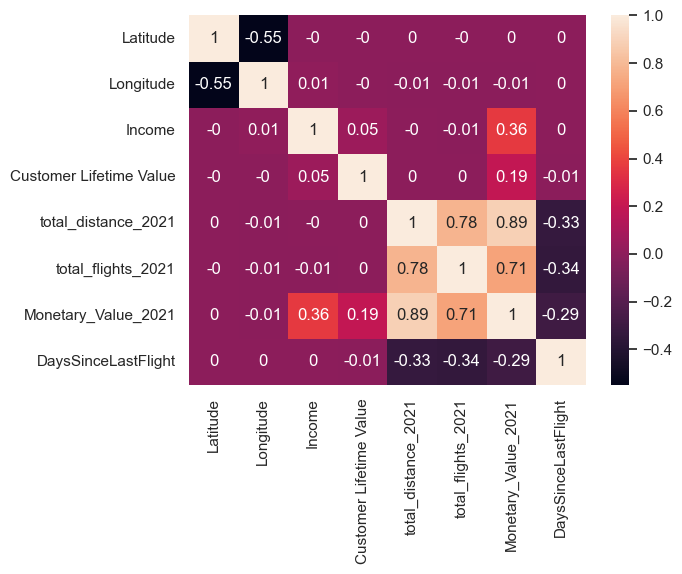

In [94]:
sns.heatmap(df_Customer[cust_num_cols].corr(method='spearman').round(2), annot=True)

Plot the pairplot for numerical variables.

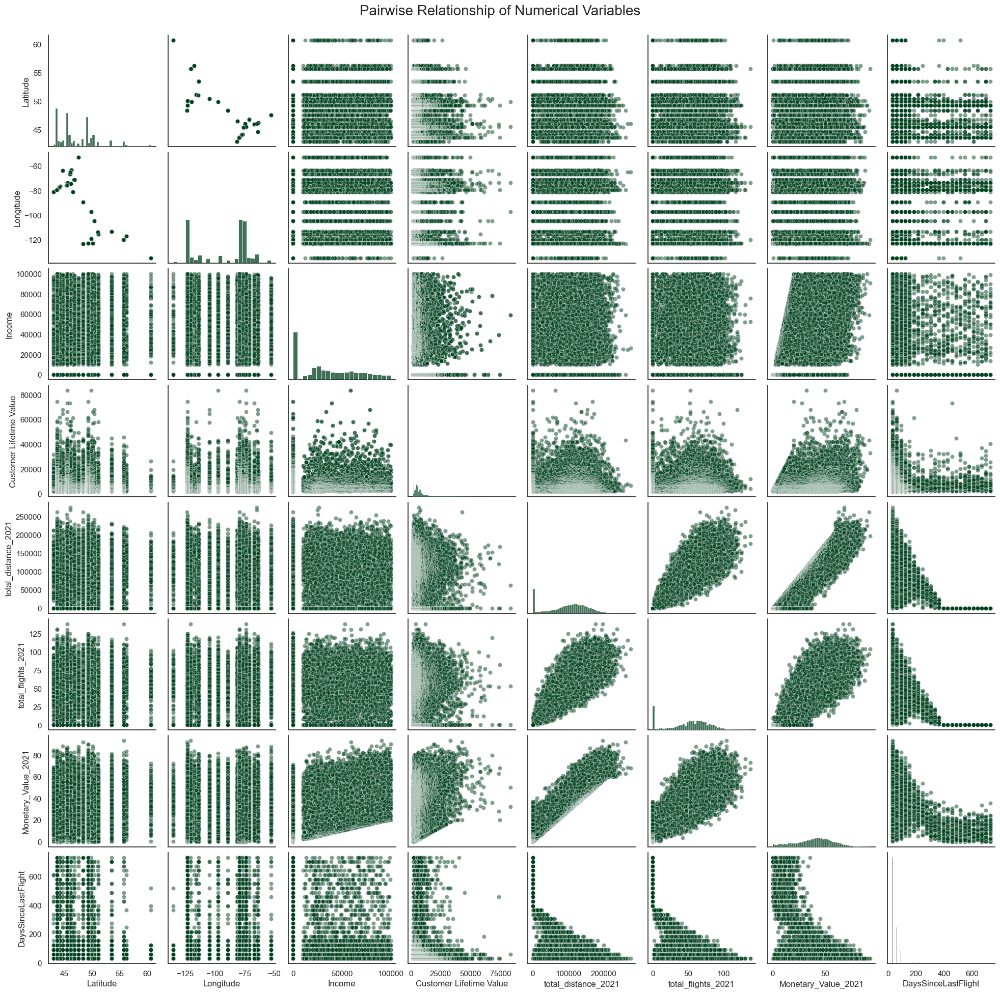

In [95]:
sns.pairplot(df_Customer[cust_num_cols], diag_kind='hist', plot_kws={'alpha':0.5})
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)
plt.show()

**Main Takeaways**
- The 0 values seem to dominate income and customer lifetime value. You cannot see any real correlation aside from features that are contained in the created feature 'Monetary_Value_2021'. Aside form that total_distance_2021 and total_flights_2021 are correlated as well.
---

## 5.1b Numerical vs Numerical

<Axes: >

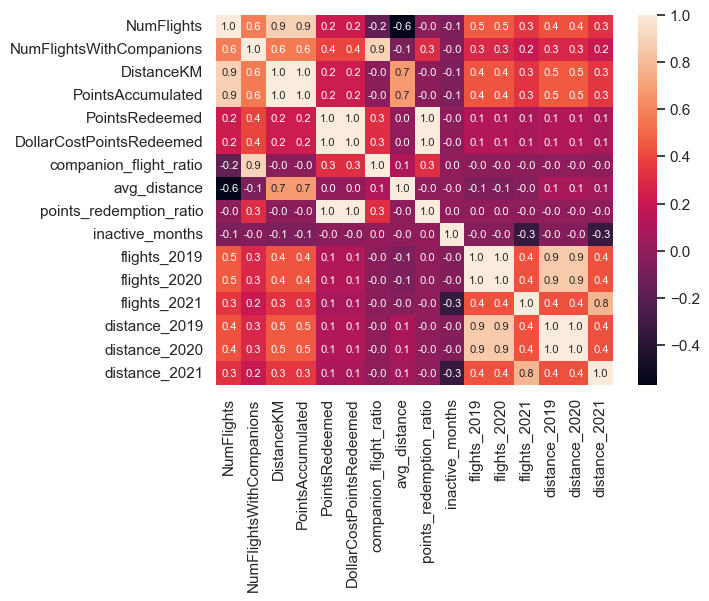

In [96]:
sns.heatmap(df_Flights[flights_num_cols].corr(method='spearman'), annot=True, fmt=".1f", annot_kws={'size': 8})

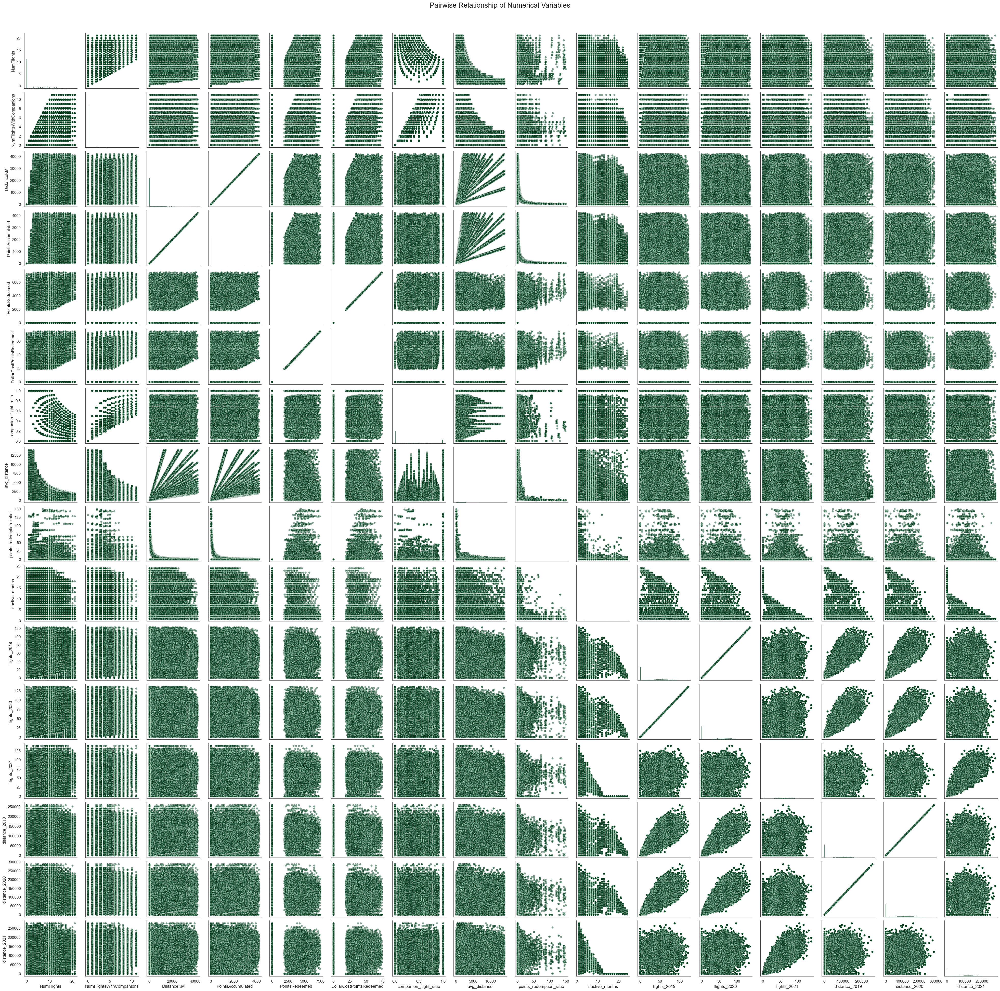

In [97]:
sns.pairplot(df_Flights[flights_num_cols], diag_kind='hist', plot_kws={'alpha':0.5})
plt.subplots_adjust(top=0.95)
plt.suptitle("Pairwise Relationship of Numerical Variables", fontsize=20)
plt.show()

In [98]:
non_zero_df = df_Flights[(df_Flights['NumFlights'] != 0)]

Plot the correlation heatmap for numerical variables without 0 values.

<Axes: >

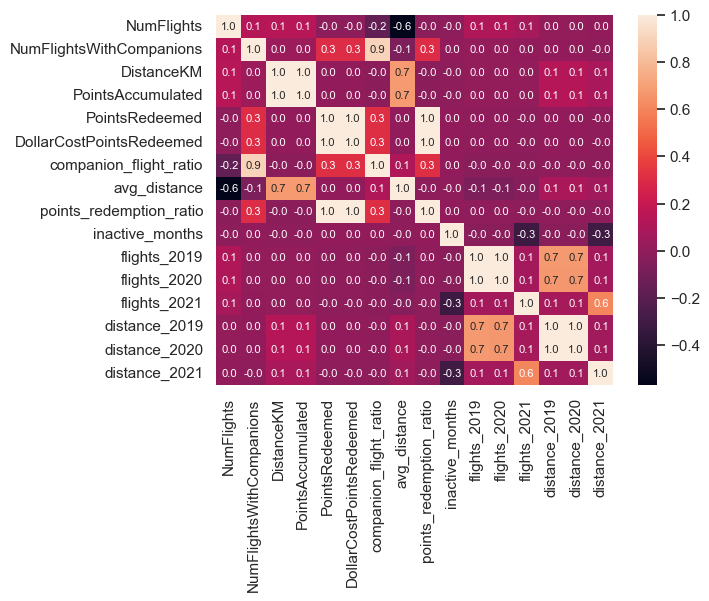

In [133]:
sns.heatmap(non_zero_df[flights_num_cols].corr(method='spearman'), annot=True, fmt=".1f", annot_kws={'size': 8})

**Main Takeaways**
- Correlation heatmap: DistanceKM and PointsAccumulated are (obviously) perfectly correlated as the points received are determined by the distance travelled. NumFlights and avg_distance are negatively correlated (-0.6), meaning that customers who travel more often tend to take shorter flights; a lot of features tend to have quite low correlation overall.
---

## 5.2a Categorical vs Categorical

Look at the unique values for the categorical columns in df_customer. If a value is > 10 we do not want to plot them.

In [101]:
print(df_Customer[cust_cat_cols].nunique())

Province or State            11
City                         29
Postal code                  75
Gender                        2
Education                     5
Location Code                 3
Marital Status                3
LoyaltyStatus                 3
EnrollmentType                2
is_active_6m                  2
is_active_12m                 2
rejoined                      2
is_current_loyalty_member     2
is_previous_member            2
active_loyalty_label          4
dtype: int64


In [102]:
cust_cat_cols.remove('Province or State')
cust_cat_cols.remove('City')
cust_cat_cols.remove('Postal code')

Define function to plot percentage stacked bar charts for the categorical vs categorical variables.

In [103]:
def plot_stacked_bar_bidirectional(df, cat_col_1, cat_col_2):
    """
    Create two stacked bar charts: A by B and B by A.
    """
    fig, axes = plt.subplots(1, 2, figsize=(18, 6))
    sns.set()
    
    # Plot 1: cat_col_1 by cat_col_2
    crosstab_1 = pd.crosstab(df[cat_col_1], df[cat_col_2])
    crosstab_pct_1 = crosstab_1.div(crosstab_1.sum(axis=1), axis=0) * 100
    
    crosstab_pct_1.plot(
        kind='bar',
        stacked=True,
        ax=axes[0],
        colormap='Greens',
        edgecolor='black',
        linewidth=0.5
    )
    axes[0].set_title(f'{cat_col_1} by {cat_col_2}', fontsize=12, fontweight='bold')
    axes[0].set_xlabel(cat_col_1)
    axes[0].set_ylabel('Percentage (%)')
    axes[0].legend(title=cat_col_2, bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=8)
    axes[0].set_ylim(0, 100)
    axes[0].grid(axis='y', alpha=0.3)
    axes[0].tick_params(axis='x', rotation=45)
    
    # Plot 2: cat_col_2 by cat_col_1
    crosstab_2 = pd.crosstab(df[cat_col_2], df[cat_col_1])
    crosstab_pct_2 = crosstab_2.div(crosstab_2.sum(axis=1), axis=0) * 100
    
    crosstab_pct_2.plot(
        kind='bar',
        stacked=True,
        ax=axes[1],
        colormap='Greens',
        edgecolor='black',
        linewidth=0.5
    )
    axes[1].set_title(f'{cat_col_2} by {cat_col_1}', fontsize=12, fontweight='bold')
    axes[1].set_xlabel(cat_col_2)
    axes[1].set_ylabel('Percentage (%)')
    axes[1].legend(title=cat_col_1, bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=8)
    axes[1].set_ylim(0, 100)
    axes[1].grid(axis='y', alpha=0.3)
    axes[1].tick_params(axis='x', rotation=45)
    
    plt.tight_layout()
    plt.show()

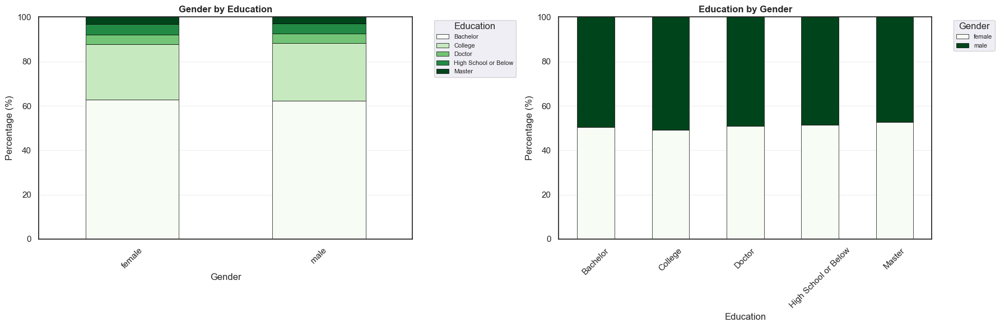

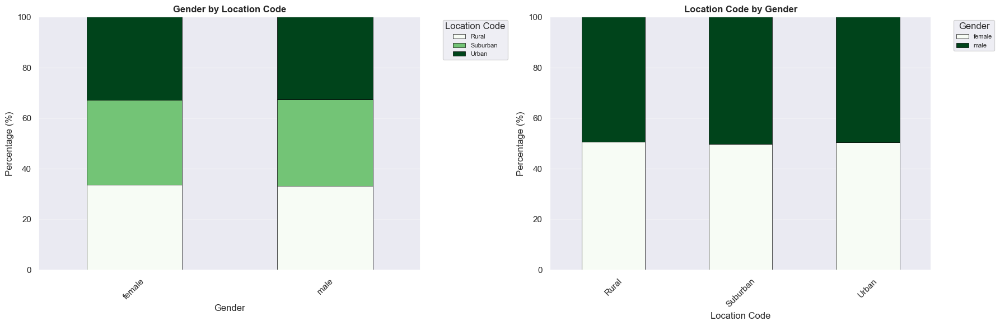

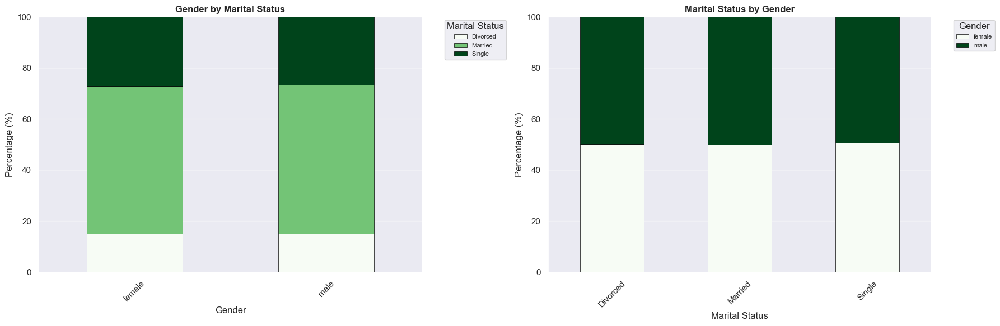

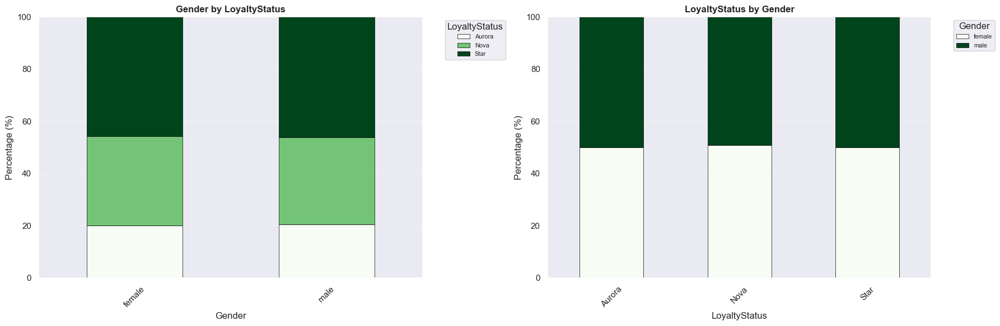

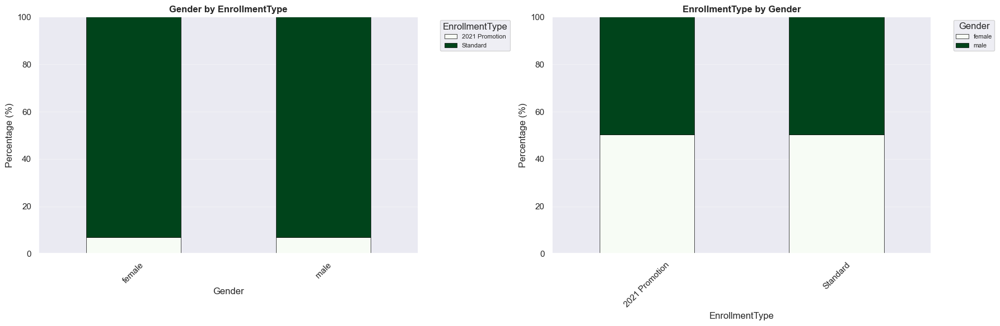

...

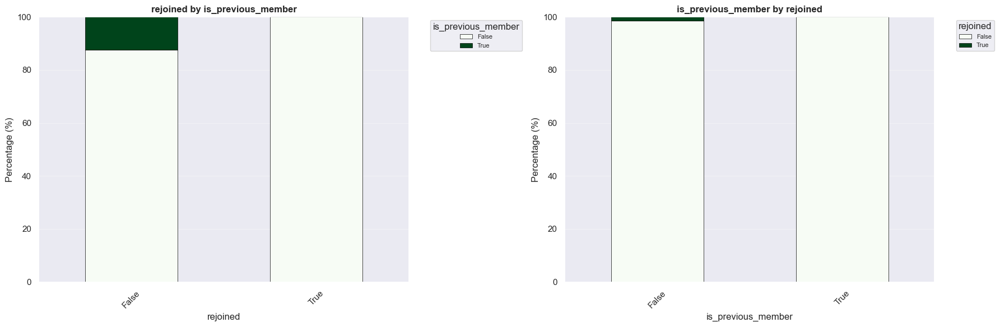

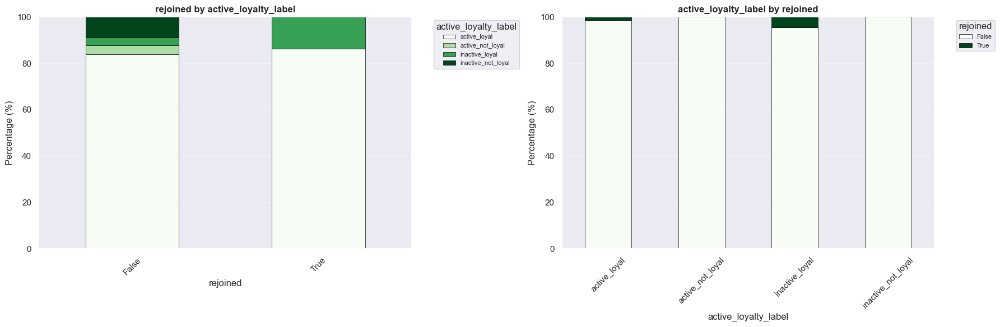

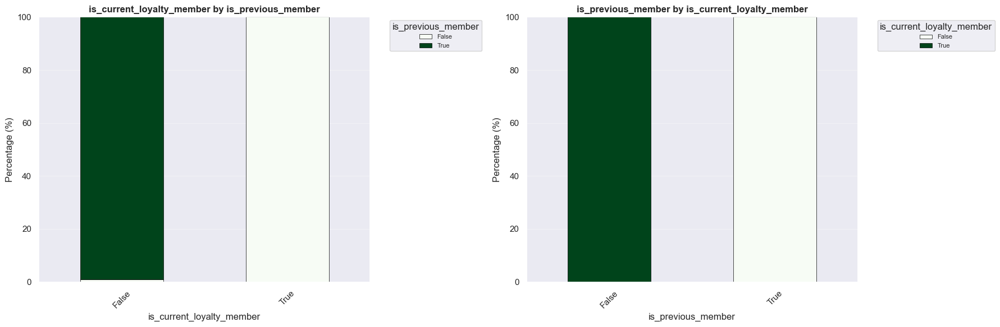

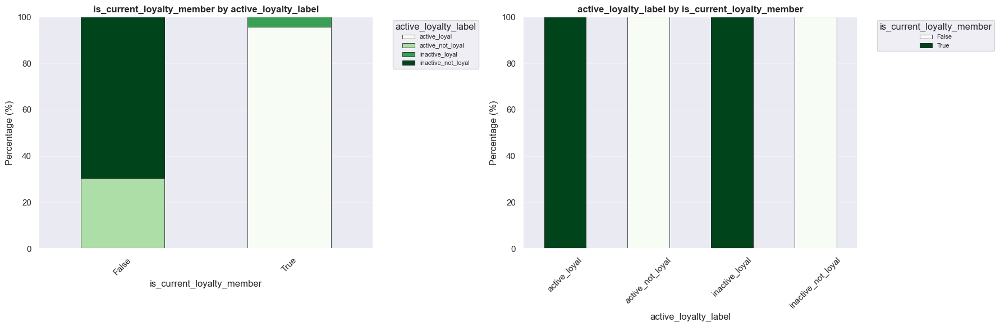

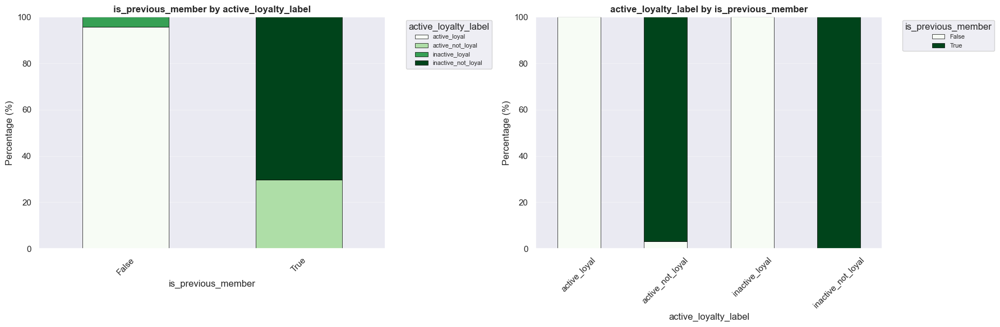

In [104]:
# Generate all combinations
for cat_col_1, cat_col_2 in combinations(cust_cat_cols, 2):
    plot_stacked_bar_bidirectional(df_Customer, cat_col_1, cat_col_2)

**Main Takeaways**

The only visible correlation is between:
1. Education x Marital Status: People with a college degree are more likely to be single and less likely to be married compared to those with other education levels. Mainly people with a bachelor's degree or college degree are single.
2. Education x Loyalty Status: The Bachelor students have a slightly smaller proportion of Star loyalty status compared to other education levels.
---

## 5.2b Categorical vs Categorical

In [105]:
print(flights_cat_cols)
print(df_Flights[flights_cat_cols].nunique())

['Year', 'Month', 'season']
Year       3
Month     12
season     4
dtype: int64


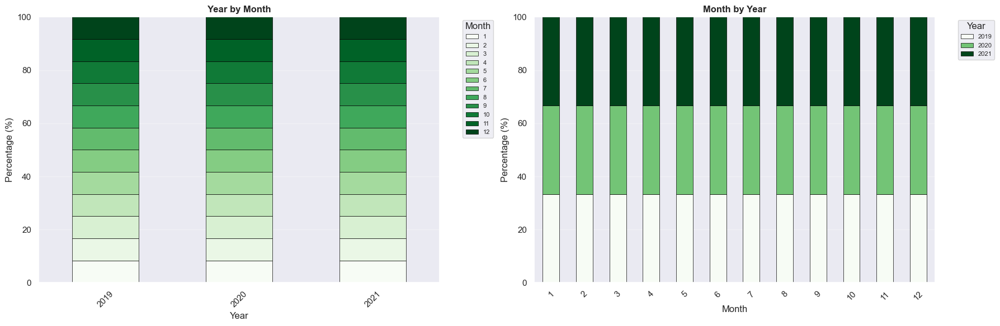

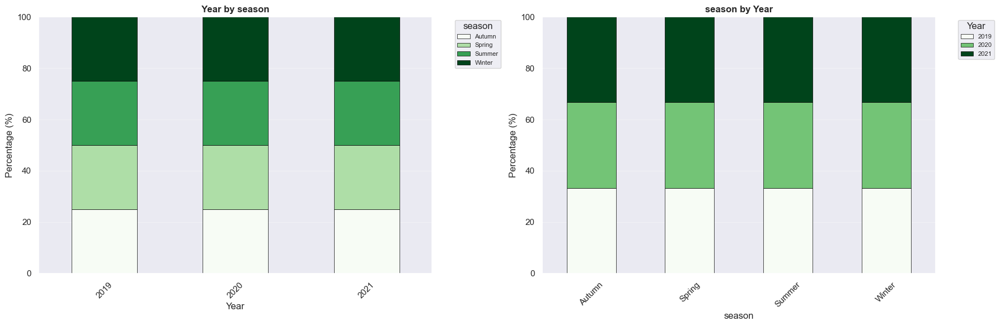

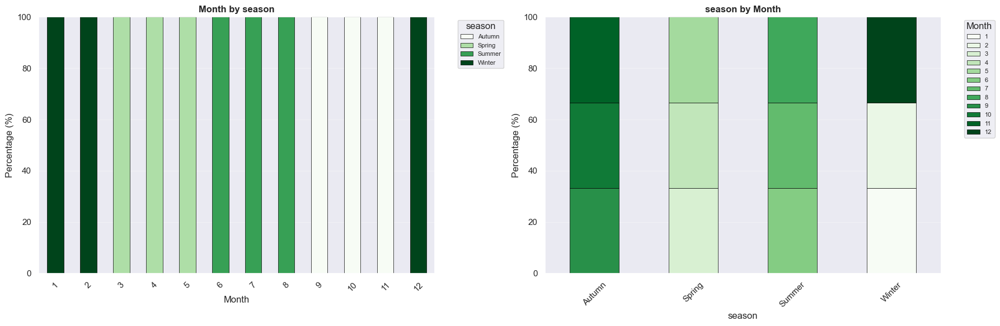

In [106]:
# Generate all combinations
for cat_col_1, cat_col_2 in combinations(flights_cat_cols, 2):
    plot_stacked_bar_bidirectional(df_Flights, cat_col_1, cat_col_2)

**Main Takeaways**
- Long range flights are the most dominent range across all years. However, this behavior slightly shifts towards year 2021, as medium range flights become more often booked.
- Long range flights dominate throughout the year, with medium and short range flights only slowly increasing from january to december.
- There seems to be no other relation between the categorical variables.
---

## 5.3a Numerical vs Categorical

Delete Latitude and Longitude from numerical columns as we cannot interpret them usefully.

In [107]:
cust_num_cols.remove('Latitude')
cust_num_cols.remove('Longitude')

Define function to analyze inpact of categorical variable on the numerical variables in a summary table.

In [108]:
def analyse_categorical_features(df, feature, numerical_cols):
    """
    Show all categories of a chosen categorical feature along with:
    - mean and median for each numerical column
    - number of occurrences

    Args:
        df (pd.DataFrame): Dataframe containing the data
        feature (str): Categorical feature to analyze
        numerical_cols (list): List of numerical columns to analyze
    
    Returns:
        pd.DataFrame: Summary table with mean, median, and count for each category
    """
    # Start with counts
    counts = df[feature].value_counts().reset_index()
    counts.columns = [feature, 'count']

    anova_results = []
    
    summary = counts.copy()
    
    # Calculate mean and median for each numerical column
    for num_col in numerical_cols:
        # Mean
        mean_values = df.groupby(feature)[num_col].mean().round(2).reset_index()
        mean_values.rename(columns={num_col: f'{num_col}_mean'}, inplace=True)
        
        # Median
        median_values = df.groupby(feature)[num_col].median().round(2).reset_index()
        median_values.rename(columns={num_col: f'{num_col}_median'}, inplace=True)
        
        # Merge into summary
        summary = pd.merge(summary, mean_values, on=feature)
        summary = pd.merge(summary, median_values, on=feature)
    
    # Sort by count (descending)
    summary = summary.sort_values(by='count', ascending=False)

    print("Summary Table:")
    print(summary.to_string(index=False))
    
    return #summary

Define function to analze impact of categorical variable on the numerical variables with boxplots.

In [109]:
def plot_categorical_vs_numerical(df, categorical_col, numerical_cols):
    """
    Creates a 2x3 grid of boxplots showing the relationship between 
    a categorical column and multiple numerical columns.
    
    Parameters:
    -----------
    df : pandas.DataFrame
        The dataframe containing the data
    categorical_col : str
        Name of the categorical column (x-axis)
    numerical_cols : list
        List of 4 numerical column names (y-axis)
    """
    
    # Create a 2x2 subplot grid
    fig, axes = plt.subplots(2, 3, figsize=(14, 10))
    
    # Flatten the axes array for easier iteration
    axes = axes.flatten()
    
    # Create a boxplot for each numerical column
    for idx, num_col in enumerate(numerical_cols):
        sns.boxplot(data=df, x=categorical_col, y=num_col, ax=axes[idx], color=CUSTOM_HEX[1])
        axes[idx].set_title(f'{num_col} by {categorical_col}', fontsize=12, fontweight='bold')
        axes[idx].set_xlabel(categorical_col, fontsize=10)
        axes[idx].set_ylabel(num_col, fontsize=10)
        
        # Rotate x-axis labels if they're too long
        axes[idx].tick_params(axis='x', rotation=45)
    
    # Adjust layout to prevent overlap
    plt.tight_layout()
    plt.show()

Feature: Gender

In [110]:
cust_cat_cols
# since we only want to look at active customers that were active we aonly show is_current_loyalty_member

# delete new cols that are not is current loyalty member
cust_cat_cols.remove('is_active_6m')
cust_cat_cols.remove('is_active_12m')
cust_cat_cols.remove('is_previous_member')

Summary Table:
Gender  count  Income_mean  Income_median  Customer Lifetime Value_mean  Customer Lifetime Value_median  total_distance_2021_mean  total_distance_2021_median  total_flights_2021_mean  total_flights_2021_median  Monetary_Value_2021_mean  Monetary_Value_2021_median  DaysSinceLastFlight_mean  DaysSinceLastFlight_median
female   8346     38033.72        34161.0                       7965.12                         5757.44                  99837.48                    109145.0                    52.02                       57.0                     39.65                       41.68                     72.00                        31.0
  male   8248     37442.83        34112.0                       8008.12                         5800.77                  99668.77                    108326.0                    52.06                       56.0                     39.52                       41.16                     70.79                        31.0


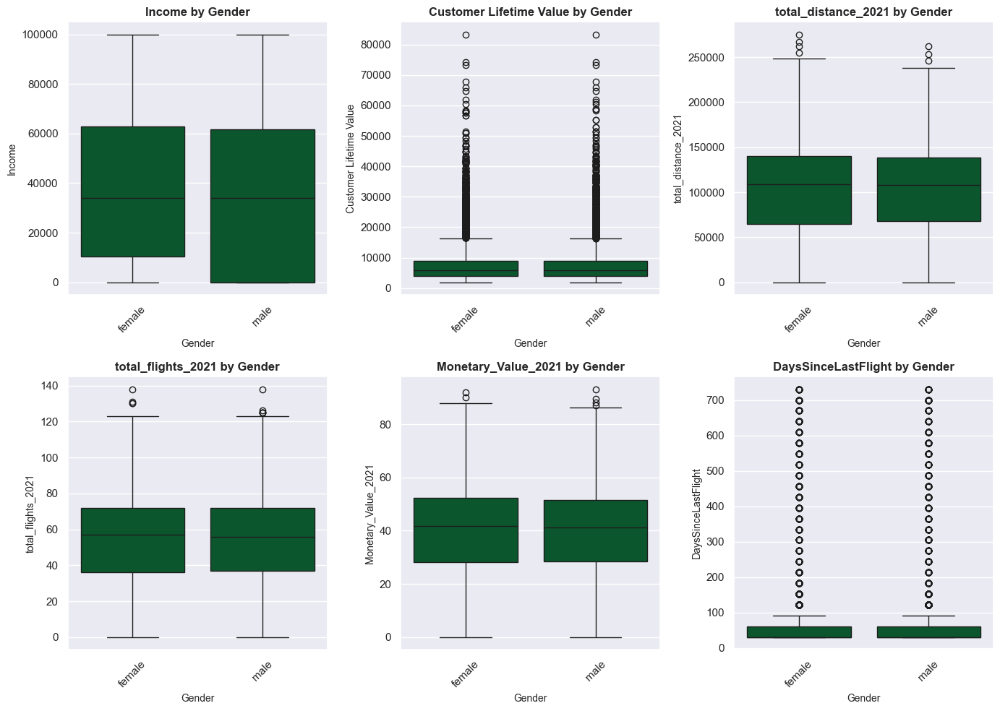

In [111]:
analyse_categorical_features(df_Customer, 'Gender', cust_num_cols)
plot_categorical_vs_numerical(df_Customer, 'Gender', cust_num_cols)

Feature: Education

Summary Table:
           Education  count  Income_mean  Income_median  Customer Lifetime Value_mean  Customer Lifetime Value_median  total_distance_2021_mean  total_distance_2021_median  total_flights_2021_mean  total_flights_2021_median  Monetary_Value_2021_mean  Monetary_Value_2021_median  DaysSinceLastFlight_mean  DaysSinceLastFlight_median
            Bachelor  10386     56359.41        55579.5                       8199.16                         5864.38                  99325.05                    108172.5                    51.83                       57.0                     43.39                       45.30                     70.55                        31.0
             College   4208         0.00            0.0                       7614.06                         5611.93                 100417.16                    109011.5                    52.55                       57.0                     31.85                       34.17                     73.27                  

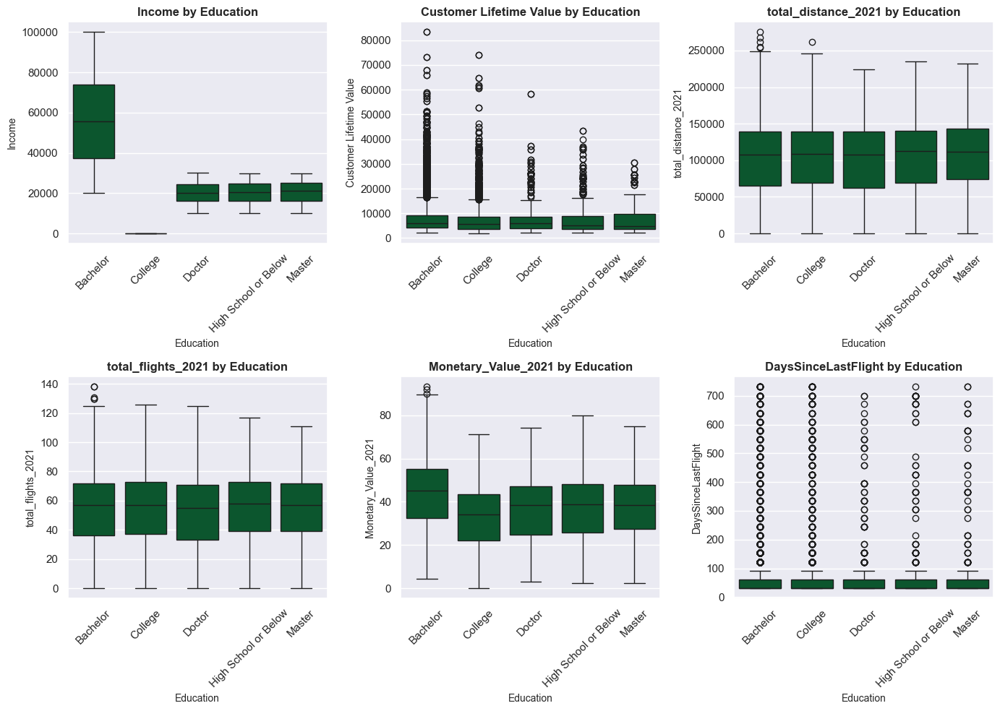

In [112]:
analyse_categorical_features(df_Customer, 'Education', cust_num_cols)
plot_categorical_vs_numerical(df_Customer, 'Education', cust_num_cols)

Feature: Location Code

Summary Table:
Location Code  count  Income_mean  Income_median  Customer Lifetime Value_mean  Customer Lifetime Value_median  total_distance_2021_mean  total_distance_2021_median  total_flights_2021_mean  total_flights_2021_median  Monetary_Value_2021_mean  Monetary_Value_2021_median  DaysSinceLastFlight_mean  DaysSinceLastFlight_median
     Suburban   5616     37975.74        34537.0                       7867.94                         5705.72                  99997.88                    108169.5                    52.33                       57.0                     39.64                       41.42                     69.53                        31.0
        Rural   5564     37674.26        33837.0                       8027.42                         5786.49                  99391.51                    108430.0                    51.70                       57.0                     39.50                       41.19                     71.10                        31.0
        Ur

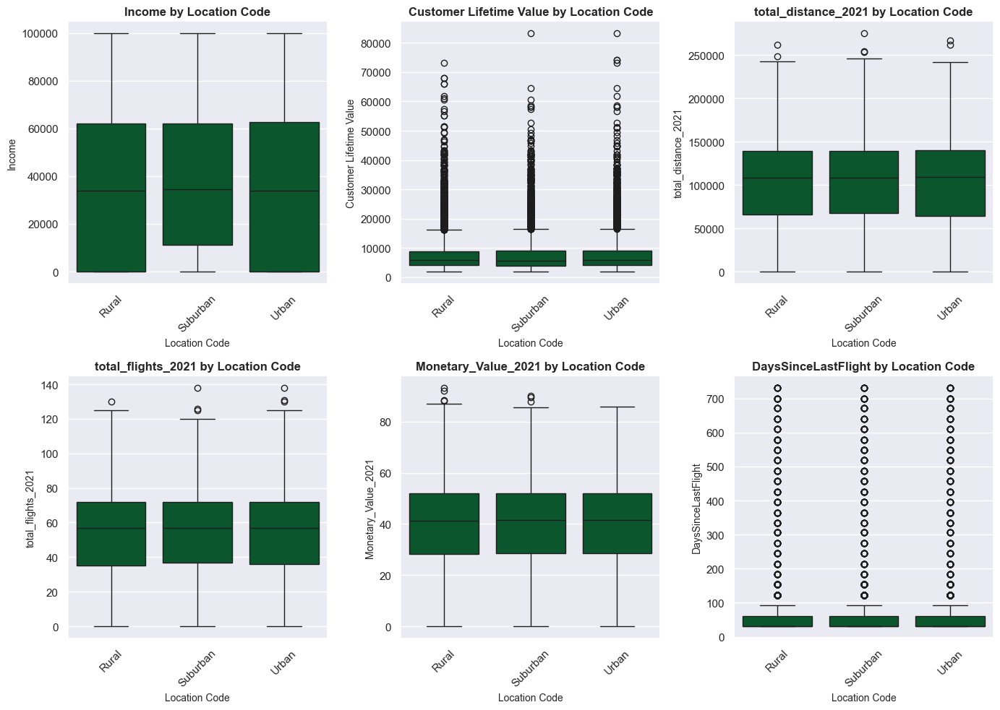

In [113]:
analyse_categorical_features(df_Customer, 'Location Code', cust_num_cols)
plot_categorical_vs_numerical(df_Customer, 'Location Code', cust_num_cols)

Feature: Marital Status

Summary Table:
Marital Status  count  Income_mean  Income_median  Customer Lifetime Value_mean  Customer Lifetime Value_median  total_distance_2021_mean  total_distance_2021_median  total_flights_2021_mean  total_flights_2021_median  Monetary_Value_2021_mean  Monetary_Value_2021_median  DaysSinceLastFlight_mean  DaysSinceLastFlight_median
       Married   9658     43828.46        41459.0                       8055.48                         5827.44                  99801.22                    108652.5                    51.89                       56.0                     40.88                       42.81                     70.60                        31.0
        Single   4449     22812.40            0.0                       7724.65                         5585.31                  99689.01                    109387.0                    52.33                       57.0                     36.36                       38.05                     74.07                        31.0
      D

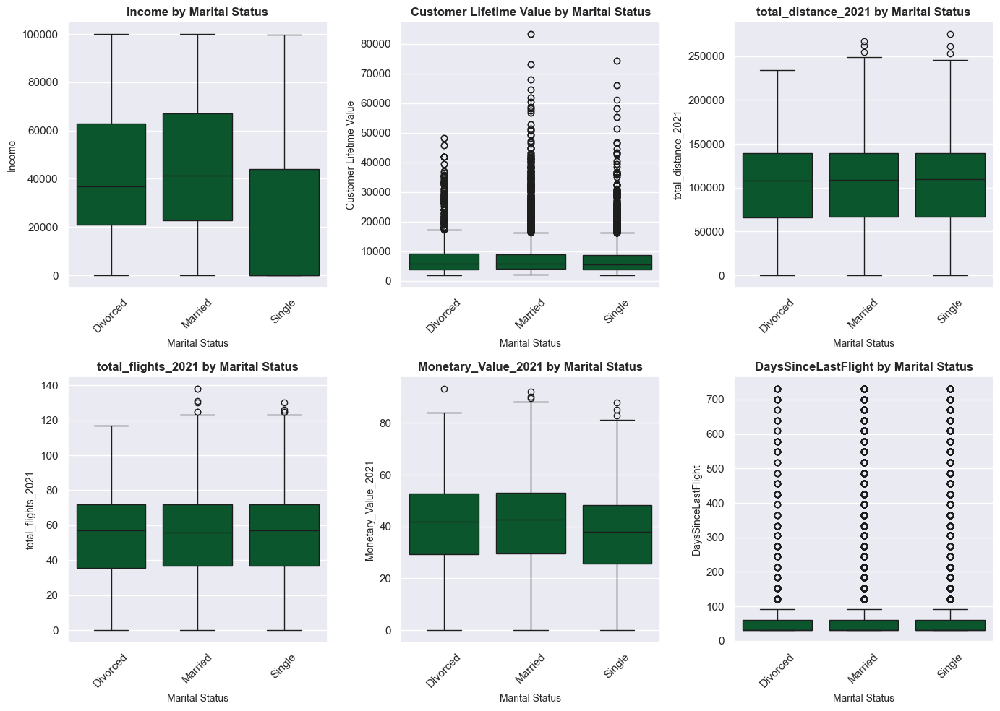

In [114]:
analyse_categorical_features(df_Customer, 'Marital Status', cust_num_cols)
plot_categorical_vs_numerical(df_Customer, 'Marital Status', cust_num_cols)

Feature: Loyalty Status

Summary Table:
LoyaltyStatus  count  Income_mean  Income_median  Customer Lifetime Value_mean  Customer Lifetime Value_median  total_distance_2021_mean  total_distance_2021_median  total_flights_2021_mean  total_flights_2021_median  Monetary_Value_2021_mean  Monetary_Value_2021_median  DaysSinceLastFlight_mean  DaysSinceLastFlight_median
         Star   7618     35802.93        30817.0                       6754.40                         4793.48                 100270.59                    108997.0                    52.08                       57.0                     38.63                       40.33                     70.43                        31.0
         Nova   5611     38946.83        36094.0                       8040.90                         5821.13                  99024.68                    108400.0                    52.04                       57.0                     39.66                       41.73                     72.74                        31.0
       Aur

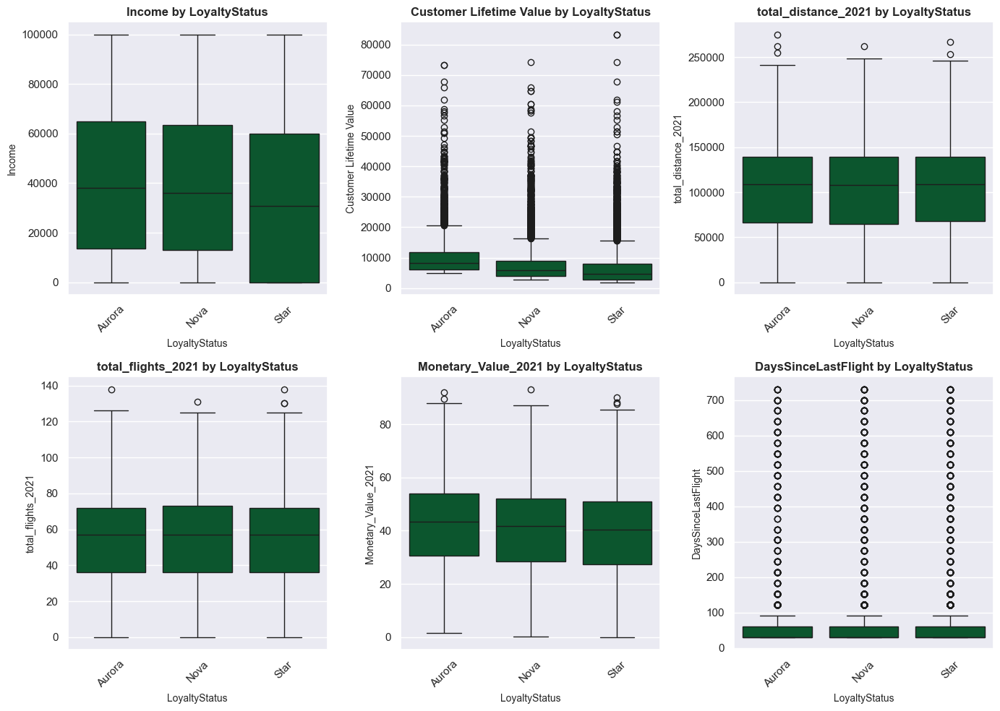

In [115]:
analyse_categorical_features(df_Customer, 'LoyaltyStatus', cust_num_cols)
plot_categorical_vs_numerical(df_Customer, 'LoyaltyStatus', cust_num_cols)

Feature: Enrollment Type

Summary Table:
EnrollmentType  count  Income_mean  Income_median  Customer Lifetime Value_mean  Customer Lifetime Value_median  total_distance_2021_mean  total_distance_2021_median  total_flights_2021_mean  total_flights_2021_median  Monetary_Value_2021_mean  Monetary_Value_2021_median  DaysSinceLastFlight_mean  DaysSinceLastFlight_median
      Standard  15456     37735.38        34103.5                       7983.19                         5766.80                  99448.65                    108980.0                    51.78                       57.0                     39.50                       41.42                     72.81                        31.0
2021 Promotion   1138     37802.54        34990.0                       8031.29                         5927.74                 103890.27                    106170.5                    55.59                       57.0                     40.79                       41.16                     53.41                        31.0


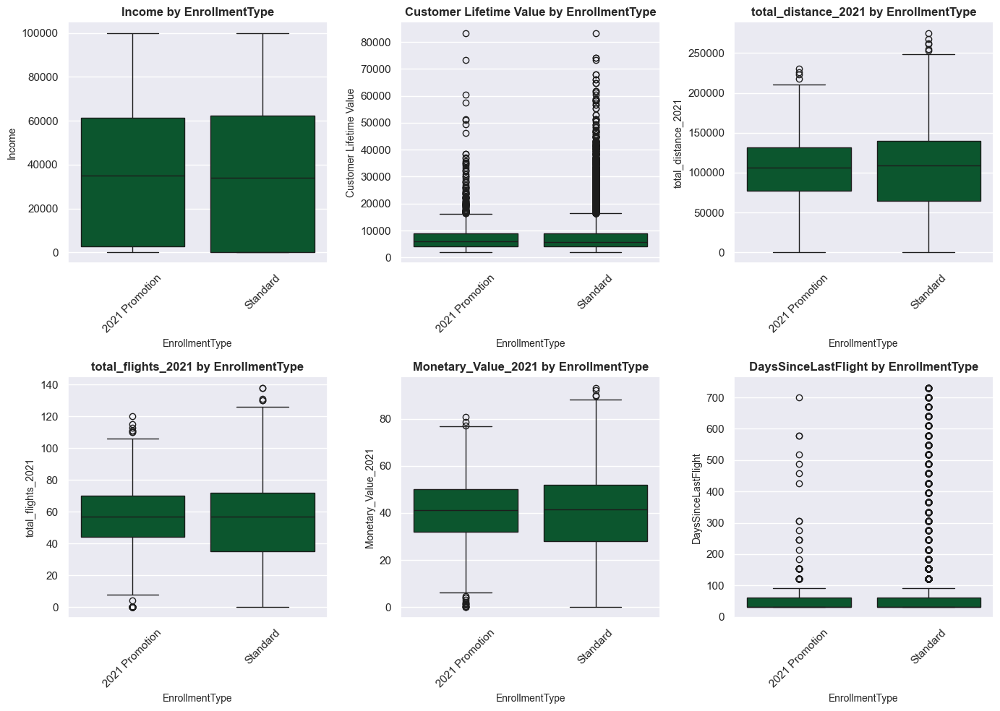

In [116]:
analyse_categorical_features(df_Customer, 'EnrollmentType', cust_num_cols)
plot_categorical_vs_numerical(df_Customer, 'EnrollmentType', cust_num_cols)

Feature: rejoined

Summary Table:
 rejoined  count  Income_mean  Income_median  Customer Lifetime Value_mean  Customer Lifetime Value_median  total_distance_2021_mean  total_distance_2021_median  total_flights_2021_mean  total_flights_2021_median  Monetary_Value_2021_mean  Monetary_Value_2021_median  DaysSinceLastFlight_mean  DaysSinceLastFlight_median
    False  16395     37721.55        34115.0                       7982.09                         5781.02                 100449.93                    109387.0                    52.41                       57.0                     39.78                       41.60                     71.55                        31.0
     True    199     39257.30        35693.0                       8349.07                         5382.75                  42456.52                     38051.0                    21.99                       20.0                     23.67                       23.58                     58.56                        31.0


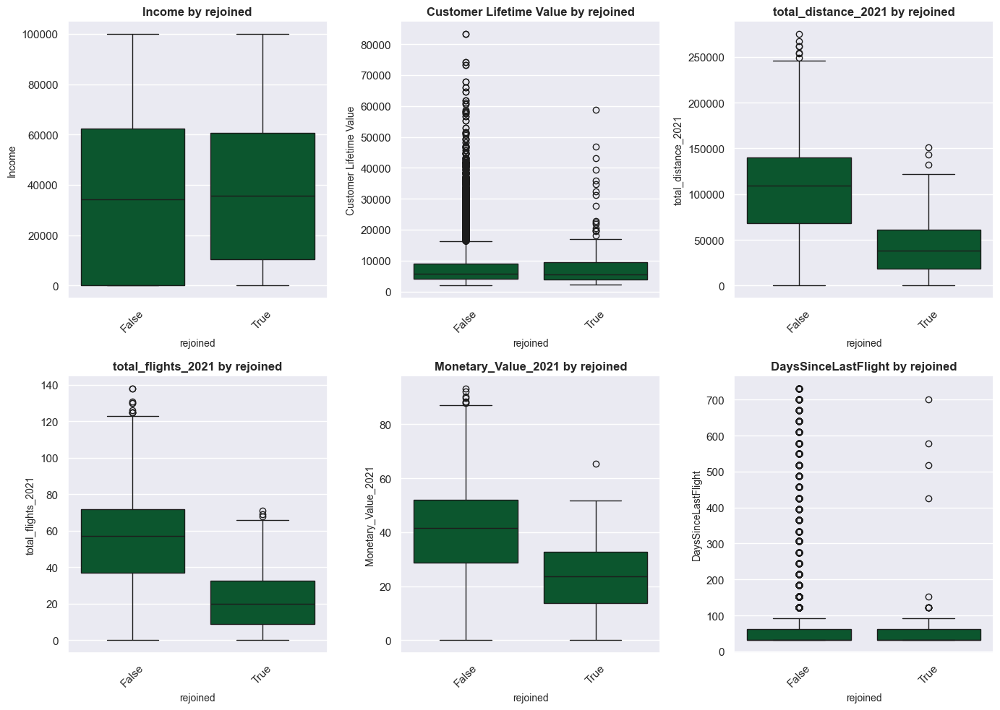

In [117]:
analyse_categorical_features(df_Customer, 'rejoined', cust_num_cols)
plot_categorical_vs_numerical(df_Customer, 'rejoined', cust_num_cols)

Feature: is_current_loyalty_member

Summary Table:
 is_current_loyalty_member  count  Income_mean  Income_median  Customer Lifetime Value_mean  Customer Lifetime Value_median  total_distance_2021_mean  total_distance_2021_median  total_flights_2021_mean  total_flights_2021_median  Monetary_Value_2021_mean  Monetary_Value_2021_median  DaysSinceLastFlight_mean  DaysSinceLastFlight_median
                      True  14528     37786.54        34319.5                       7969.97                         5780.18                 111026.14                    115790.0                    57.91                       60.0                     42.81                       43.57                     48.47                        31.0
                     False   2066     37409.45        33302.5                       8103.83                         5777.02                  19710.96                         0.0                    10.38                        0.0                     16.70                       14.28                    358.00

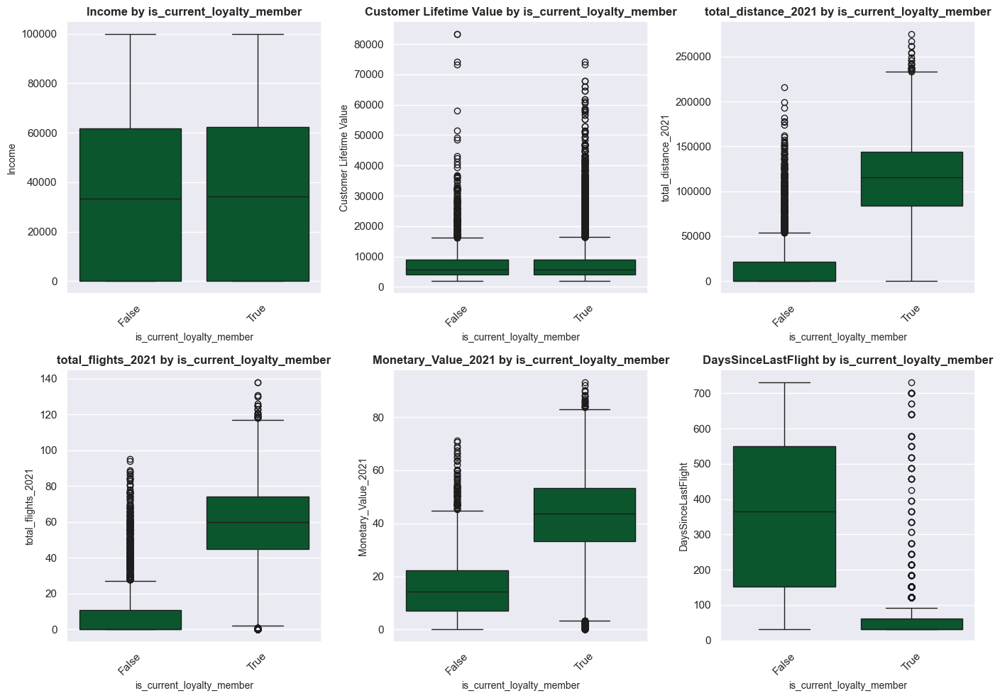

In [118]:
analyse_categorical_features(df_Customer, 'is_current_loyalty_member', cust_num_cols)
plot_categorical_vs_numerical(df_Customer, 'is_current_loyalty_member', cust_num_cols)

Feature: active_loyalty_label

Summary Table:
active_loyalty_label  count  Income_mean  Income_median  Customer Lifetime Value_mean  Customer Lifetime Value_median  total_distance_2021_mean  total_distance_2021_median  total_flights_2021_mean  total_flights_2021_median  Monetary_Value_2021_mean  Monetary_Value_2021_median  DaysSinceLastFlight_mean  DaysSinceLastFlight_median
        active_loyal  13918     37740.97        34244.0                       7962.11                         5780.18                 115892.21                    117826.5                    60.45                       61.0                     44.19                       44.37                     46.77                        31.0
  inactive_not_loyal   1437     37431.66        33257.0                       8245.34                         5802.07                      0.00                         0.0                     0.00                        0.0                     11.14                       10.56                    555.68                  

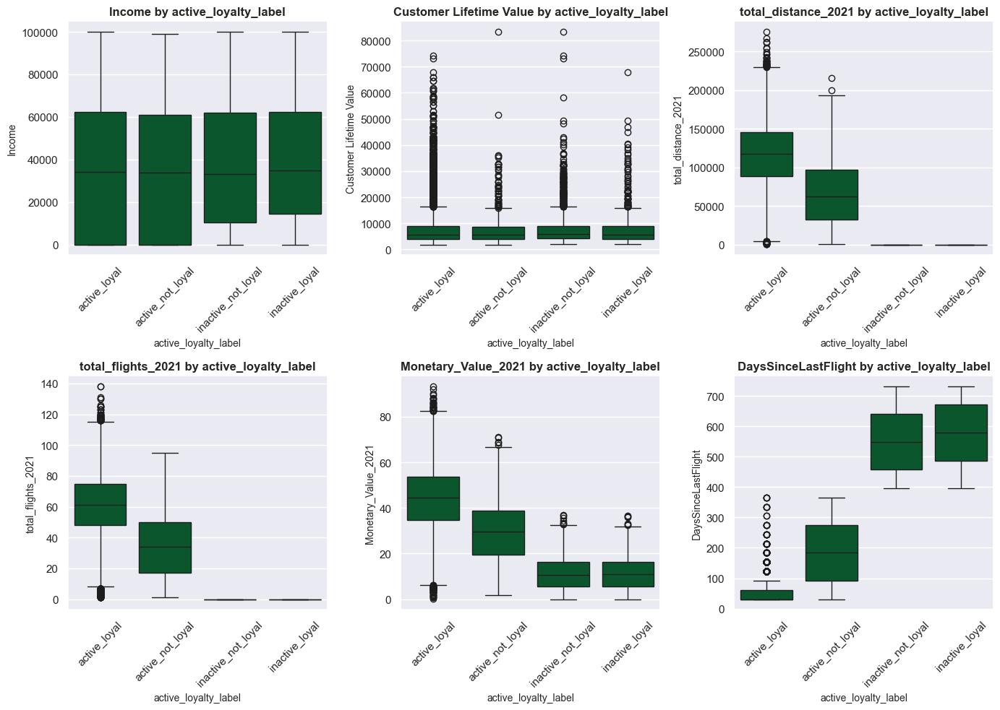

In [119]:
analyse_categorical_features(df_Customer, 'active_loyalty_label', cust_num_cols)
plot_categorical_vs_numerical(df_Customer, 'active_loyalty_label', cust_num_cols)

**Main Takeaways**
- Education: People with a Bachelor's degree have a higher Income, Customer Lifetime Value and higher monetary value.
- EnrollmentType: People enrolled with the promotion have a higher mean distance and shorter amount of days since last flight.
---

## 5.3b Numerical vs Categorical

Define function to analyze inpact of categorical variable on the numerical variables in a summary table.

Feature: Year

Summary Table:
 Year  count  NumFlights_mean  NumFlights_median  NumFlightsWithCompanions_mean  NumFlightsWithCompanions_median  DistanceKM_mean  DistanceKM_median  PointsAccumulated_mean  PointsAccumulated_median  PointsRedeemed_mean  PointsRedeemed_median  DollarCostPointsRedeemed_mean  DollarCostPointsRedeemed_median  companion_flight_ratio_mean  companion_flight_ratio_median  avg_distance_mean  avg_distance_median  points_redemption_ratio_mean  points_redemption_ratio_median  inactive_months_mean  inactive_months_median  flights_2019_mean  flights_2019_median  flights_2020_mean  flights_2020_median  flights_2021_mean  flights_2021_median  distance_2019_mean  distance_2019_median  distance_2020_mean  distance_2020_median  distance_2021_mean  distance_2021_median
 2021 198888             4.34                2.0                           1.07                              0.0          8312.80             1926.0                  831.04                     192.0               267.45     

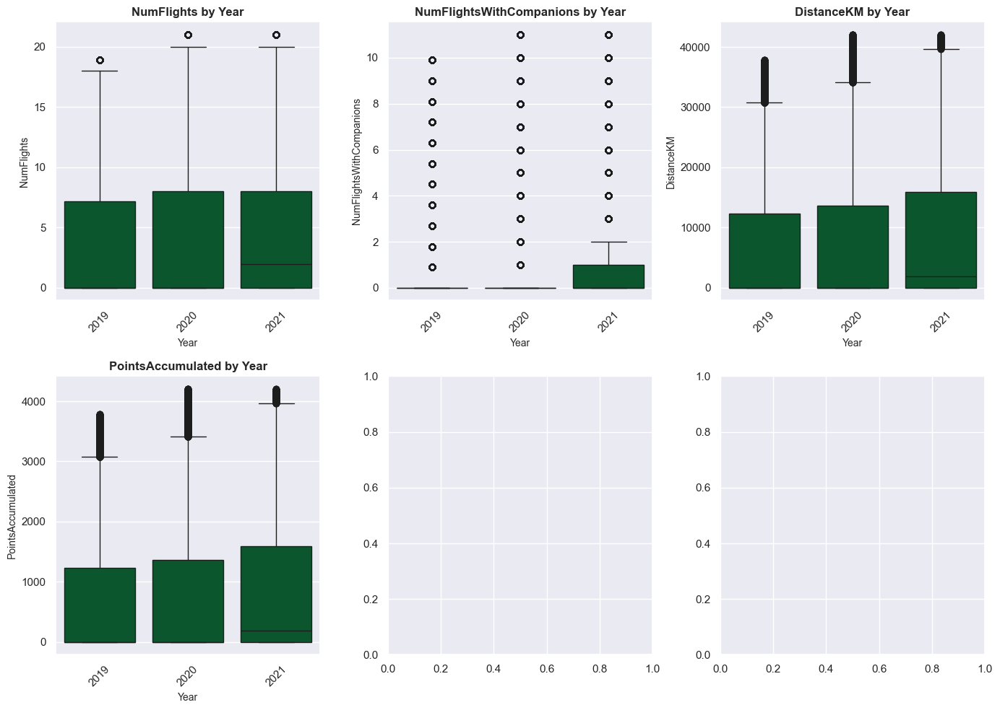

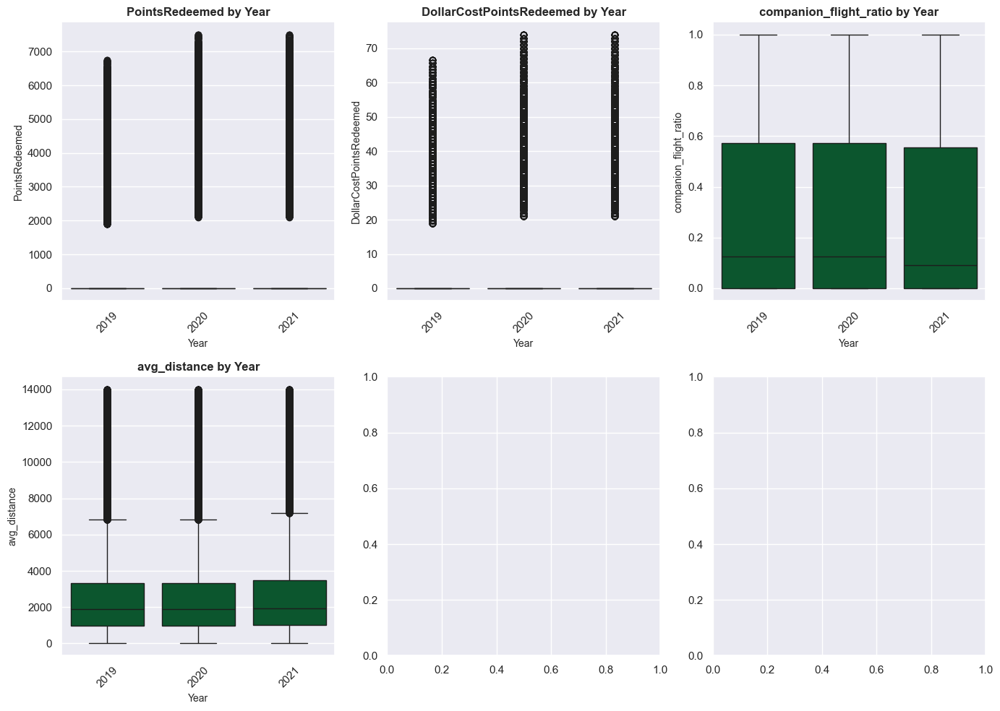

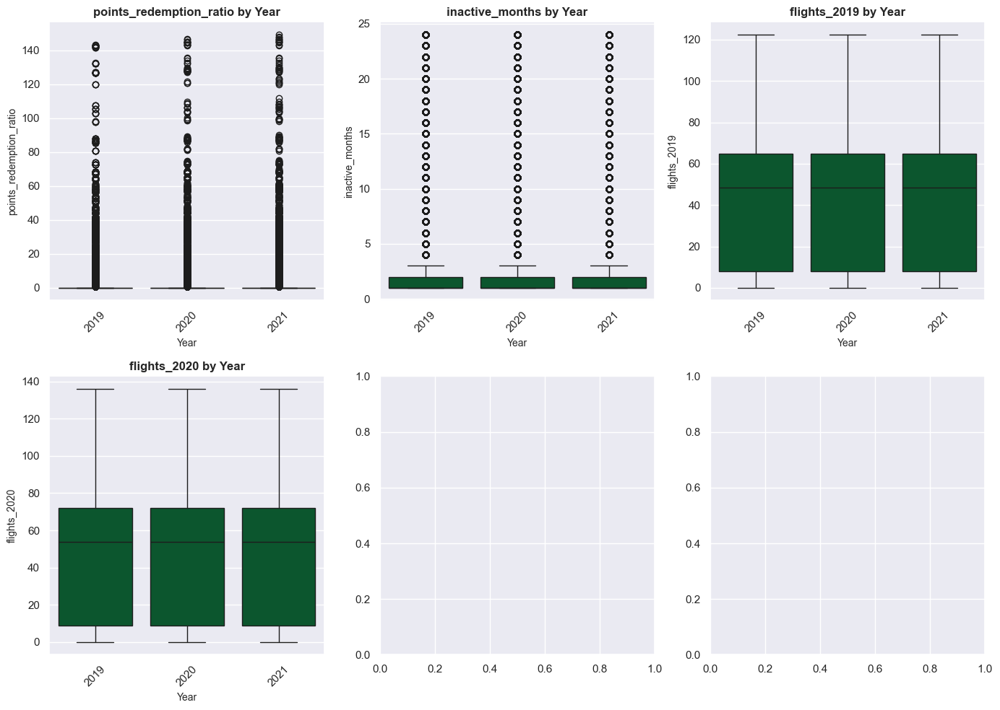

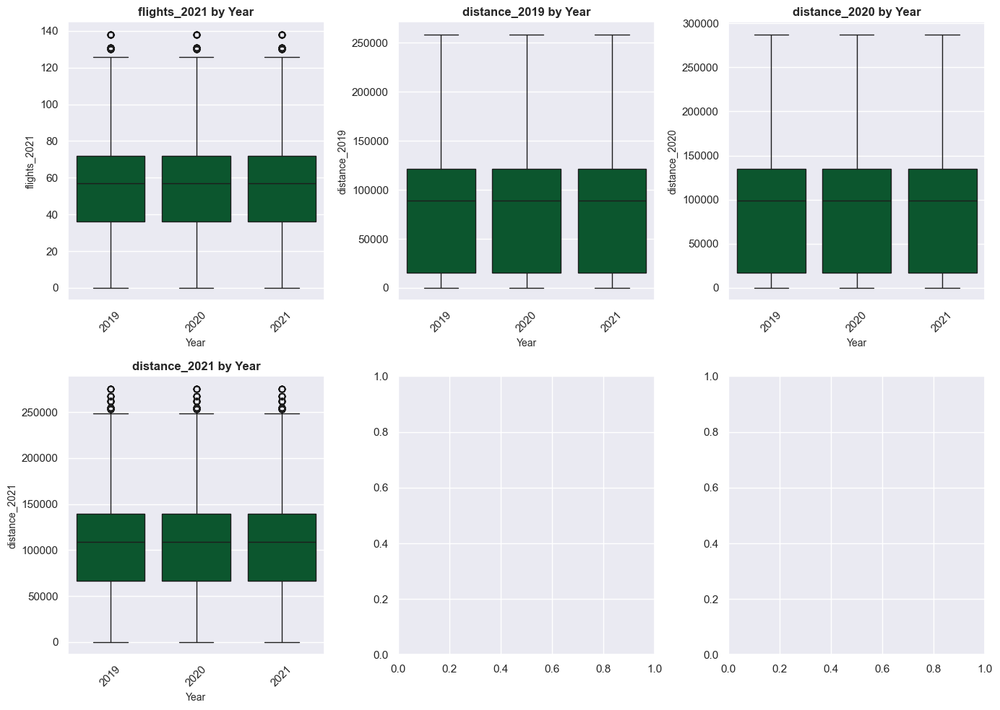

In [120]:
analyse_categorical_features(df_Flights, 'Year', flights_num_cols)

for i in range(0, len(flights_num_cols), 4):
    cols_subset = flights_num_cols[i:i+4]
    plot_categorical_vs_numerical(df_Flights, 'Year', cols_subset)

Feature: Month

Summary Table:
 Month  count  NumFlights_mean  NumFlights_median  NumFlightsWithCompanions_mean  NumFlightsWithCompanions_median  DistanceKM_mean  DistanceKM_median  PointsAccumulated_mean  PointsAccumulated_median  PointsRedeemed_mean  PointsRedeemed_median  DollarCostPointsRedeemed_mean  DollarCostPointsRedeemed_median  companion_flight_ratio_mean  companion_flight_ratio_median  avg_distance_mean  avg_distance_median  points_redemption_ratio_mean  points_redemption_ratio_median  inactive_months_mean  inactive_months_median  flights_2019_mean  flights_2019_median  flights_2020_mean  flights_2020_median  flights_2021_mean  flights_2021_median  distance_2019_mean  distance_2019_median  distance_2020_mean  distance_2020_median  distance_2021_mean  distance_2021_median
    12  49722             4.64                1.8                           1.18                              0.0          8613.50            1141.50                  861.19                    114.00               279.55   

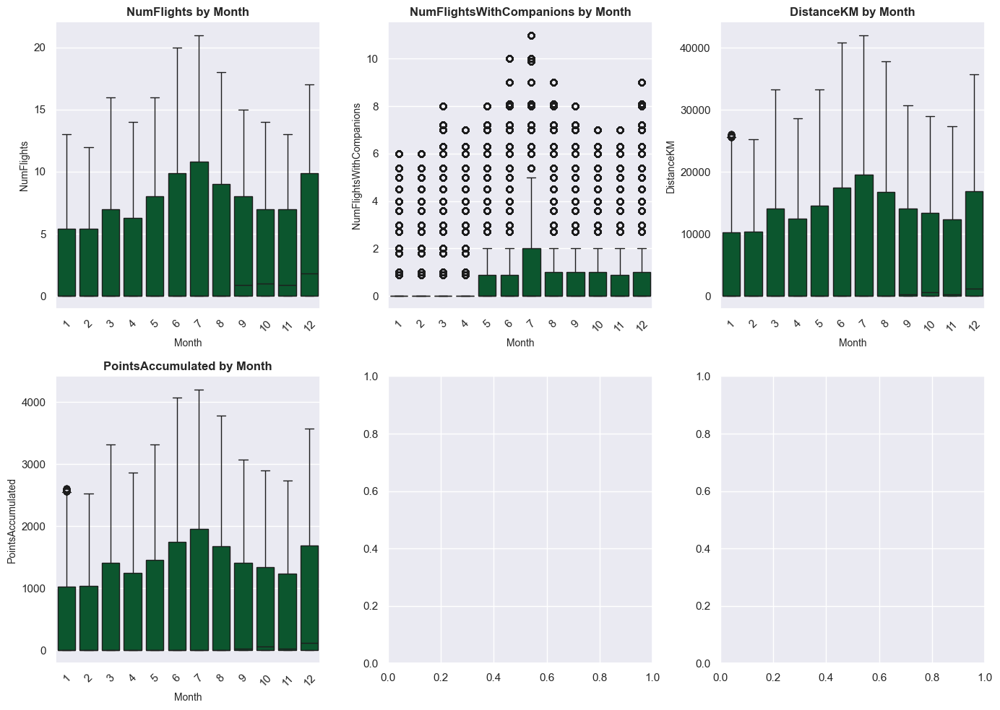

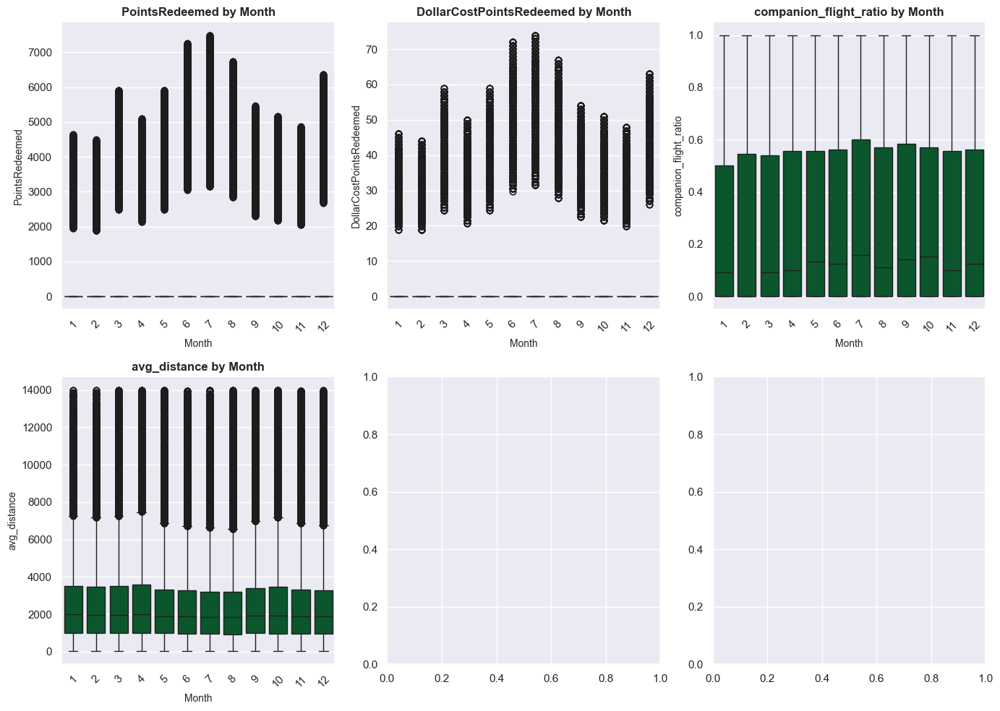

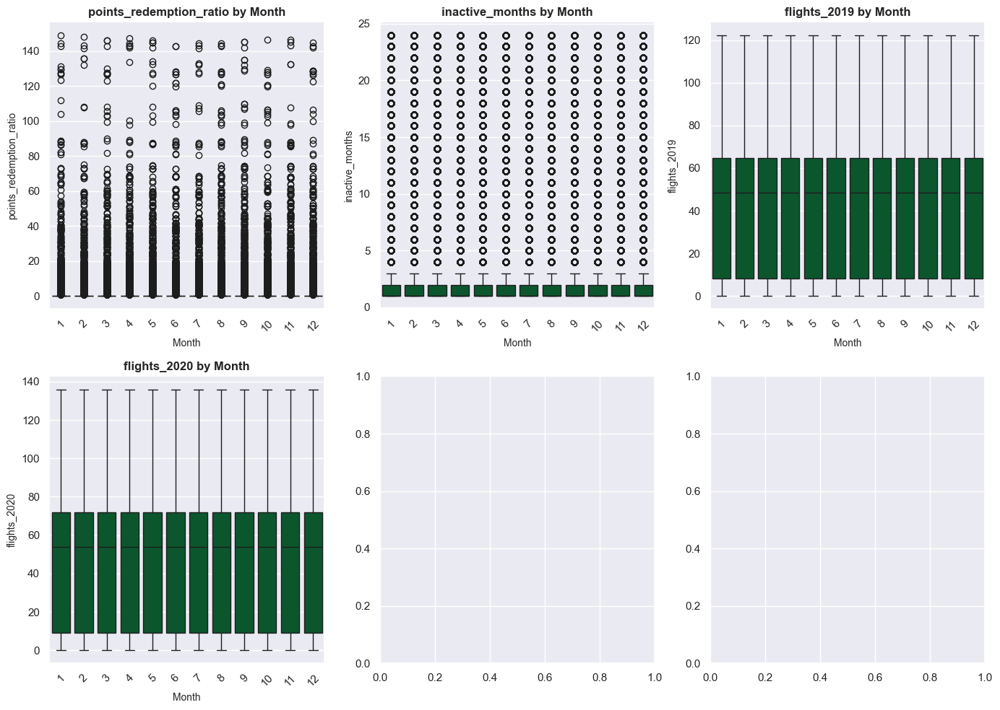

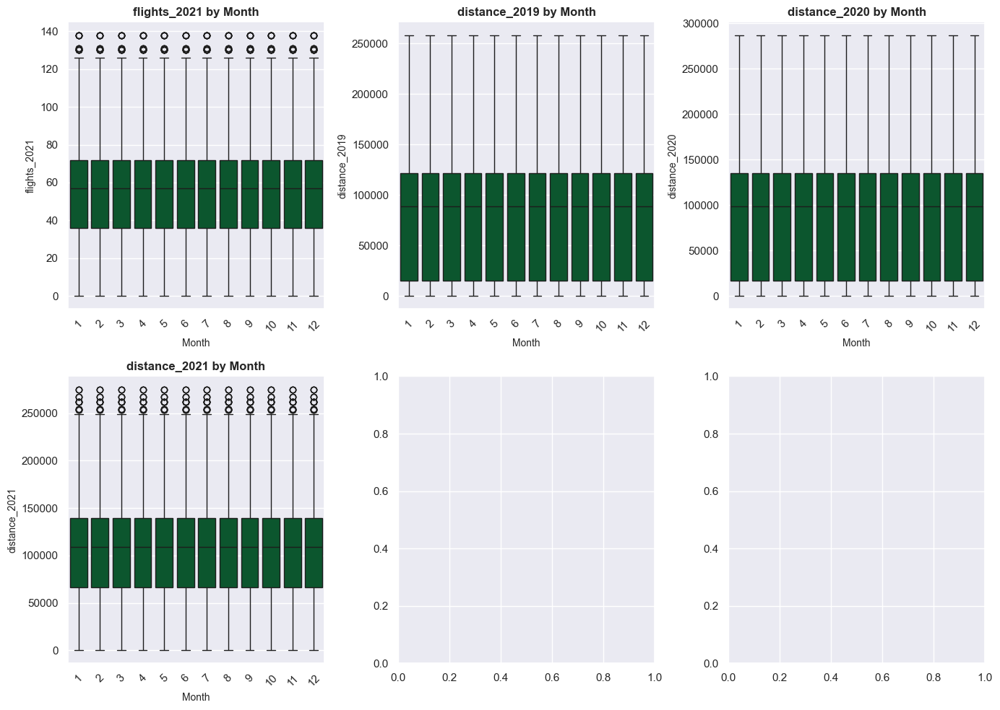

In [121]:
analyse_categorical_features(df_Flights, 'Month', flights_num_cols)

for i in range(0, len(flights_num_cols), 4):
    cols_subset = flights_num_cols[i:i+4]
    plot_categorical_vs_numerical(df_Flights, 'Month', cols_subset)

Feature: Season

Summary Table:
season  count  NumFlights_mean  NumFlights_median  NumFlightsWithCompanions_mean  NumFlightsWithCompanions_median  DistanceKM_mean  DistanceKM_median  PointsAccumulated_mean  PointsAccumulated_median  PointsRedeemed_mean  PointsRedeemed_median  DollarCostPointsRedeemed_mean  DollarCostPointsRedeemed_median  companion_flight_ratio_mean  companion_flight_ratio_median  avg_distance_mean  avg_distance_median  points_redemption_ratio_mean  points_redemption_ratio_median  inactive_months_mean  inactive_months_median  flights_2019_mean  flights_2019_median  flights_2020_mean  flights_2020_median  flights_2021_mean  flights_2021_median  distance_2019_mean  distance_2019_median  distance_2020_mean  distance_2020_median  distance_2021_mean  distance_2021_median
Winter 149166             3.38                0.0                           0.83                              0.0          6433.81                0.0                  643.24                       0.0               209.58   

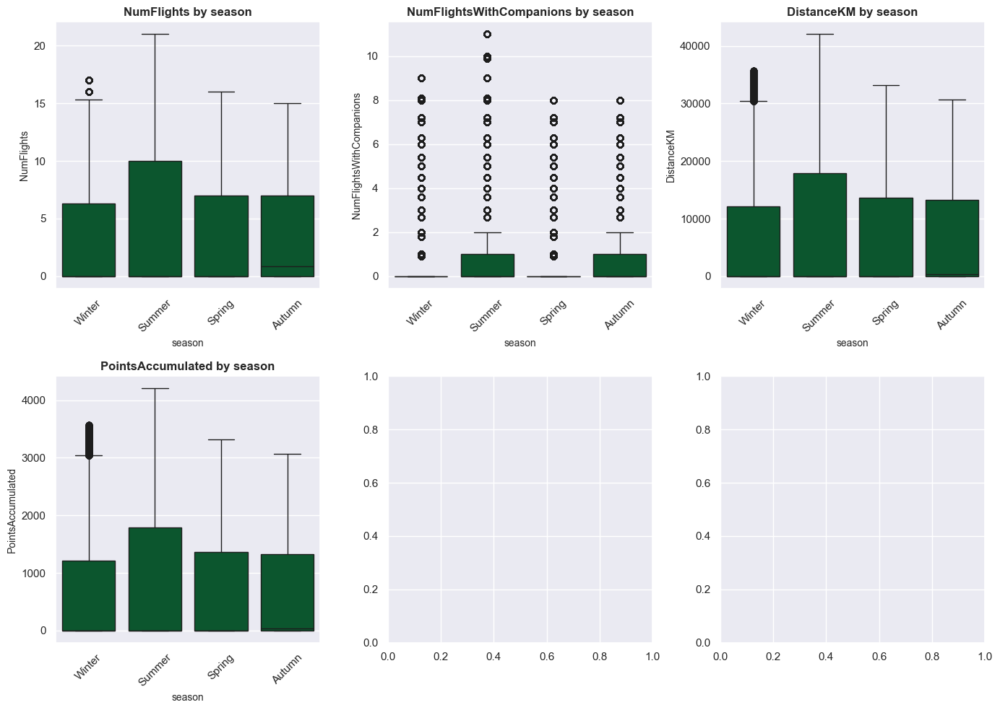

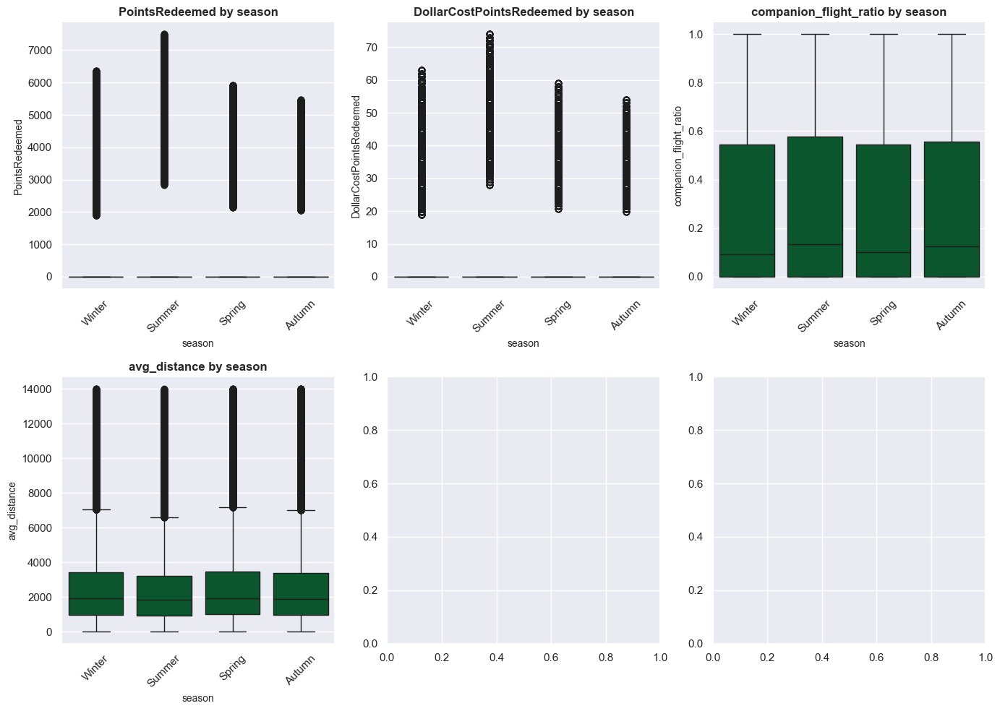

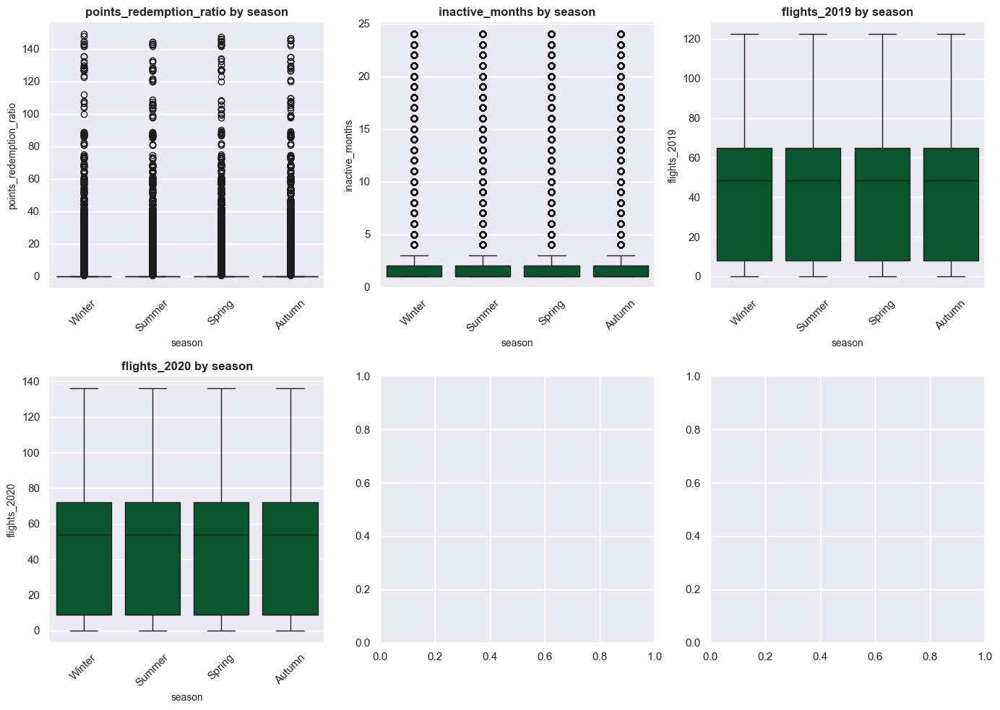

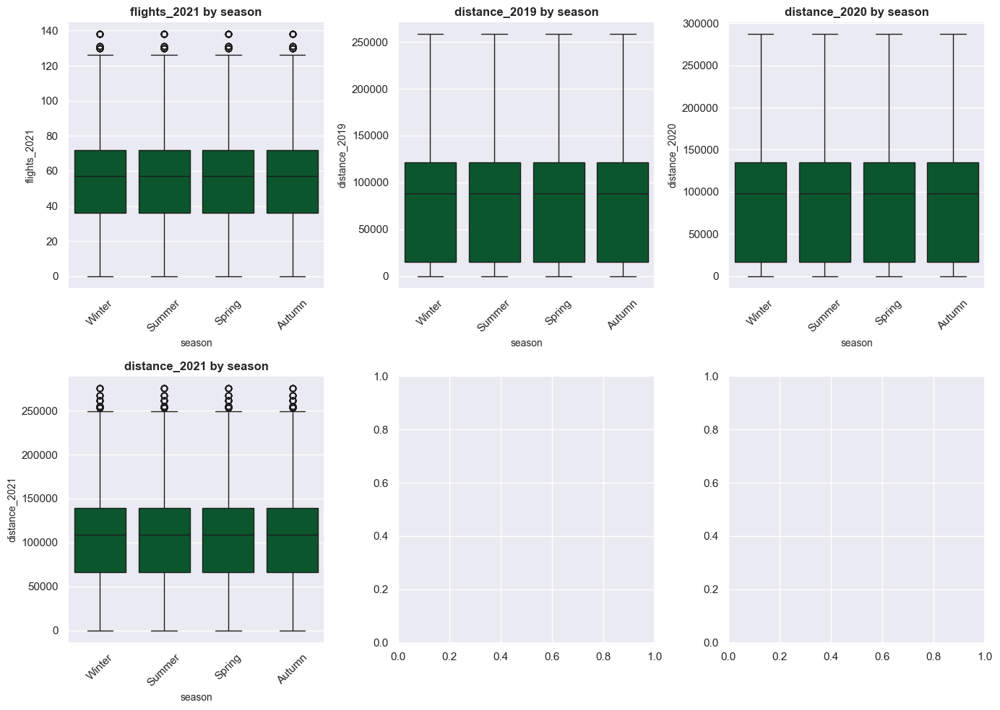

In [122]:
analyse_categorical_features(df_Flights, 'season', flights_num_cols)

for i in range(0, len(flights_num_cols), 4):
    cols_subset = flights_num_cols[i:i+4]
    plot_categorical_vs_numerical(df_Flights, 'season', cols_subset)

**Main Takeaways**
- Year: Number of flights, number of flights with companion, distance travelled, points redeemed, and dollar cost points redeemed appear to increase from 2019 to 2021 steadily, while the other features remain constant
- Month/ season: Number of flights, number of flights with companion, distance travelled, points accumulated, points redeemed and dollar cost points redeemed seem to have high seasonality, with peaks in march, june, july, august and dezember.
--- 

# 6. Multivariate Analysis

Only analyze data for people that have been active in the last 12 months.


In [124]:
df_customer_2021 = df_Customer[df_Customer['is_active_12m'] == True]

print(len(df_customer_2021))
print(len(df_Customer))

14527
16594


In [125]:
cust_num_cols = ['Income', 'Customer Lifetime Value', 'total_distance_2021', 'total_flights_2021', 'Monetary_Value_2021', 'DaysSinceLastFlight']
cust_cat_cols = ['Province or State', 'City', 'Postal code', 'Gender', 'Education', 'Location Code', 
                 'Marital Status', 'LoyaltyStatus', 'EnrollmentType', 'is_active_6m', 'is_active_12m', 'rejoined', 'is_current_loyalty_member', 
                 'is_previous_member', 'active_loyalty_label']

# Remove -> to many values
cust_cat_cols.remove('Province or State')
cust_cat_cols.remove('City')
cust_cat_cols.remove('Postal code')

## 6.1 Pairplots per categorical column

Define plotting function to display pairplots for different categorical variables.

In [126]:
def plot_pairplot_by_category(df, numeric_cols, category_col):
    sns.pairplot(df, vars=numeric_cols, hue=category_col, markers=['o', 's'])
    plt.show()

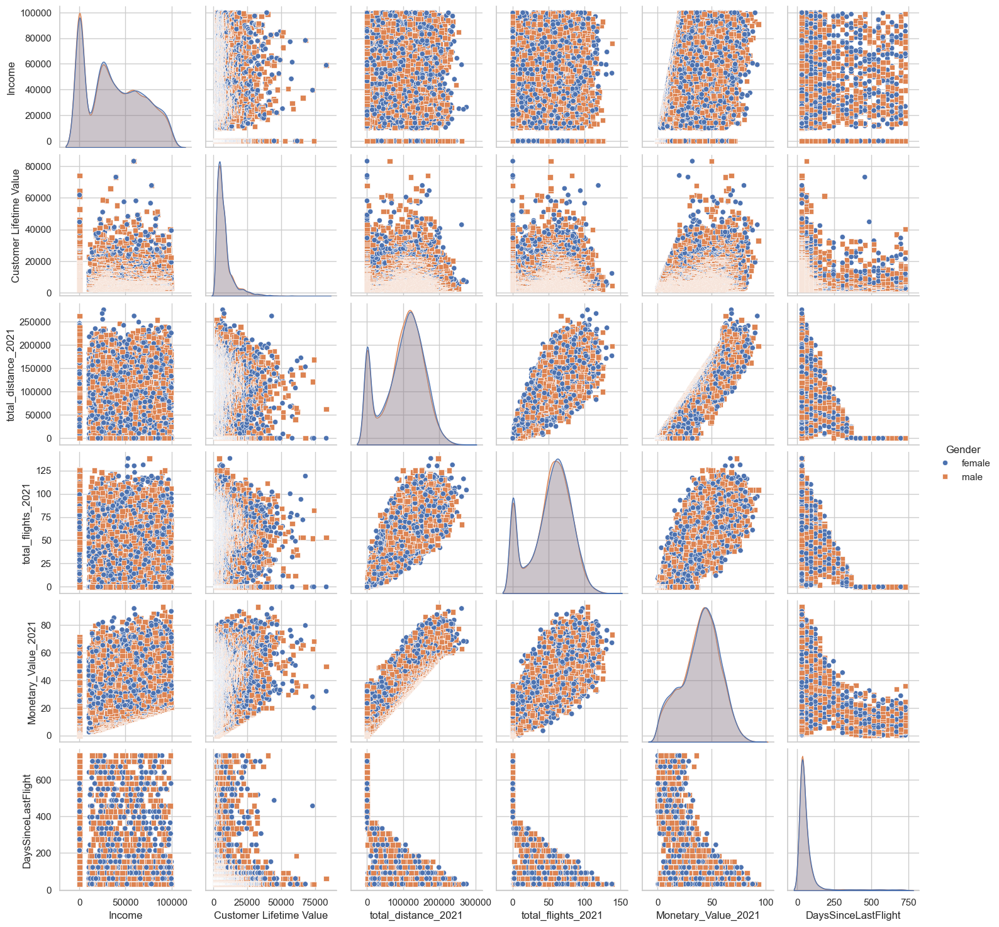

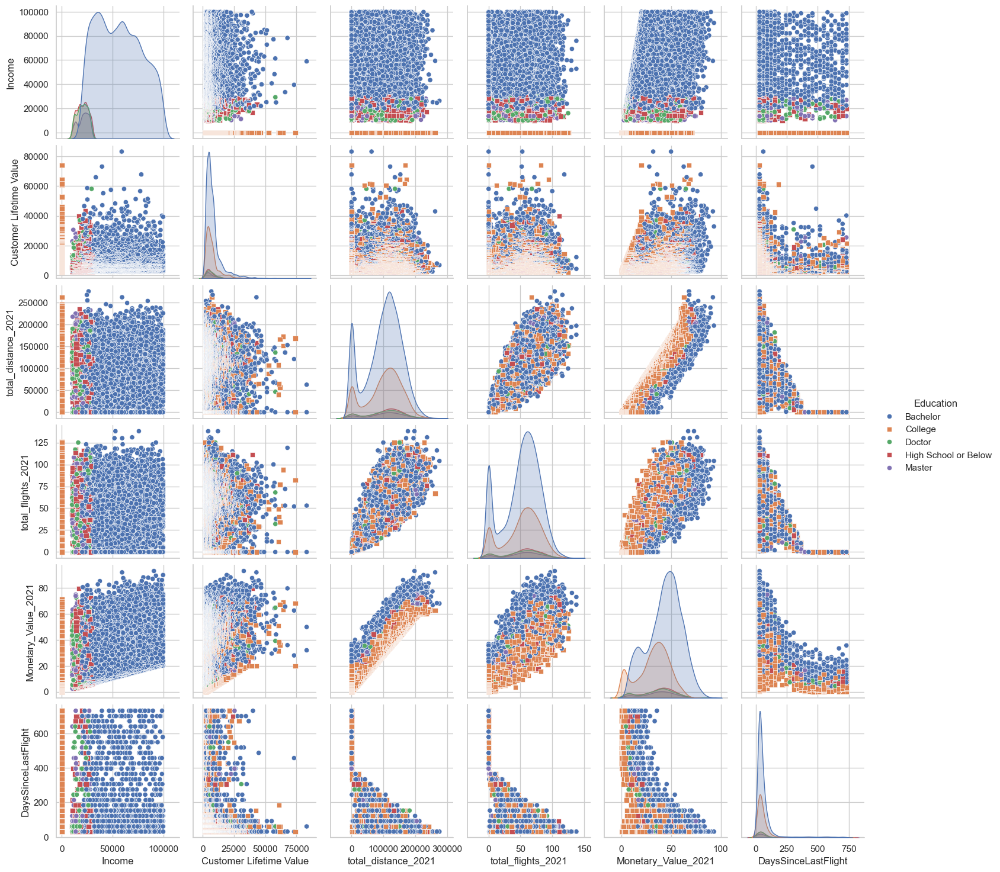

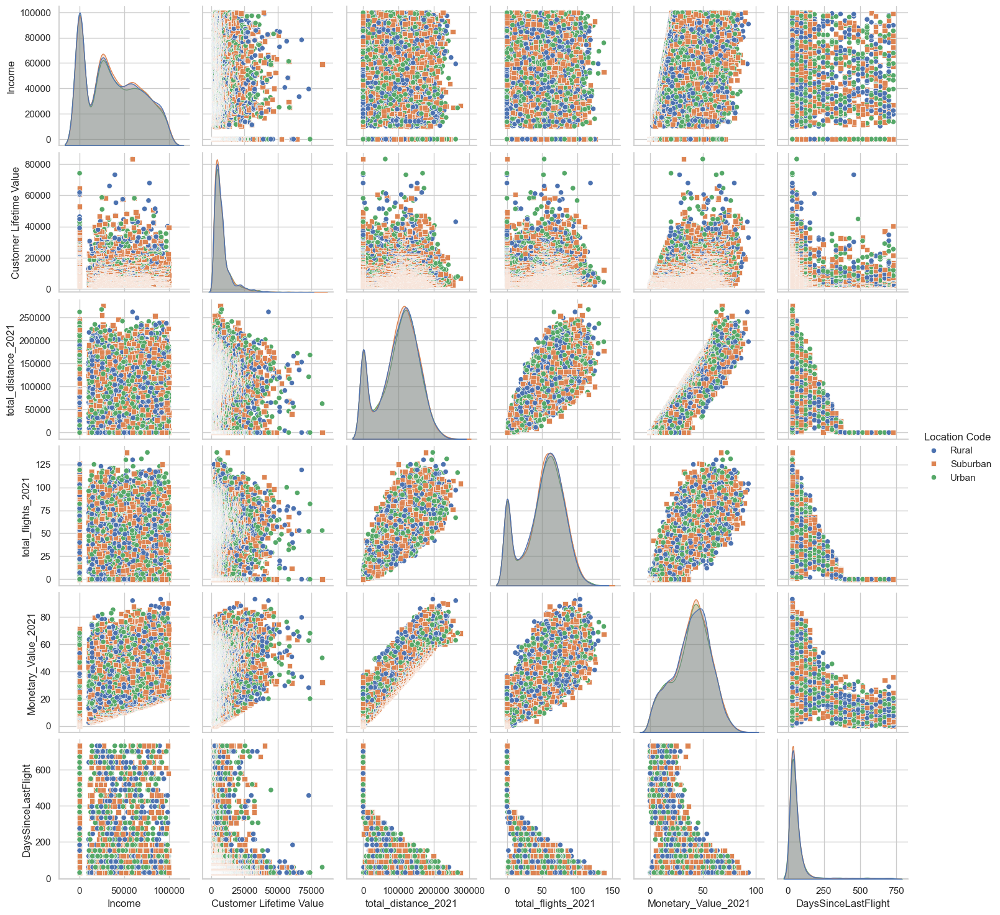

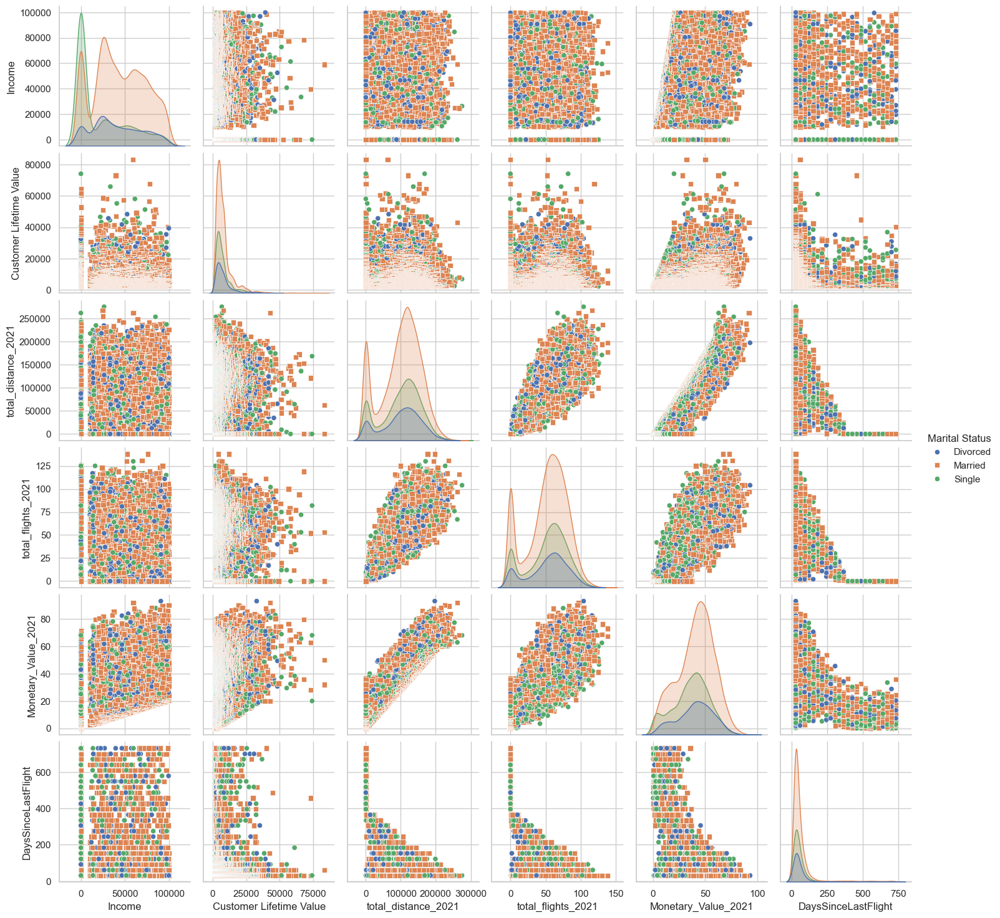

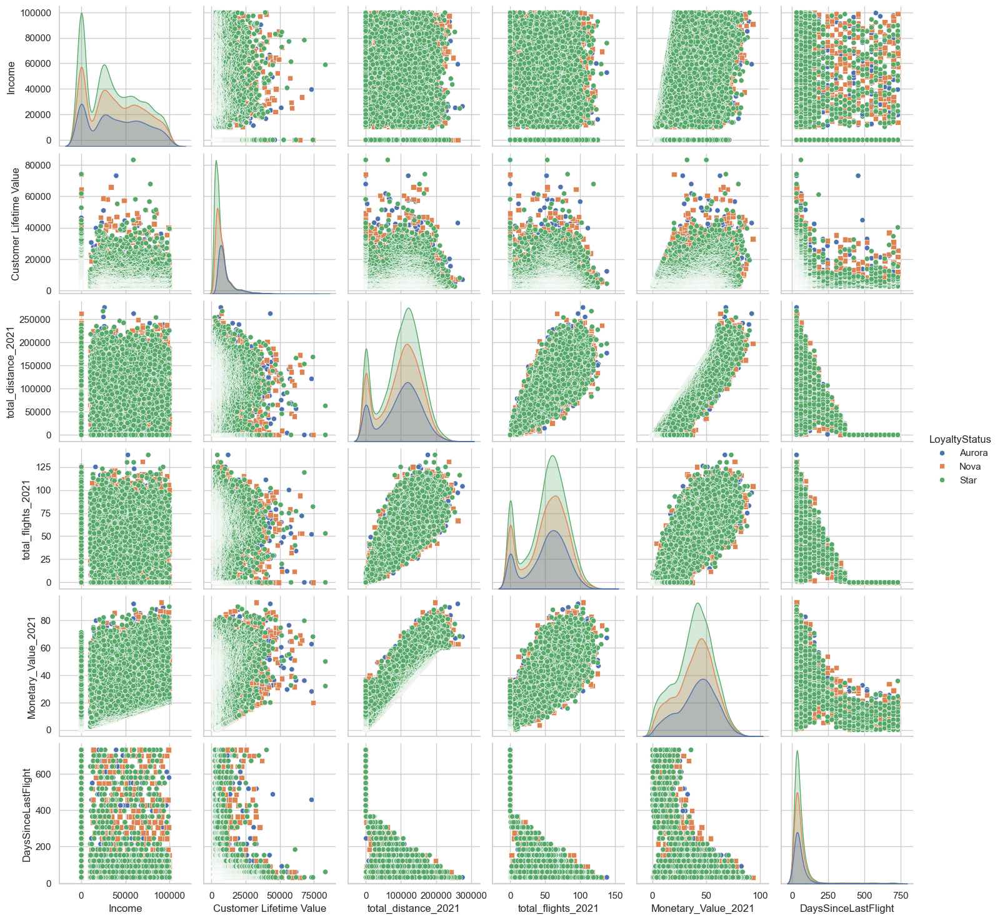

...

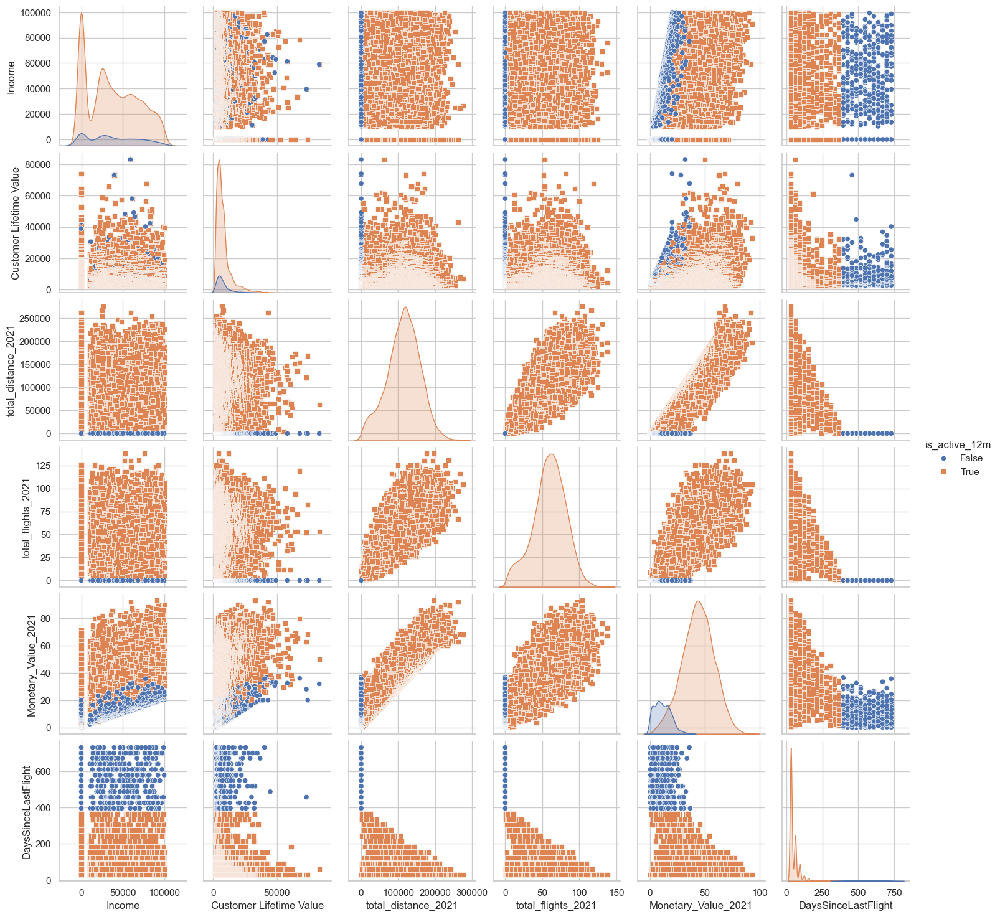

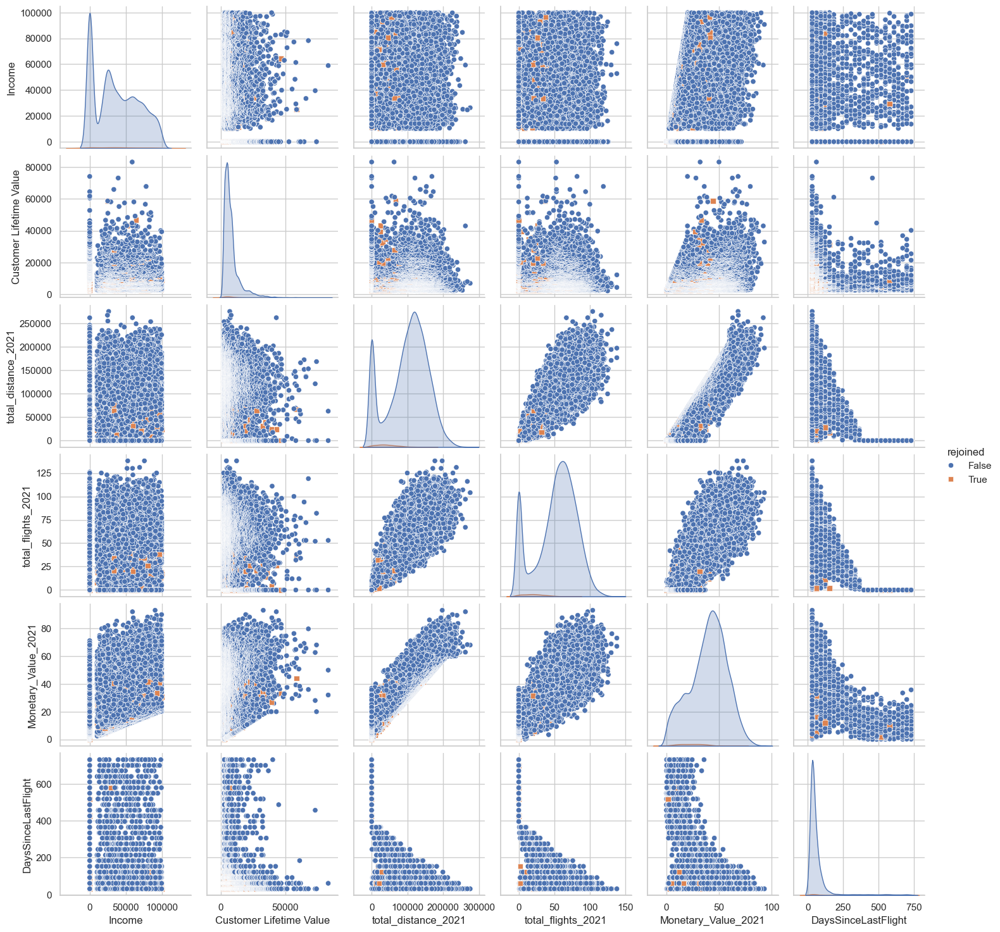

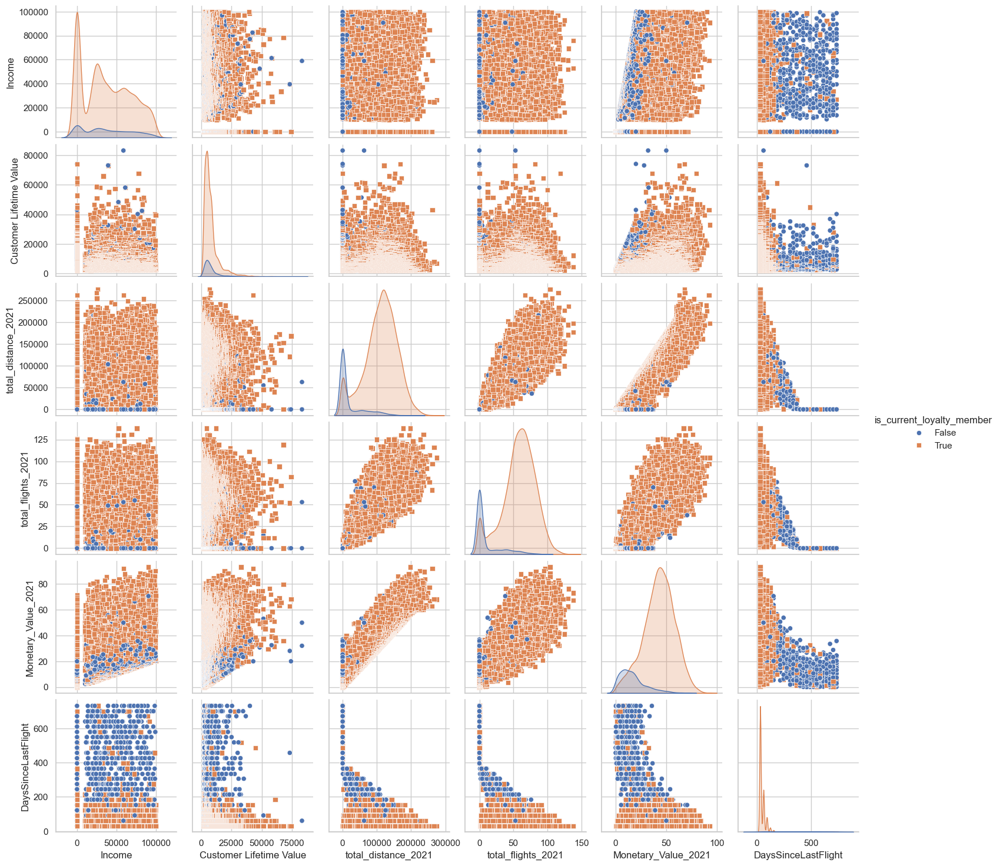

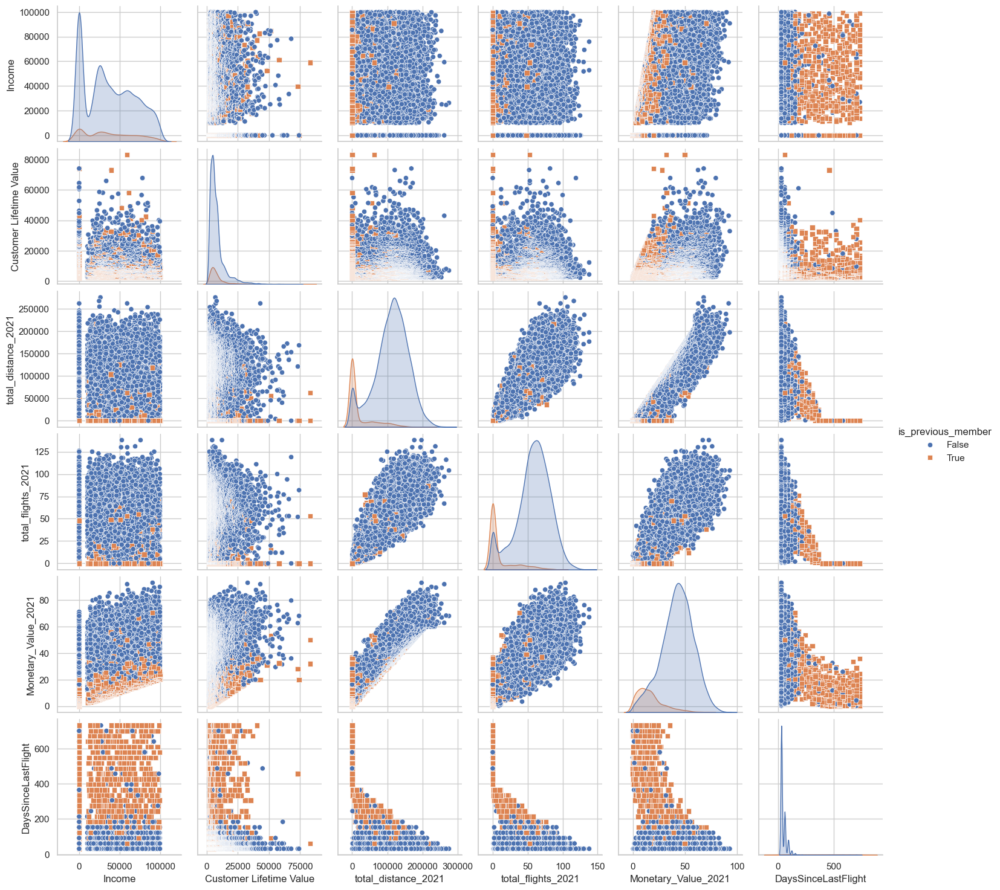

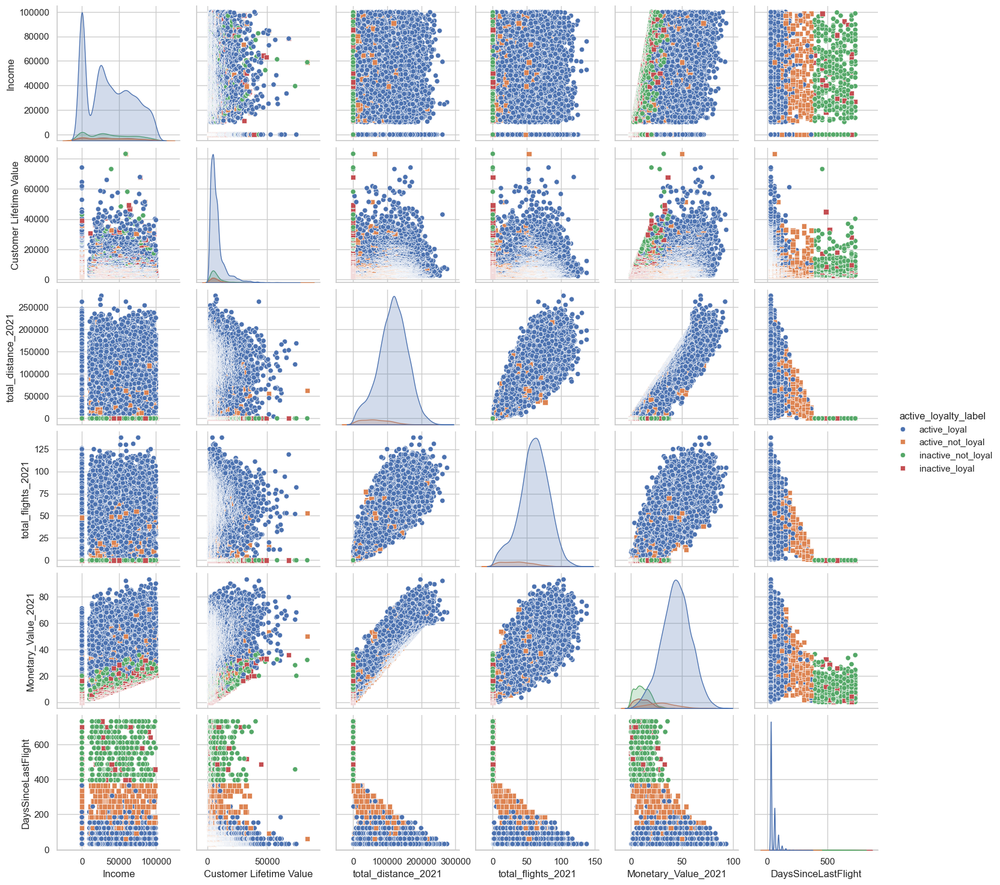

In [127]:
sns.set_theme(style="whitegrid")
for cat_col in cust_cat_cols:
    plot_pairplot_by_category(df_Customer, cust_num_cols, cat_col)

**Main Takeaways** 
- Education: Bachelor degree holders dominate the monetary features.
- Marital Status: Married people have slightly higher monetary features, but they also dominate the customer base. (more people are married than single or divorced)
- Loyalty Status: Star loyalty members are more common.

- General: The monetary features (Customer Lifetime Value, Monetary_Value_2021) have higher values when days since last flight is low.
---

## 6.2 Plot the RFM features against categorical features

In [128]:
cust_cat_cols = ['Province or State', 'City', 'Postal code', 'Gender', 'Education', 'Location Code', 
                 'Marital Status', 'LoyaltyStatus', 'EnrollmentType', 'rejoined', 'is_current_loyalty_member', 'is_previous_member', 'active_loyalty_label']

Define function to plot high-value segments with centered quadrant lines for each of the categorical features.

In [129]:
def plot_high_value_segments(df, monetary_value_col, freq_metric_col, cat_col, figsize=(20, 12)):
    """
    Visualize customer segments by their average frequency and monetary value.
    Highlights high-performing segments in the upper-right quadrant.
    """

    # Calculate average frequency and monetary value per category
    segment = (
        df.groupby(cat_col)
          .agg(
              avg_freq=(freq_metric_col, 'mean'),
              avg_value=(monetary_value_col, 'mean'),
              count=(freq_metric_col, 'size')
          )
          .reset_index()
    )

    # Overall averages
    avg_freq = segment['avg_freq'].mean()
    avg_value = segment['avg_value'].mean()

    fig, ax = plt.subplots(figsize=figsize)

    # Shaded upper-right quadrant
    ax.axvspan(avg_freq, segment['avg_freq'].max()*1.02, alpha=0.15, color='lightgreen', zorder=0)
    ax.axhspan(avg_value, segment['avg_value'].max()*1.02, alpha=0.15, color='lightgreen', zorder=0)

    # Scatter plot (disable size legend)
    sns.scatterplot(
        data=segment,
        x='avg_freq',
        y='avg_value',
        size='count',
        sizes=(300, 2500),
        color=CUSTOM_HEX[1],
        alpha=0.8,
        edgecolor='black',
        ax=ax
    )
    
    # Labels
    for _, row in segment.iterrows():
        label_text = f"{row[cat_col]} ({row['count']})"
        ax.annotate(
            label_text,
            (row['avg_freq'], row['avg_value']),
            xytext=(6, 6),
            textcoords='offset points',
            fontsize=11,
            bbox=dict(boxstyle='round,pad=0.3',
                      facecolor='white',
                      edgecolor='none',
                      alpha=0.8)
        )

    # Reference lines
    ax.axvline(avg_freq, color='gray', linestyle='--', linewidth=1.5,
               label=f'Avg {freq_metric_col}: {avg_freq:.1f}')
    ax.axhline(avg_value, color='gray', linestyle='--', linewidth=1.5,
               label=f'Avg {monetary_value_col}: {avg_value:.1f}')

    # Format
    ax.set_xlabel(freq_metric_col, fontsize=16, fontweight='bold')
    ax.set_ylabel(monetary_value_col, fontsize=16, fontweight='bold')
    ax.set_title(
        f'High-Value Growth Segments for feature: "{cat_col}"\n'
        'Shaded area: above-average value and frequency',
        fontsize=18,
        fontweight='bold',
        pad=18
    )
    ax.legend_.remove()
    ax.grid(True, alpha=0.3, linestyle=':')
    ax.set_axisbelow(True)
    ax.tick_params(axis='both', which='major', labelsize=12, length=0.5)

    plt.tight_layout()
    plt.show()

Apply the function for each categorical feature. Only analyze data for people that have been active in the last 12 months.

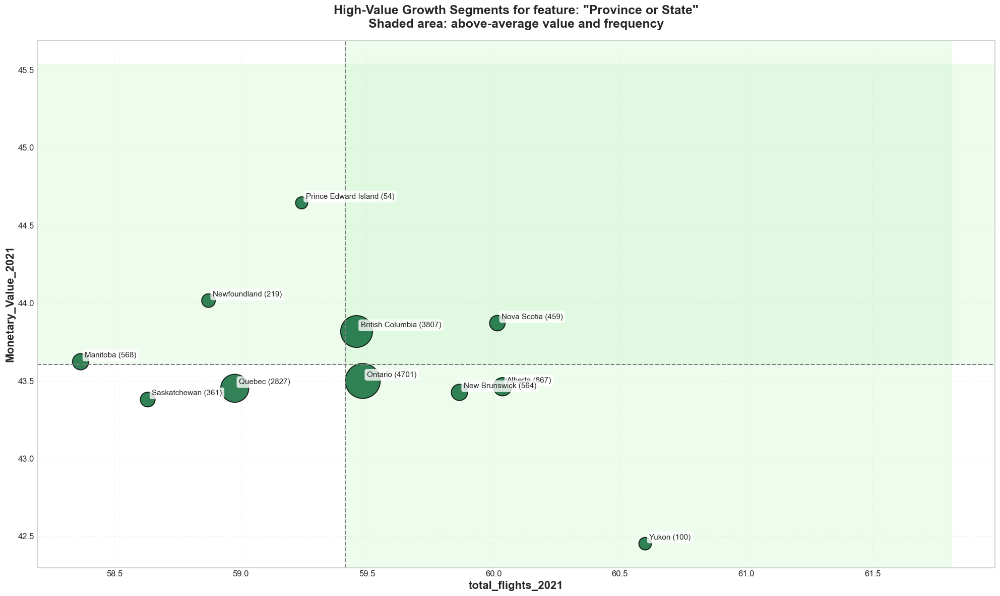

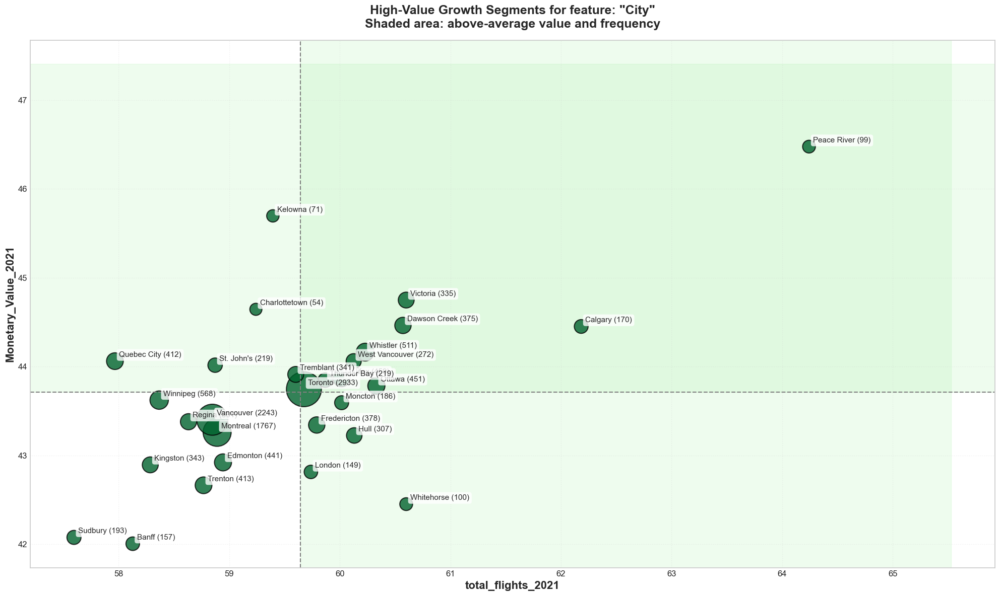

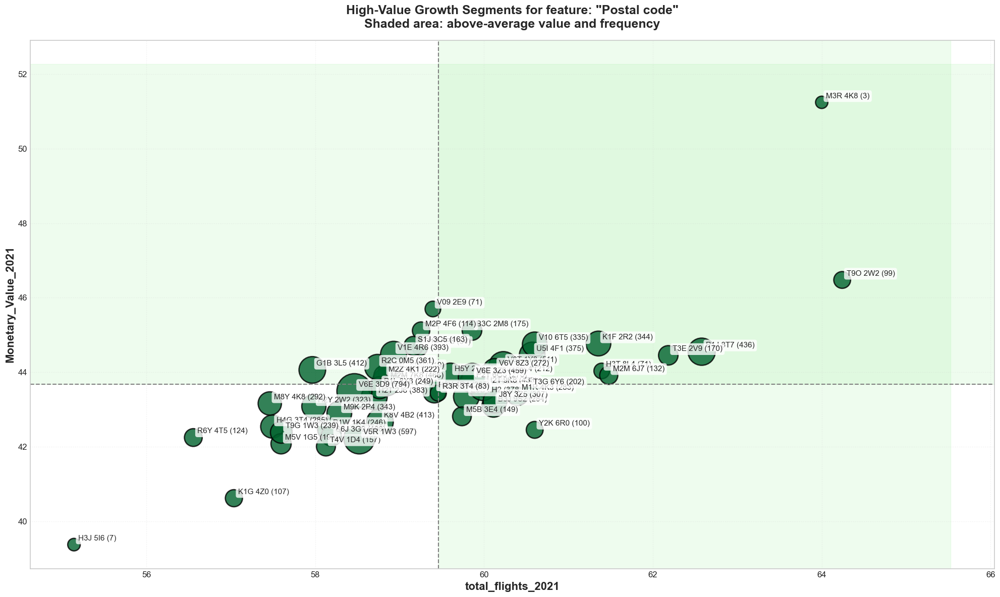

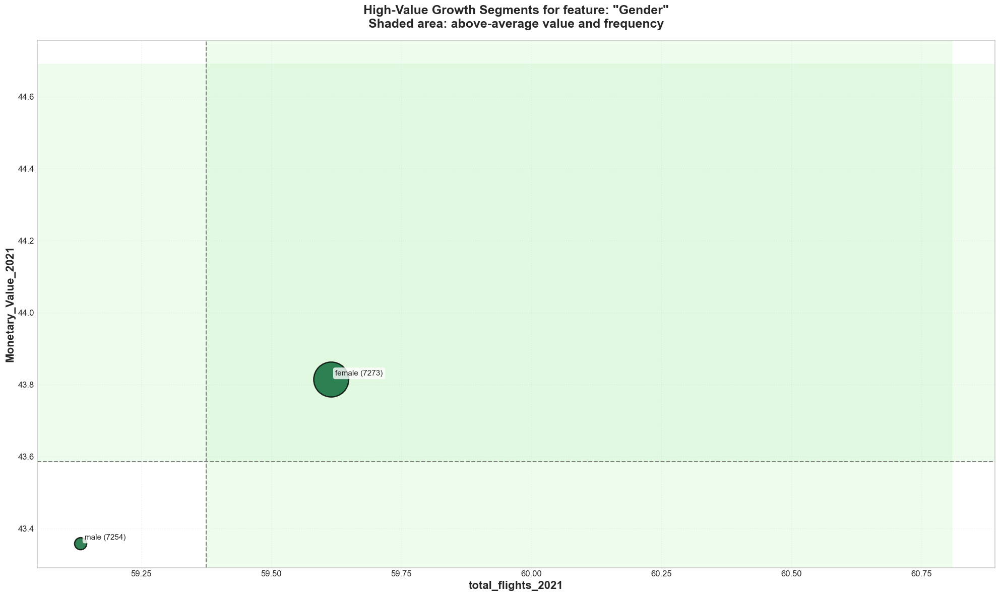

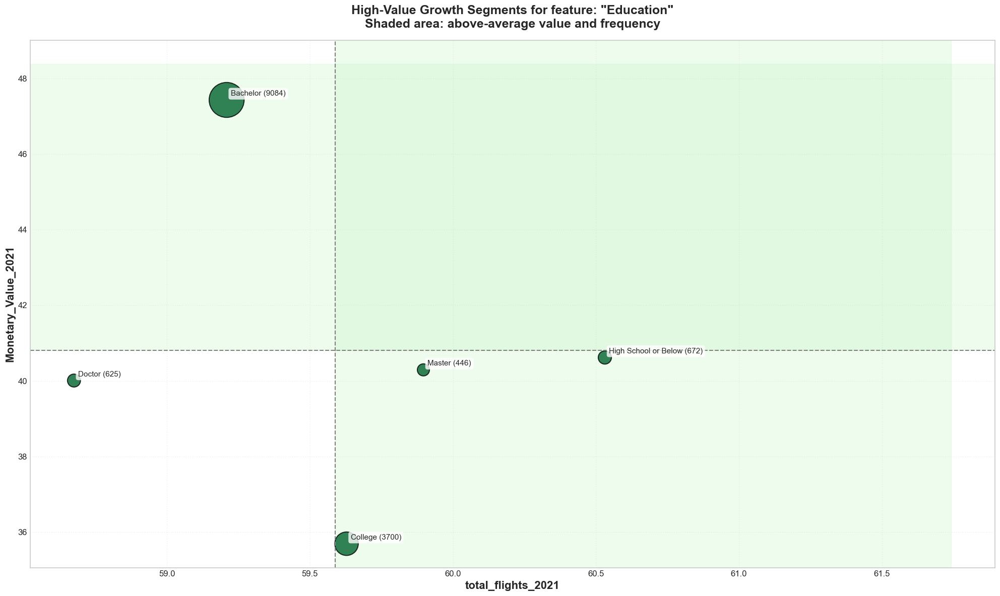

...

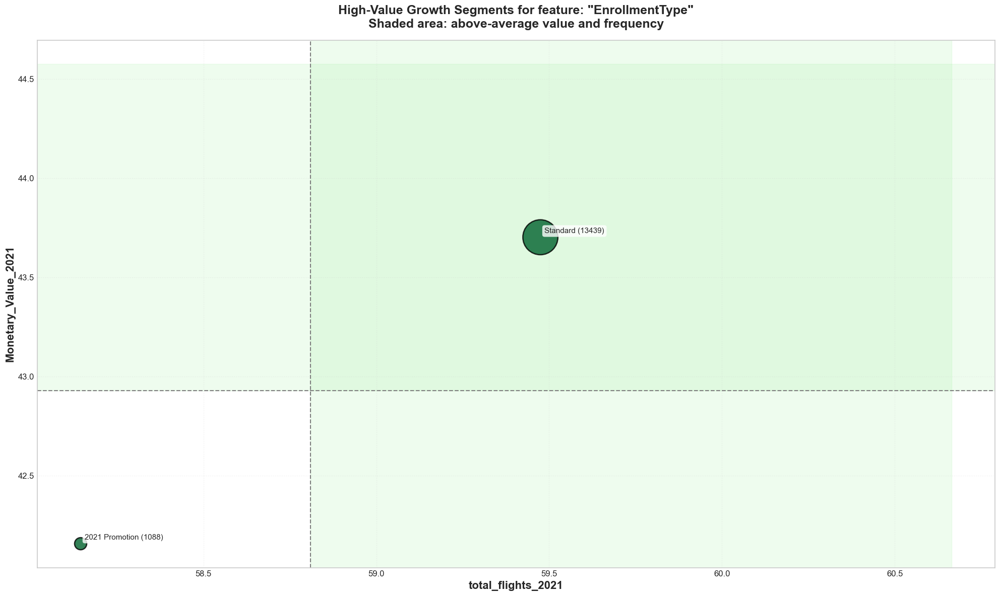

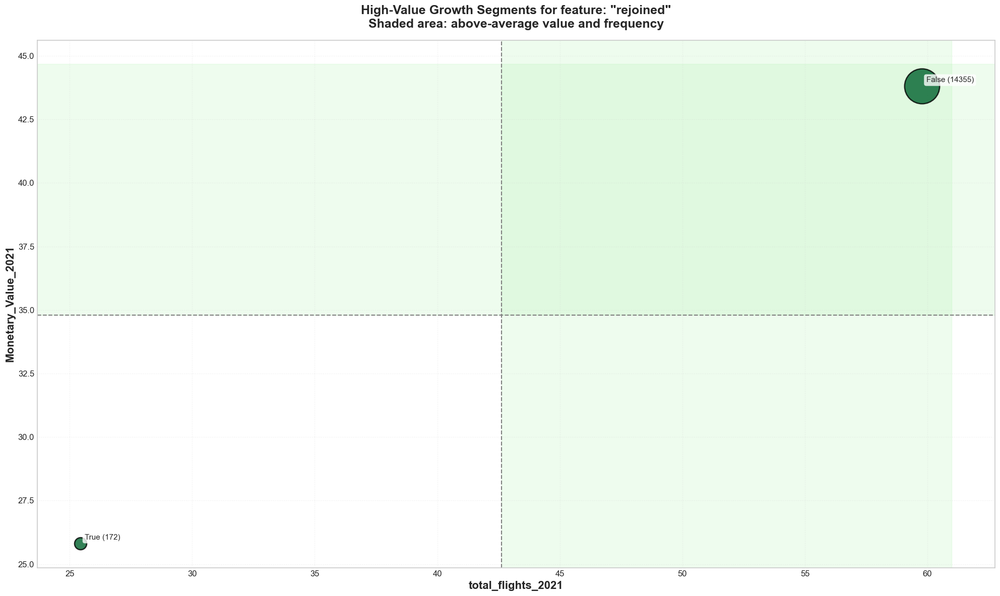

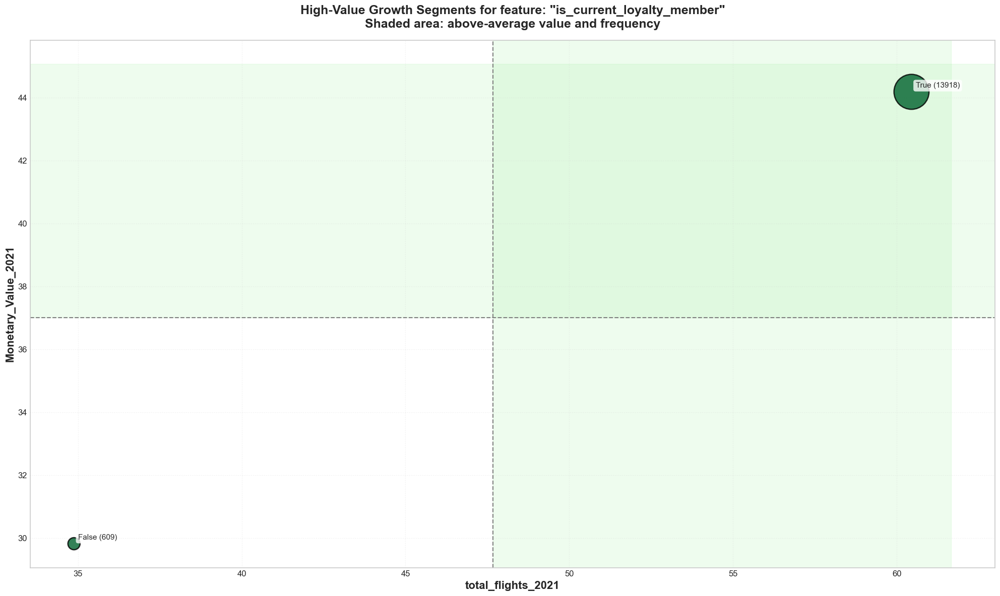

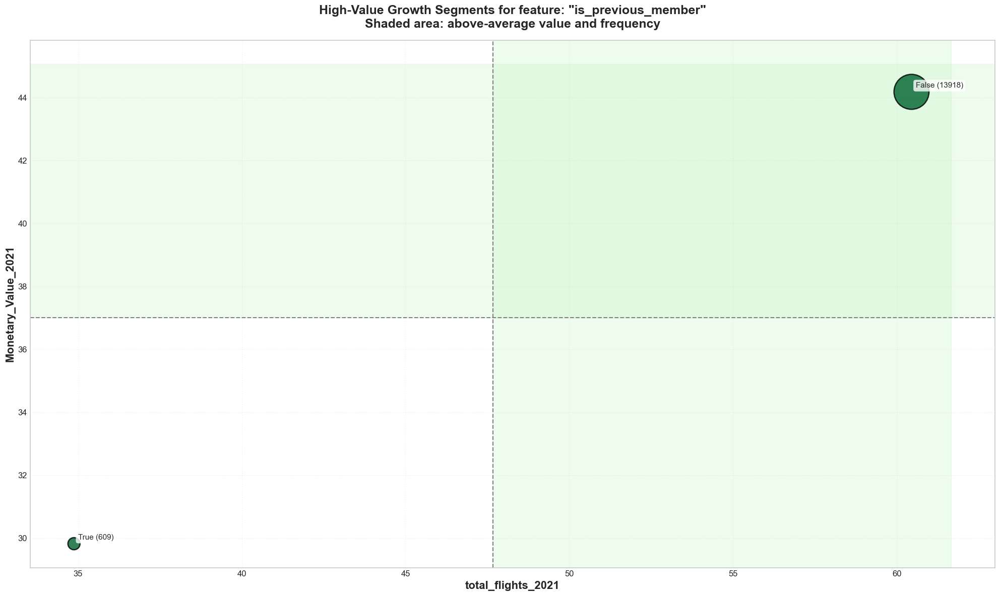

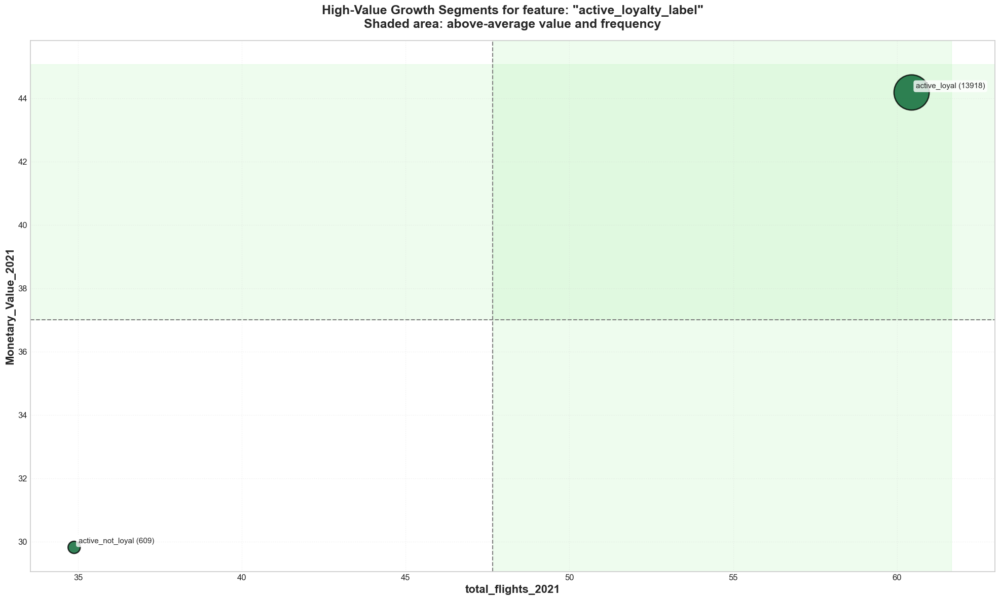

In [130]:
for cat_col in cust_cat_cols:
    plot_high_value_segments(
        df_customer_2021,
        monetary_value_col='Monetary_Value_2021',
        freq_metric_col='total_flights_2021',
        cat_col=cat_col
    )

**Main Takeaways**
- Main differences are visible in Loyalty Status, Postal Code, Education, Marital Status, is_current_loyalty_member.  
---

Plot for report.

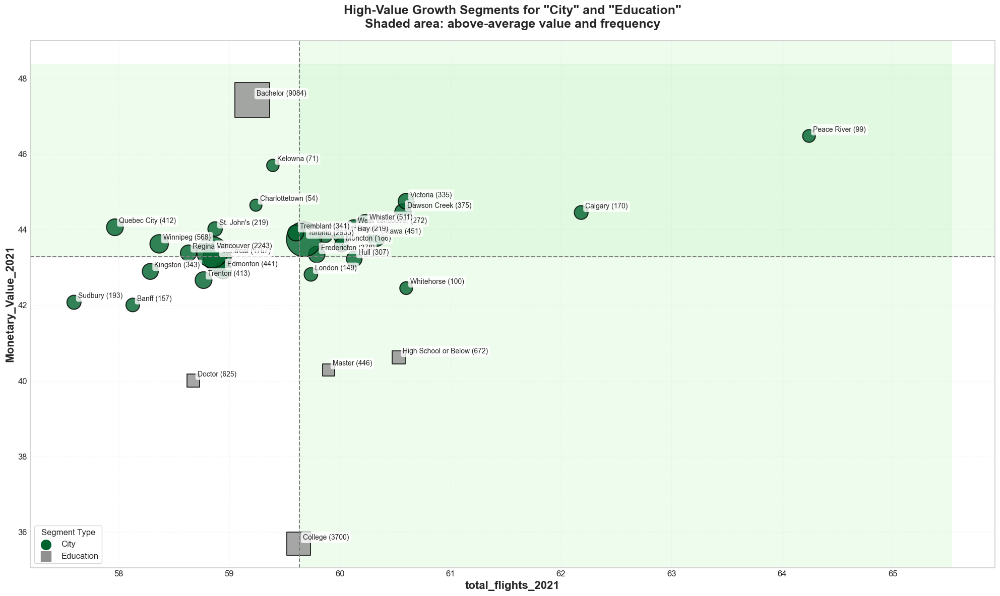

In [132]:
def plot_high_value_segments_two_cats(df, monetary_value_col, freq_metric_col, cat_col1, cat_col2, figsize=(20, 12)):
    """
    Visualize two categorical segment types together:
    cat_col1 → circles ('o')
    cat_col2 → triangles ('^')
    """

    # Aggregate per category
    seg1 = (
        df.groupby(cat_col1)
          .agg(
              avg_freq=(freq_metric_col, 'mean'),
              avg_value=(monetary_value_col, 'mean'),
              count=(freq_metric_col, 'size')
          )
          .reset_index()
          .assign(segment_type=cat_col1)
    )

    seg2 = (
        df.groupby(cat_col2)
          .agg(
              avg_freq=(freq_metric_col, 'mean'),
              avg_value=(monetary_value_col, 'mean'),
              count=(freq_metric_col, 'size')
          )
          .reset_index()
          .assign(segment_type=cat_col2)
    )

    combined = pd.concat([
        seg1.rename(columns={cat_col1: 'segment_name'}),
        seg2.rename(columns={cat_col2: 'segment_name'})
    ])

    avg_freq = combined['avg_freq'].mean()
    avg_value = combined['avg_value'].mean()

    fig, ax = plt.subplots(figsize=figsize)

    # Shaded quadrant
    ax.axvspan(avg_freq, combined['avg_freq'].max() * 1.02, alpha=0.15, color='lightgreen', zorder=0)
    ax.axhspan(avg_value, combined['avg_value'].max() * 1.02, alpha=0.15, color='lightgreen', zorder=0)

    # Plot cat_col1 (dots)
    data1 = combined[combined['segment_type'] == cat_col1]
    sns.scatterplot(
        data=data1,
        x='avg_freq',
        y='avg_value',
        size='count',
        sizes=(300, 2500),
        color=CUSTOM_HEX[1],
        alpha=0.8,
        edgecolor='black',
        marker='o',
        legend=False,
        ax=ax
    )

    # Plot cat_col2 (triangles)
    data2 = combined[combined['segment_type'] == cat_col2]
    sns.scatterplot(
        data=data2,
        x='avg_freq',
        y='avg_value',
        size='count',
        sizes=(300, 2500),
        color=CUSTOM_HEX[9],
        alpha=0.8,
        edgecolor='black',
        marker='s',
        legend=False,
        ax=ax
    )

    # Labels
    for _, row in combined.iterrows():
        ax.annotate(
            f"{row['segment_name']} ({row['count']})",
            (row['avg_freq'], row['avg_value']),
            xytext=(6, 6),
            textcoords='offset points',
            fontsize=10,
            bbox=dict(boxstyle='round,pad=0.3', facecolor='white', edgecolor='none', alpha=0.8)
        )

    # Reference lines
    ax.axvline(avg_freq, color='gray', linestyle='--', linewidth=1.5)
    ax.axhline(avg_value, color='gray', linestyle='--', linewidth=1.5)

    # Labels, legend, formatting
    ax.set_xlabel(freq_metric_col, fontsize=16, fontweight='bold')
    ax.set_ylabel(monetary_value_col, fontsize=16, fontweight='bold')
    ax.set_title(
        f'High-Value Growth Segments for "{cat_col1}" and "{cat_col2}"\n'
        'Shaded area: above-average value and frequency',
        fontsize=18,
        fontweight='bold',
        pad=18
    )

    # Manual legend
    ax.scatter([], [], color=CUSTOM_HEX[1], marker='o', s=200, label=cat_col1)
    ax.scatter([], [], color=CUSTOM_HEX[9], marker='s', s=200, label=cat_col2)
    ax.legend(title='Segment Type', fontsize=12, frameon=True, fancybox=True)

    ax.grid(True, alpha=0.3, linestyle=':')
    ax.set_axisbelow(True)
    ax.tick_params(axis='both', which='major', labelsize=12, length=0.5)

    plt.tight_layout()
    plt.show()


plot_high_value_segments_two_cats(
    df_customer_2021,
    monetary_value_col='Monetary_Value_2021',
    freq_metric_col='total_flights_2021',
    cat_col1='City',
    cat_col2='Education'
)